In [2]:
import pickle
import numpy as np
import sys
import matplotlib.pyplot as plt
import pandas as pd
from tqdm import tqdm
from scipy.signal import find_peaks, find_peaks_cwt
modelling_hpc = '/Volumes/mo2016/home/Documents/modelling'
modelling_ephemeral = '/Volumes/mo2016/ephemeral/Documents/modelling'
modulepath = '/Users/mo2016/Documents/modelling/6eq/modules'
import sys
sys.path.append(modulepath)

while True:
    try:
        from numerical_solvers_variableboundary import *
        break
    except ImportError:
        modelling_hpc = '/rds/general/user/mo2016/home/Documents/modelling'
        modulepath = modelling_hpc + '/3954/modules'
        sys.path.append(modulepath)

from numerical_solvers_variableboundary import *
from numerical_solvers_variableboundary import *

circuit_n=2
variant=0
parametersets_n = 10000

# open parameter dictionaries
general_df = pickle.load(open(modelling_hpc + '/3954/parameter_space_search/results/output_dataframes/lsa_df_circuit%r_variant%r_%rparametersets.pkl'%(circuit_n,variant,parametersets_n), "rb"))


In [16]:
def minmax_scaler(data, top = 255):
    scaled_data = (data - np.amin(data)) / (np.amax(data) - np.amin(data))
    return scaled_data*top

def plot_peaks(simulation,parID,print_stripped=True):
    print(parID)
    red = simulation[-2]
    red = np.concatenate([np.zeros(1), red, np.zeros(1)])

    green = simulation[-1]
    green = np.concatenate([np.zeros(1), green, np.zeros(1)])

#     minred,maxred = (np.min(red[np.nonzero(red)]),np.max(red[np.nonzero(red)]))
#     mingreen,maxgreen = (np.min(green[np.nonzero(green)]),np.max(green[np.nonzero(green)]))


#     print (minred,maxred,mingreen,maxgreen)
#     var_red,var_green = [(np.amax(red) - np.amin(red)), (np.amax(green) - np.amin(green))]
#     if var_red >0.5:
#         red = minmax_scaler(red)
        
#     if var_green > 0.5:
#         green = minmax_scaler(green)
        


    
    
#     if any(i>1 for i in [var_red,var_green]):
#         red *= 255.0 / red.max()
#         green *= 255.0 / green.max()
#         print(str(parID) + 'normalised' + str(var_red) + ',' + str(var_green))

#     else:
#         print(str(parID) + 'non_normalised' + str(var_red) + ',' + str(var_green))
    #findpeaks parametes


#     height = 1
#     threshold = 0
#     prominence = 0.1
    
    
    height = 1
    threshold = 0.1
    prominence = 0.1

    
    red_peaks, properties = find_peaks(red, height = height,threshold = threshold,prominence = prominence*np.amax(red))
    green_peaks, properties = find_peaks(green, height= height, threshold = threshold,prominence = prominence*np.amax(green))


    
#     if print_stripped == True:
    if np.amax([len(red_peaks),len(green_peaks)])>2:
        print('peaked')
        ax1=plt.subplot(1, 2, 1)
        ax1.plot(red[1:-1],c='r')
        ax1.plot(red_peaks, red[red_peaks], "x")

        ax2=plt.subplot(1, 2, 2)
        ax2.plot(green[1:-1],c='g')
        ax2.plot(green_peaks, green[green_peaks], "x")
            


        plt.show()
    
#     elif print_stripped == True:
    if np.amax([len(red_peaks),len(green_peaks)])<=2:
        ax1=plt.subplot(1, 2, 1)
        ax1.plot(red[1:-1],c='r')
        ax1.plot(red_peaks, red[red_peaks], "x")

        ax2=plt.subplot(1, 2, 2)
        ax2.plot(green[1:-1],c='g')
        ax2.plot(green_peaks, green[green_peaks], "x")



        plt.show()

    return (len(red_peaks),len(green_peaks))



In [17]:
def define_column(row,stripped_parID):
    parID = row.name[0]
    if parID in stripped_parID:
        return True
    else:
        return False
    

# Growth + Open boundary

In [18]:
boundary_coef=1
shape='growing_colony'
mechanism = 'general'
# parID=1
L,T,J,N = [8,100,64,12600]


In [19]:
nonstripped_parID = pickle.load( open( "%s_boundary%r_nonstripped_parID_%r.pkl"%(shape,boundary_coef,parametersets_n), "rb" ) ) 
stripped_parID  = pickle.load( open( "%s_boundary%r_stripped_parID_%r.pkl"%(shape,boundary_coef,parametersets_n), "rb" ) ) 


general_df['growth_1'] = general_df.apply (lambda row: define_column(row,stripped_parID), axis=1)


26
peaked


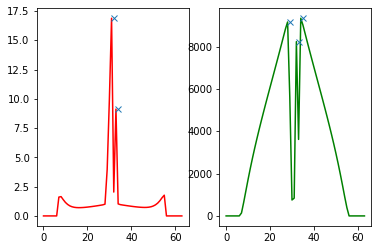

27
peaked


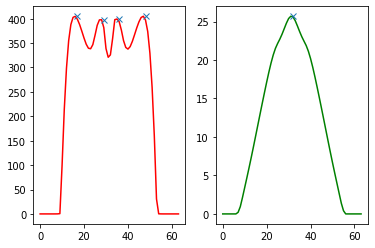

127
peaked


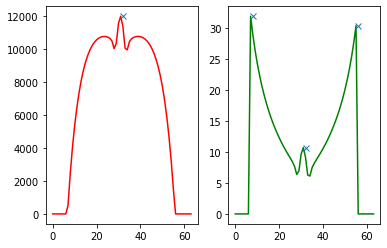

167
peaked


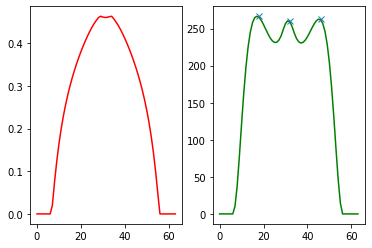

189
peaked


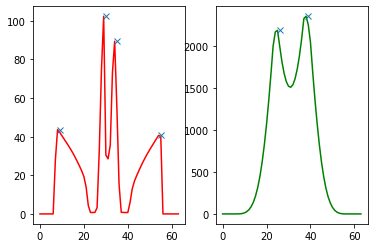

217
peaked


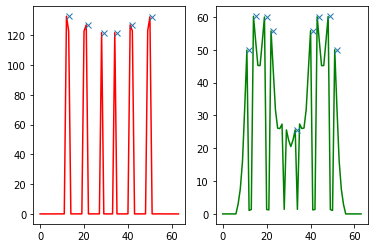

331
peaked


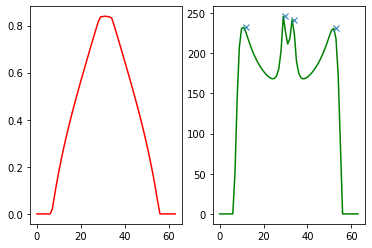

417
peaked


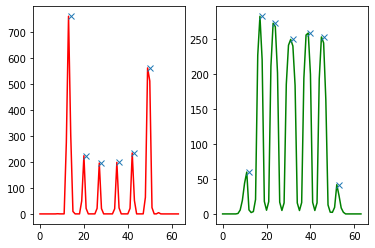

453
peaked


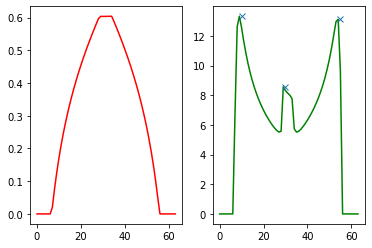

484
peaked


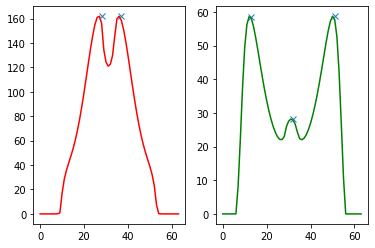

563
peaked


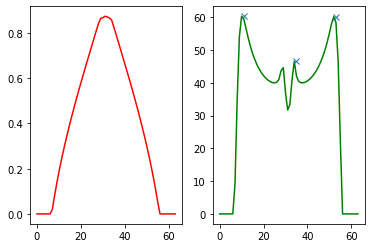

593
peaked


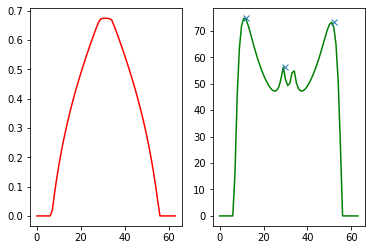

601
peaked


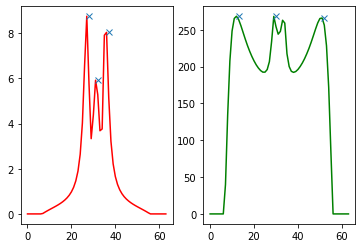

643
peaked


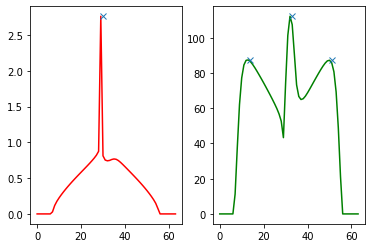

698
peaked


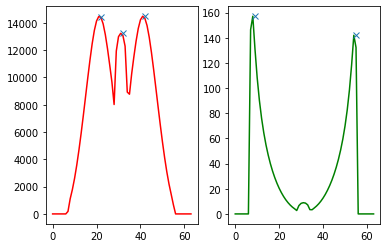

724
peaked


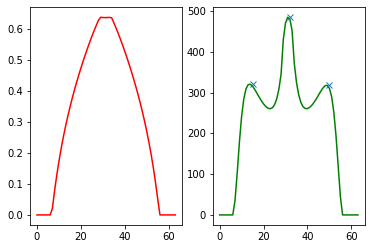

747
peaked


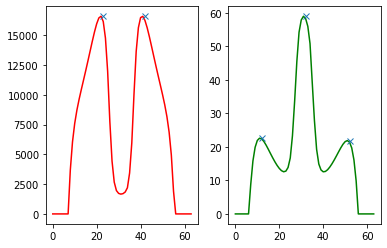

757
peaked


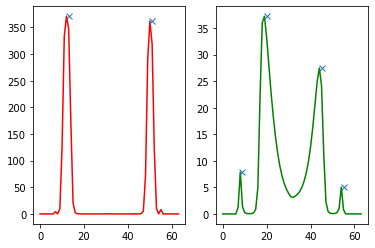

783
peaked


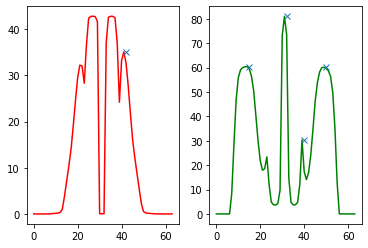

788
peaked


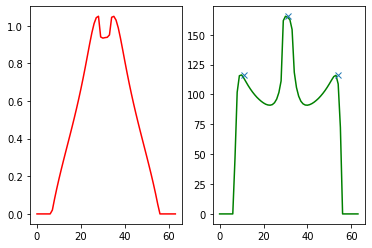

799
peaked


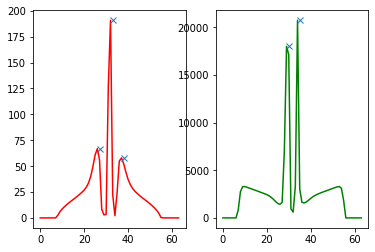

1006
peaked


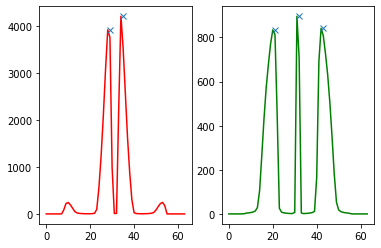

1021
peaked


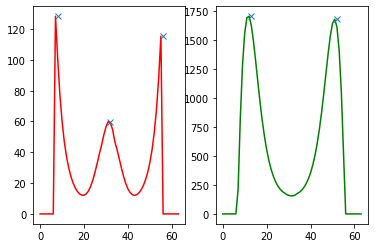

1028
peaked


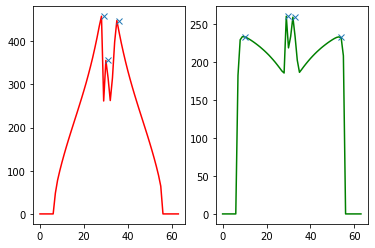

1035
peaked


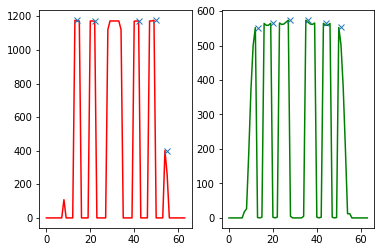

1071
peaked


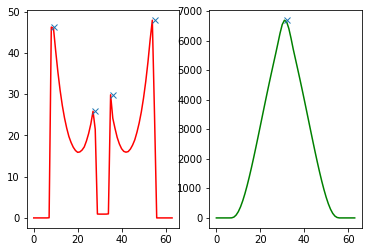

1131
peaked


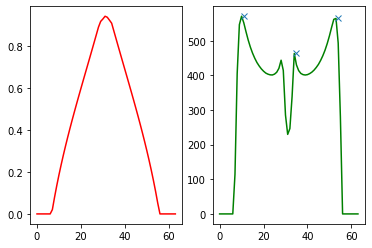

1169
peaked


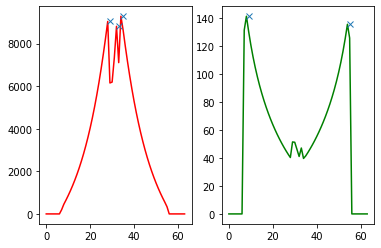

1177
peaked


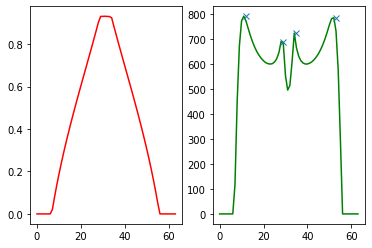

1231
peaked


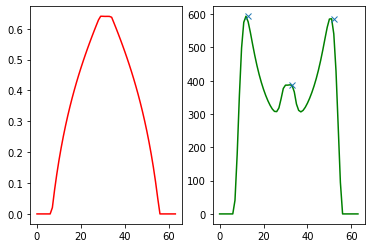

1312
peaked


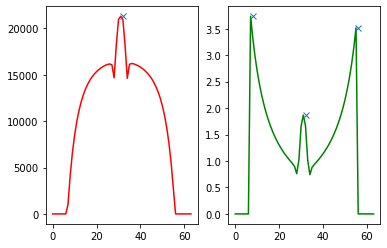

1401
peaked


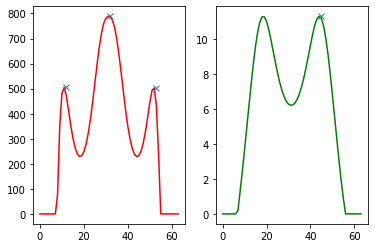

1414
peaked


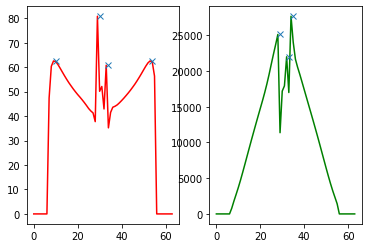

1417
peaked


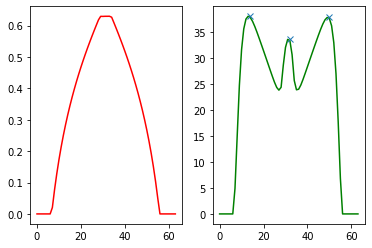

1459
peaked


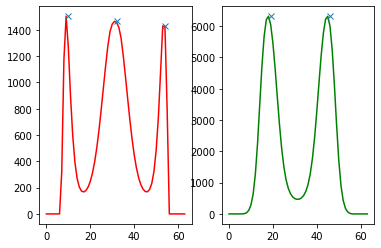

1478
peaked


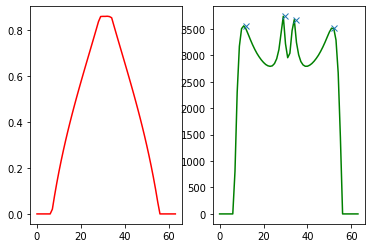

1610
peaked


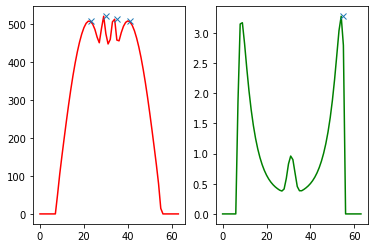

1623
peaked


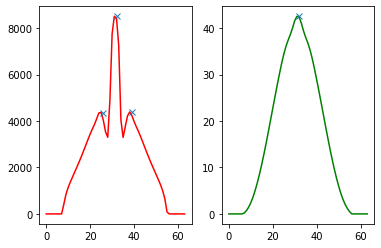

1705
peaked


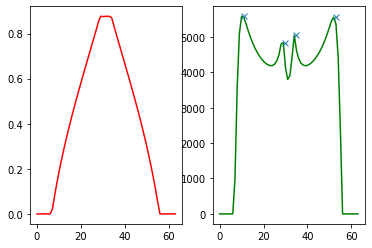

1748
peaked


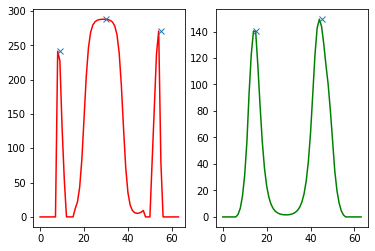

1754
peaked


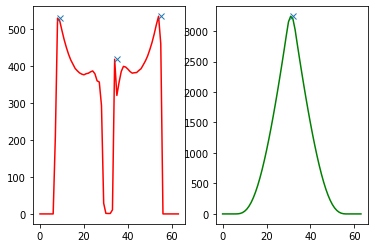

1781
peaked


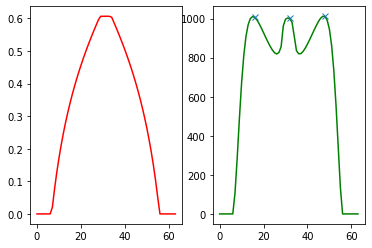

1872
peaked


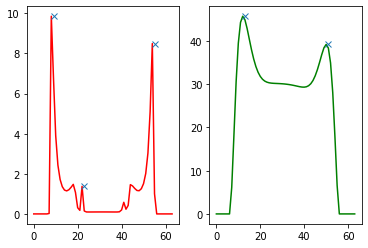

1893
peaked


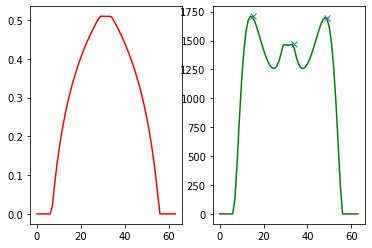

1926
peaked


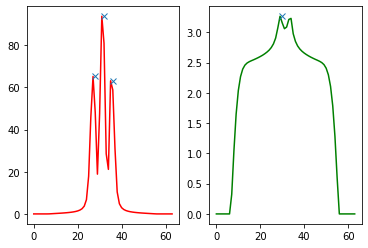

1955
peaked


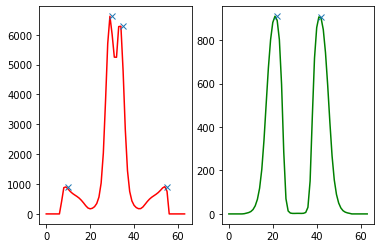

1990
peaked


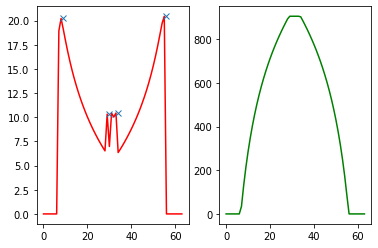

2017
peaked


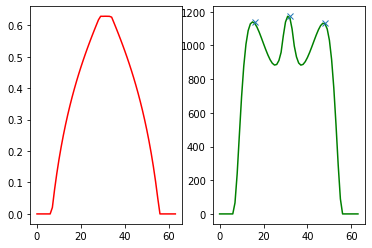

2053
peaked


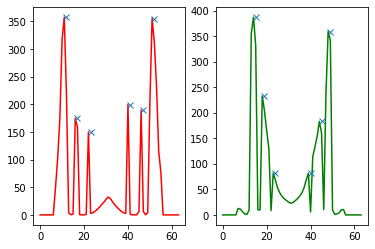

2081
peaked


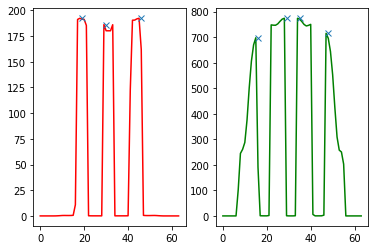

2156
peaked


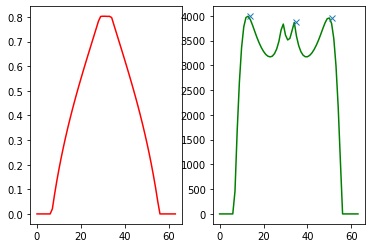

2223
peaked


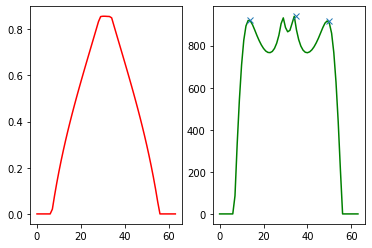

2326
peaked


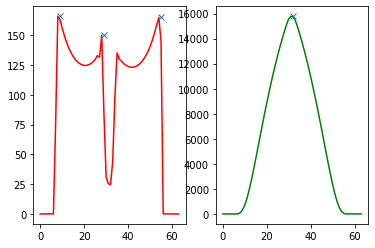

2365
peaked


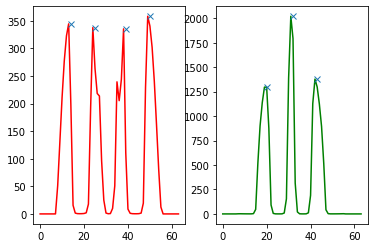

2415
peaked


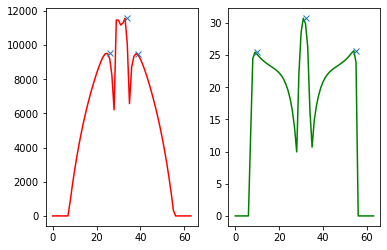

2428
peaked


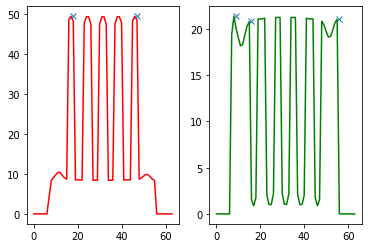

2463
peaked


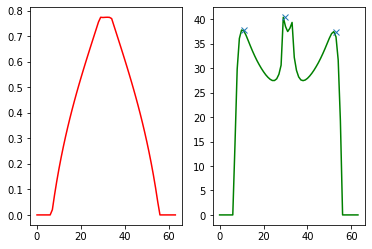

2522
peaked


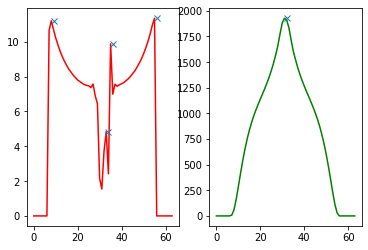

2567
peaked


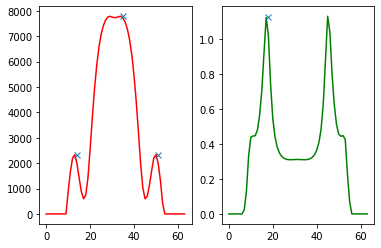

2607
peaked


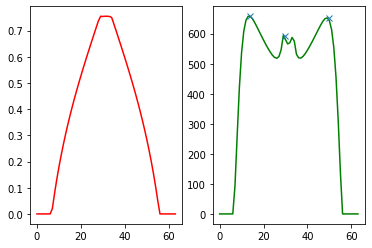

2749
peaked


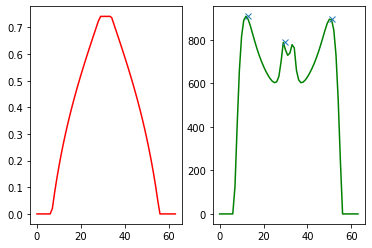

2791
peaked


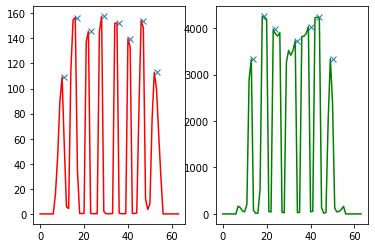

2799
peaked


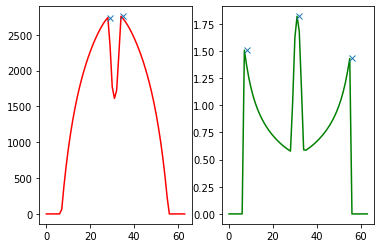

2817
peaked


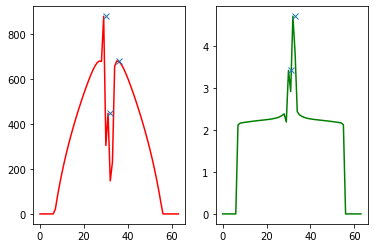

2852
peaked


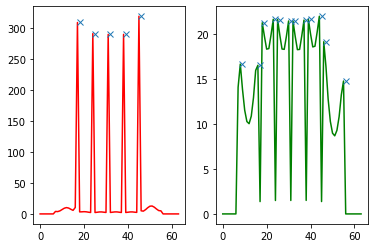

2970
peaked


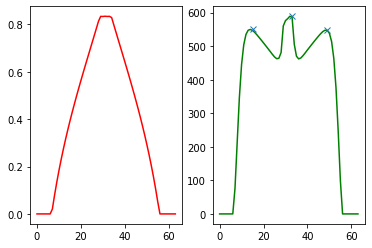

3023
peaked


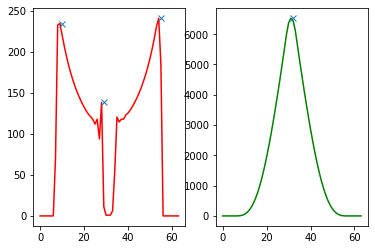

3037
peaked


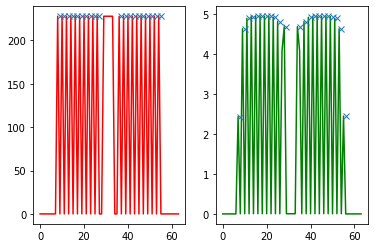

3064
peaked


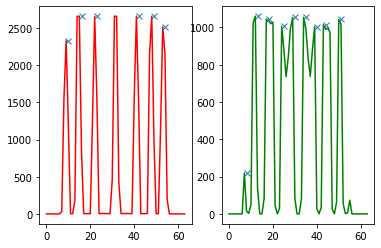

3117
peaked


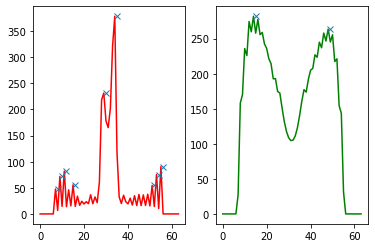

3163
peaked


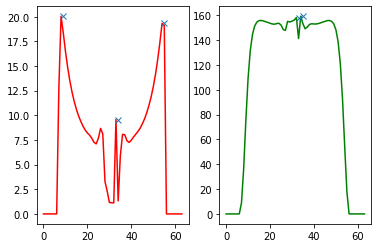

3168
peaked


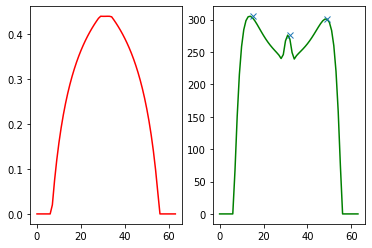

3180
peaked


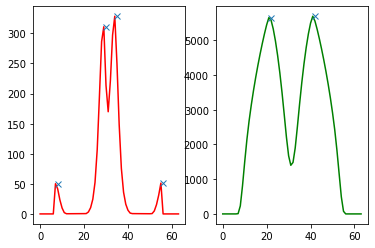

3191
peaked


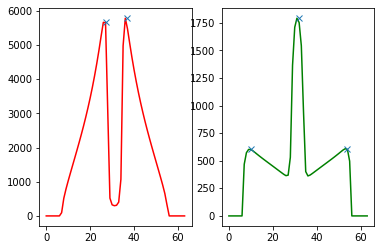

3255
peaked


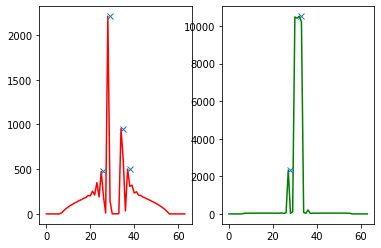

3296
peaked


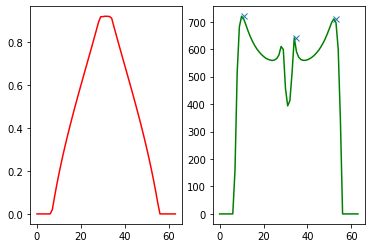

3312
peaked


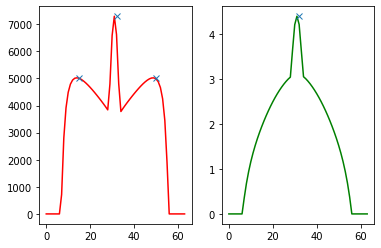

3408
peaked


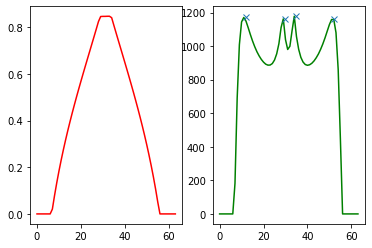

3551
peaked


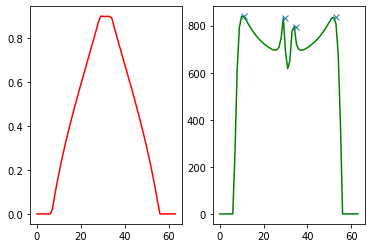

3656
peaked


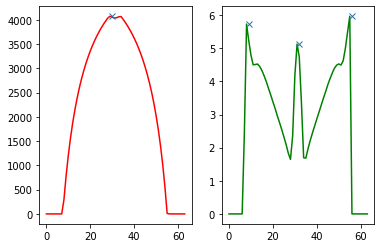

3726
peaked


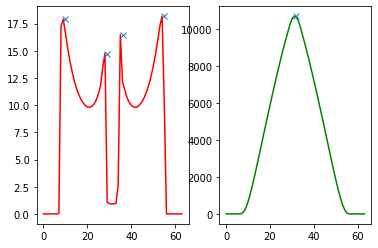

3766
peaked


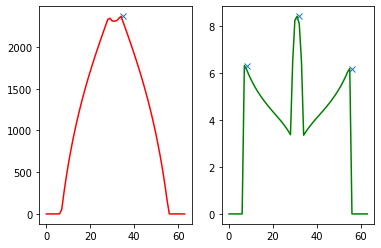

3816
peaked


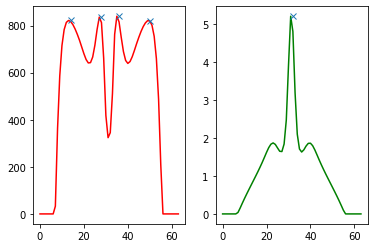

3926
peaked


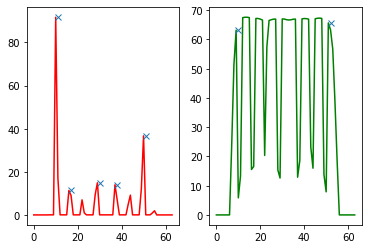

3988
peaked


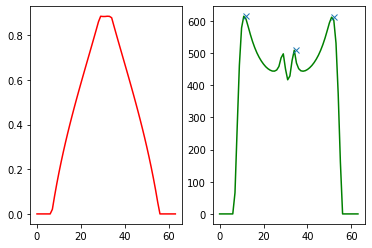

4055
peaked


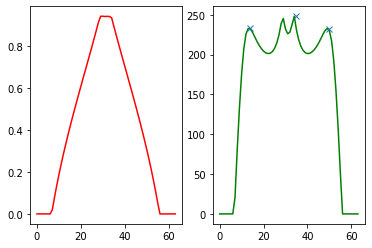

4164
peaked


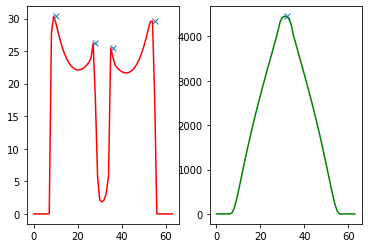

4205
peaked


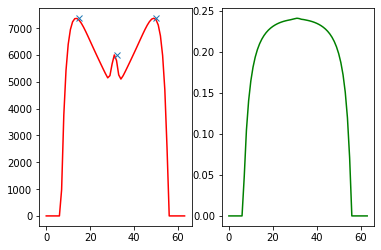

4257
peaked


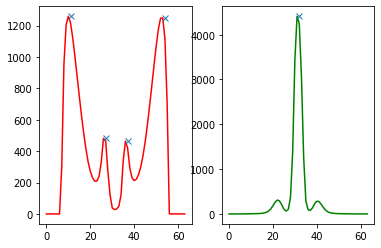

4374
peaked


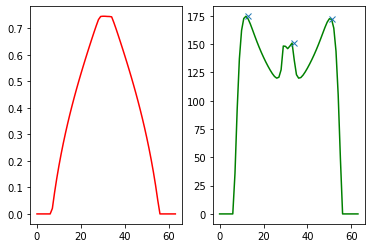

4378
peaked


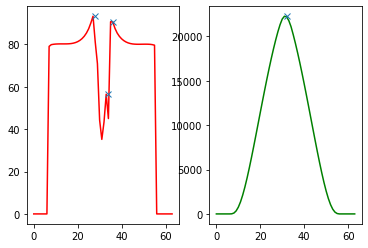

4451
peaked


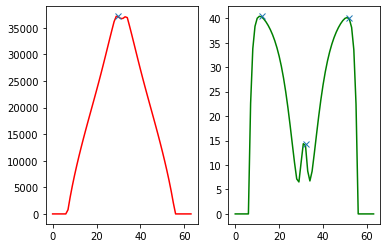

4465
peaked


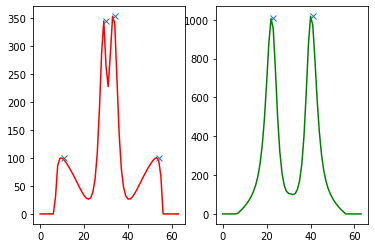

4564
peaked


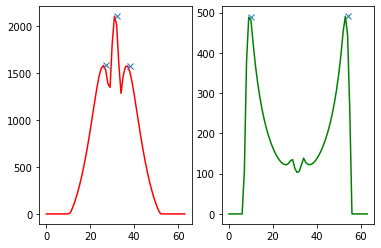

4567
peaked


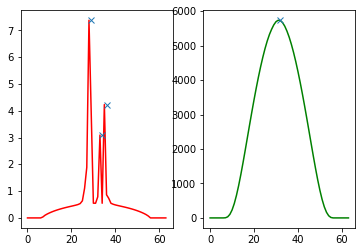

4584
peaked


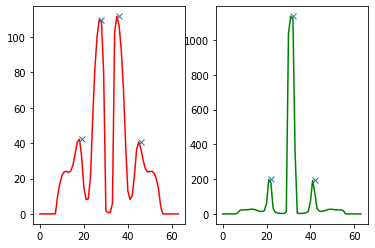

4608
peaked


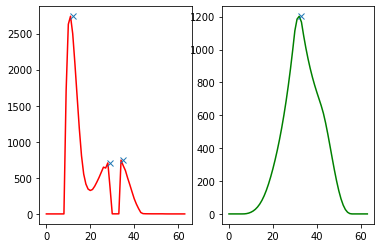

4619
peaked


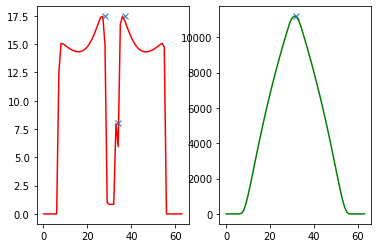

4666
peaked


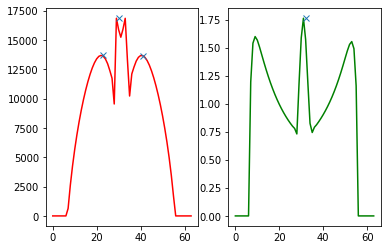

4732
peaked


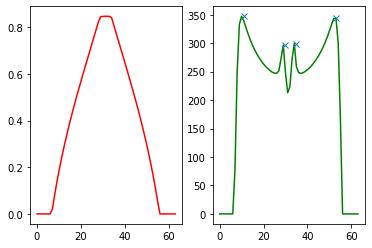

4781
peaked


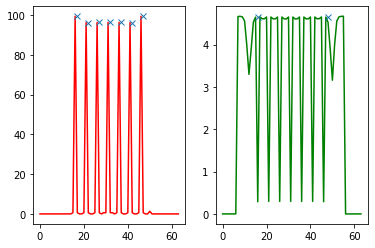

4980
peaked


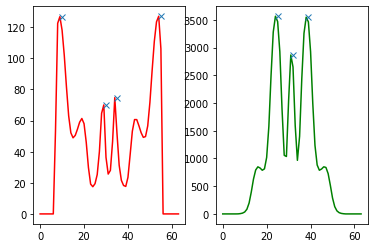

5009
peaked


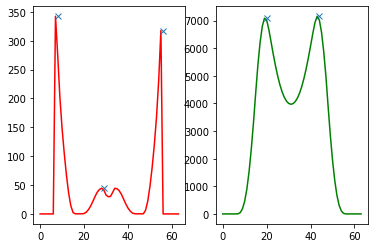

5018
peaked


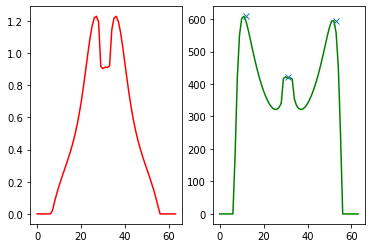

5058
peaked


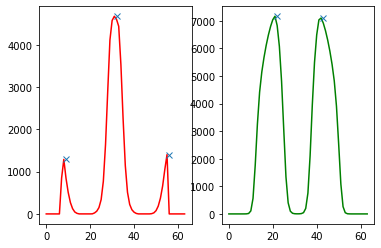

5139
peaked


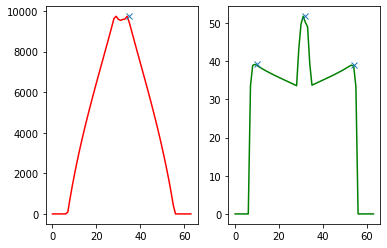

5211
peaked


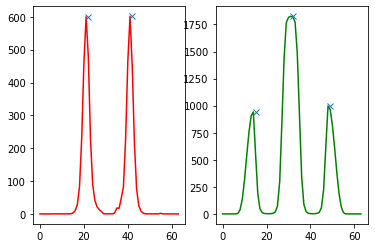

5311
peaked


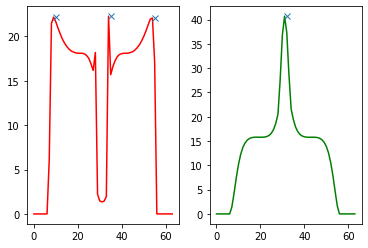

5397
peaked


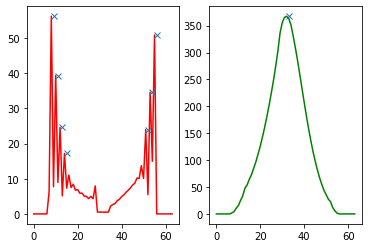

5504
peaked


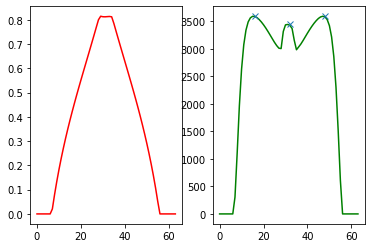

5513
peaked


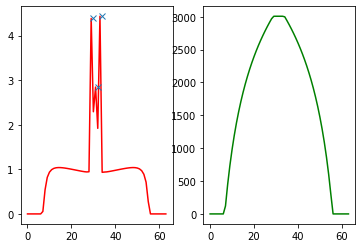

5515
peaked


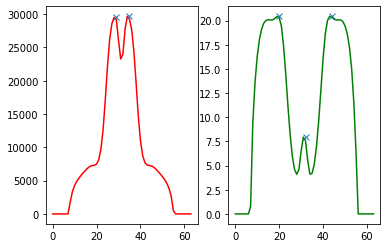

5533
peaked


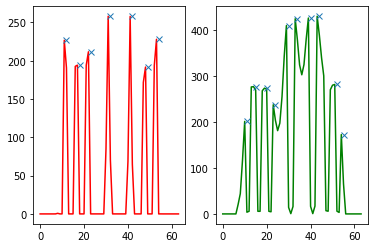

5716
peaked


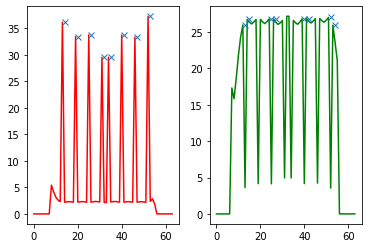

5719
peaked


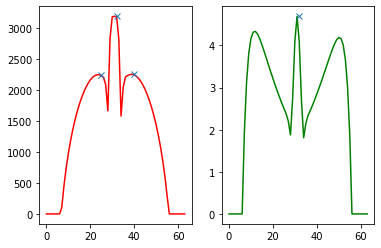

5727
peaked


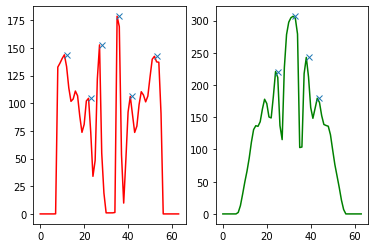

5745
peaked


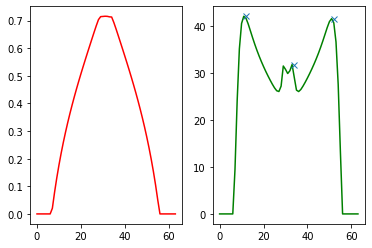

5807
peaked


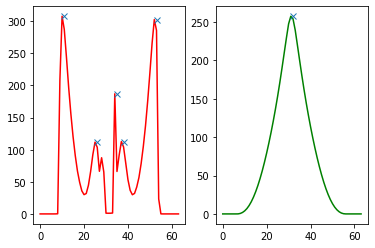

5875
peaked


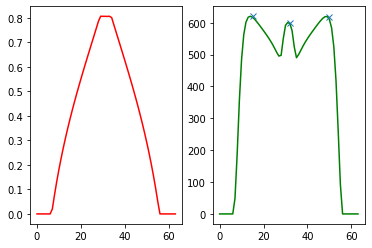

5980
peaked


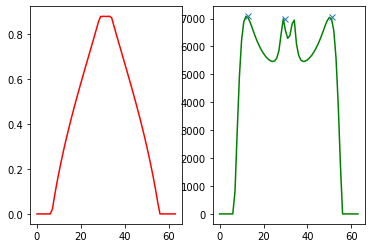

5998
peaked


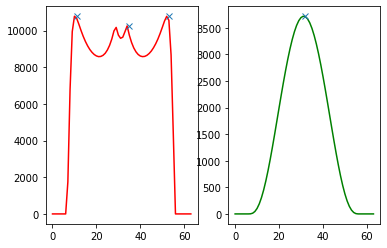

6028
peaked


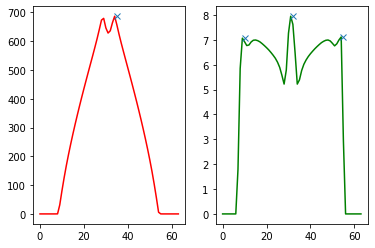

6179
peaked


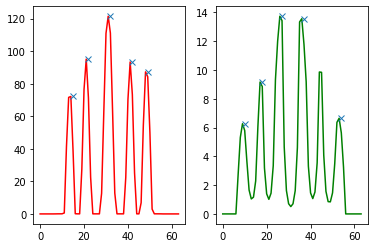

6231
peaked


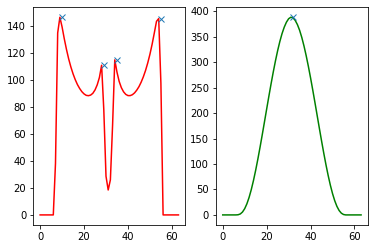

6243
peaked


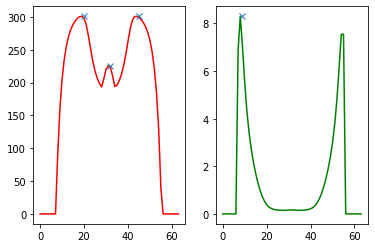

6298
peaked


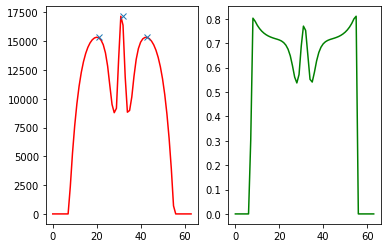

6344
peaked


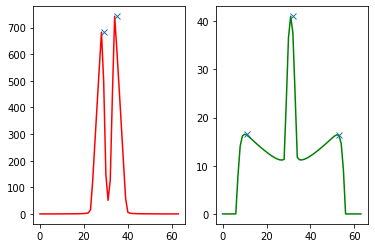

6415
peaked


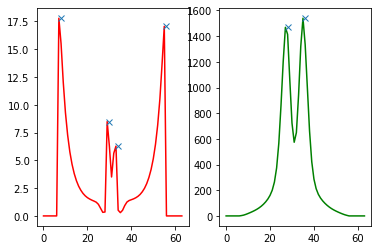

6512
peaked


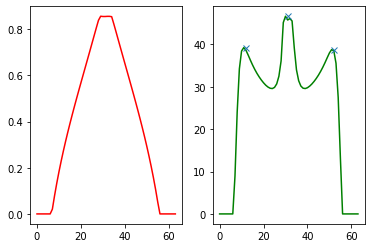

6516
peaked


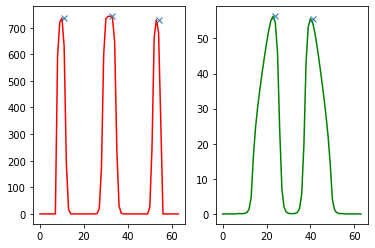

6522
peaked


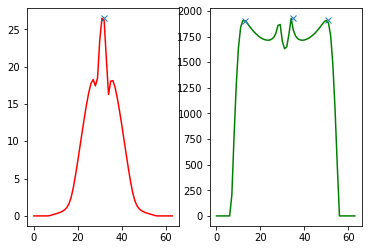

6721
peaked


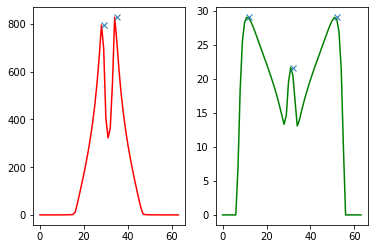

6748
peaked


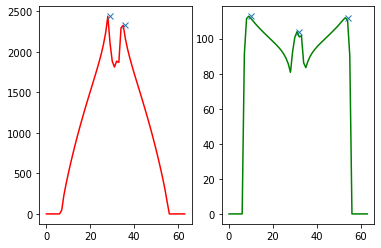

6835
peaked


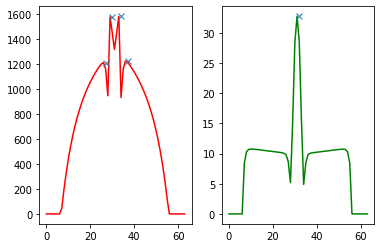

6960
peaked


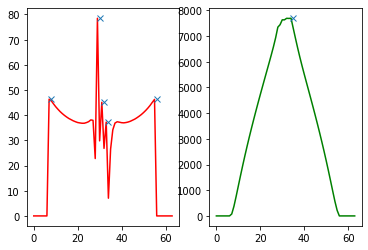

7016
peaked


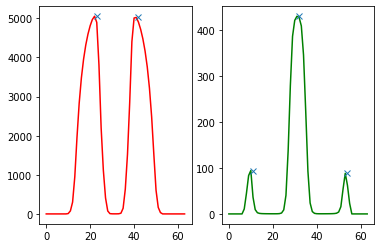

7243
peaked


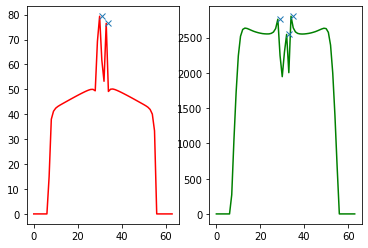

7481
peaked


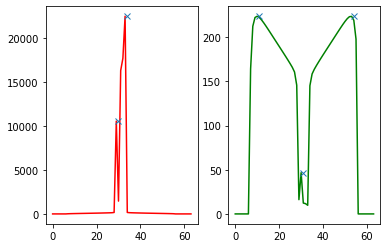

7512
peaked


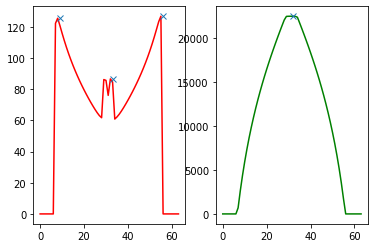

7639
peaked


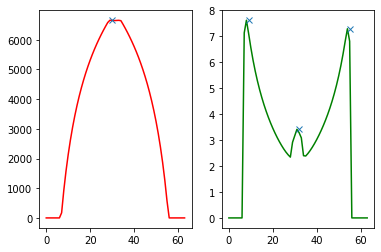

7657
peaked


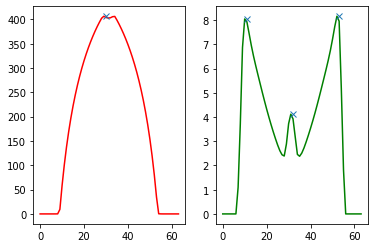

7672
peaked


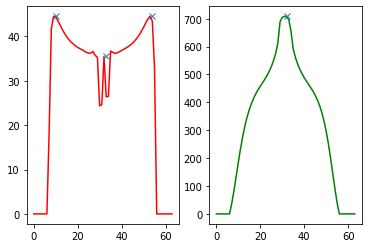

7790
peaked


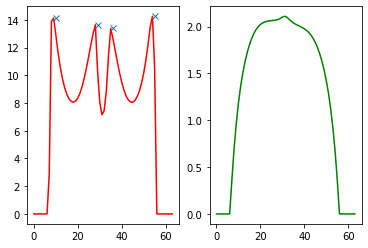

7793
peaked


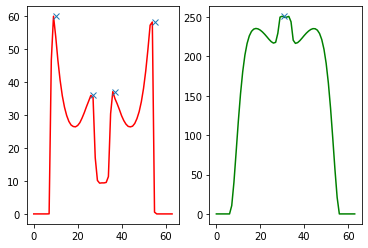

7922
peaked


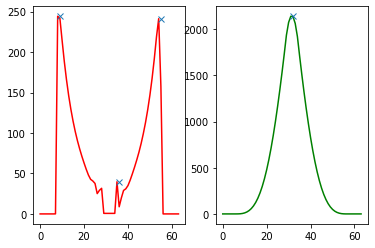

7945
peaked


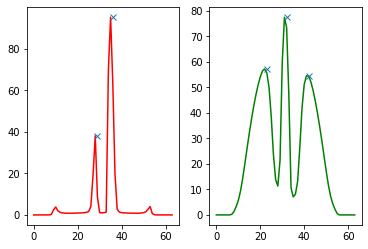

8145
peaked


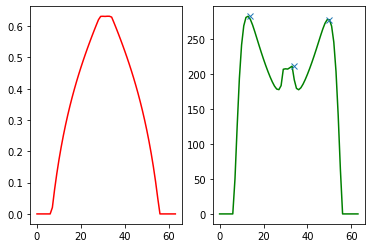

8170
peaked


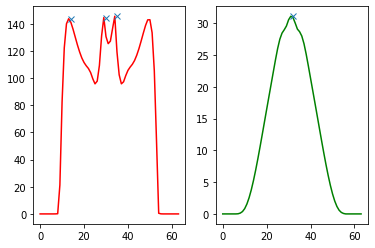

8224
peaked


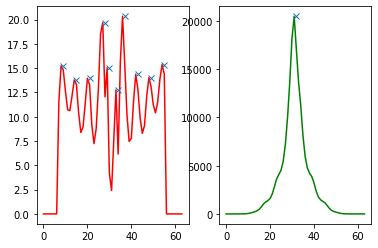

8241
peaked


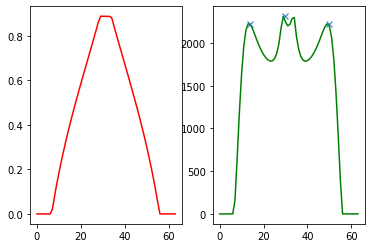

8269
peaked


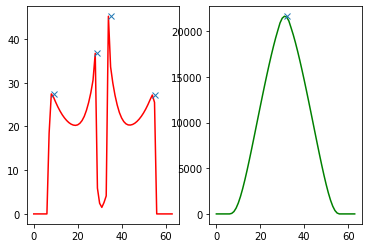

8290
peaked


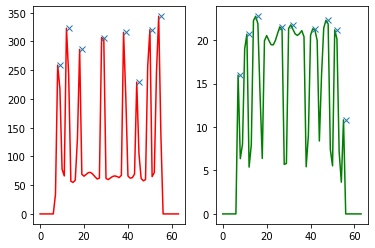

8326
peaked


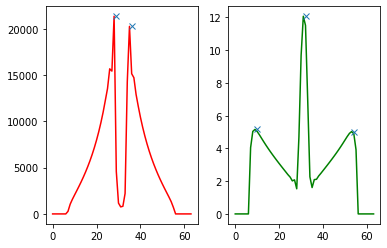

8401
peaked


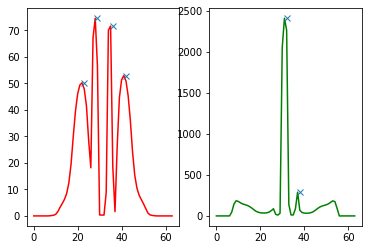

8457
peaked


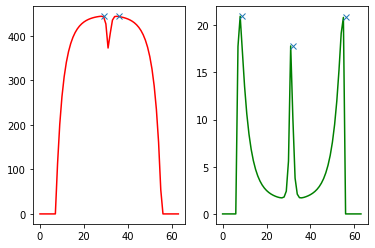

8465
peaked


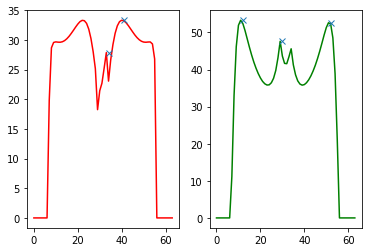

8483
peaked


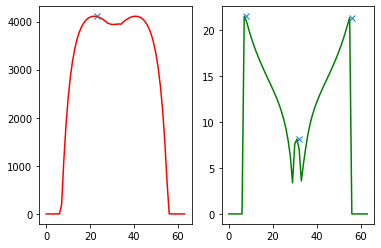

8497
peaked


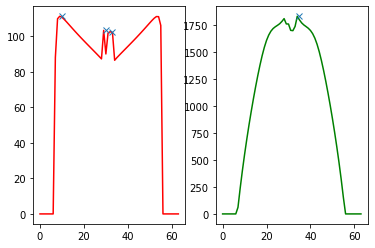

8720
peaked


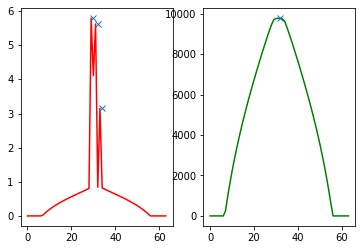

8746
peaked


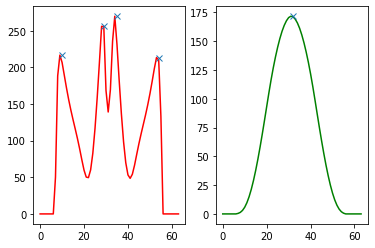

8923
peaked


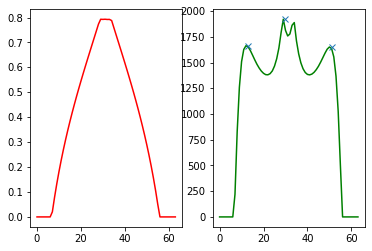

8999
peaked


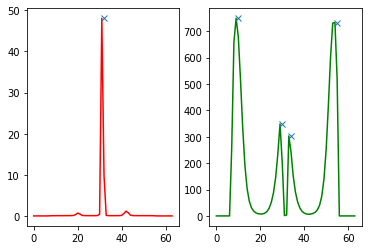

9034
peaked


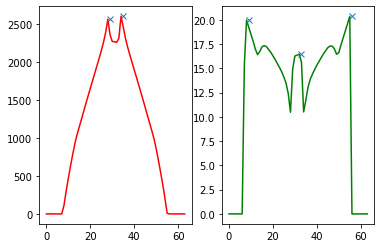

9073
peaked


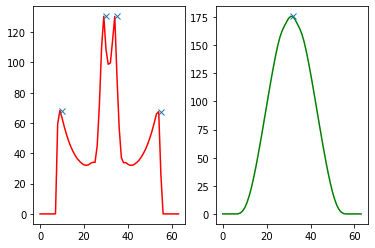

9284
peaked


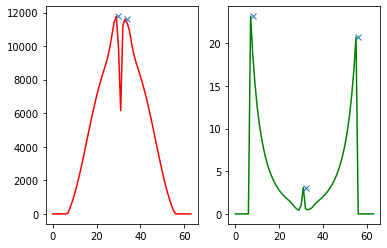

9357
peaked


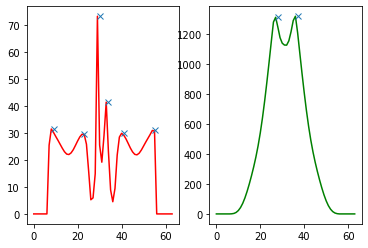

9453
peaked


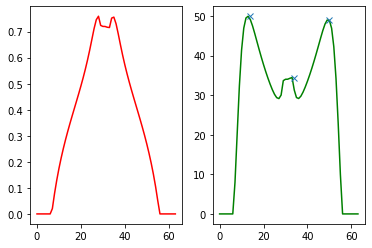

9462
peaked


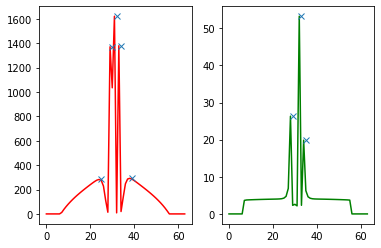

9520
peaked


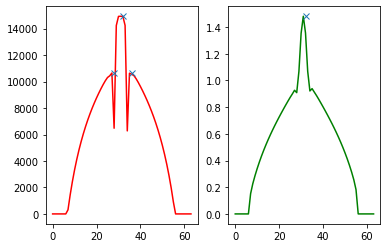

9624
peaked


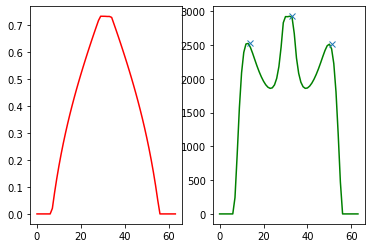

9740
peaked


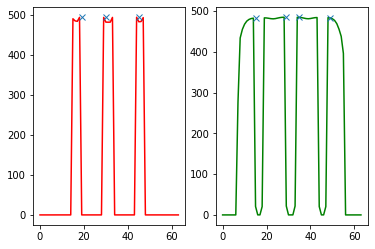

9888
peaked


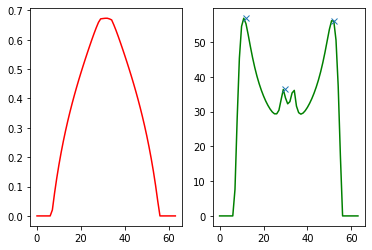

9921
peaked


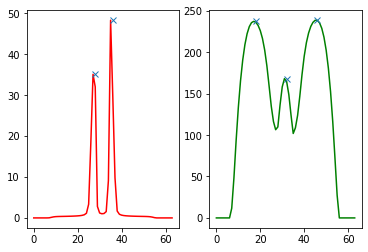

9948
peaked


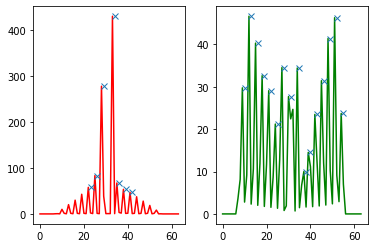

9951
peaked


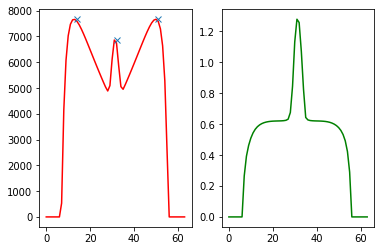

9990
peaked


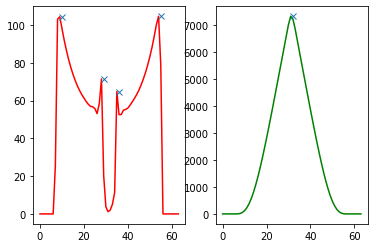

In [16]:
# stripped_parID = []
# nonstripped_parID = []
    
for parID in stripped_parID:
    filename = 'final_circuit%r_variant%r_boundary%r_%s_%sID%r_L%r_J%r_T%r_N%r'%(circuit_n,variant,boundary_coef, shape,mechanism,parID,L,J,T,N)
    simulation = pickle.load( open( modelling_ephemeral + '/3954/numerical_confocal/results/simulation/1M_df_fullcircuit/1D%s.pkl'%filename, "rb" ) ) 
    peaks_n = plot_peaks(simulation,parID,print_stripped=True)
#     if np.amax(peaks_n) > 2:
#         stripped_parID.append(parID)
#     else:
#         nonstripped_parID.append(parID)

In [18]:
pickle.dump( nonstripped_parID, open( "%s_boundary%r_nonstripped_parID_%r.pkl"%(shape,boundary_coef,parametersets_n), "wb" ) )
pickle.dump( stripped_parID, open( "%s_boundary%r_stripped_parID_%r.pkl"%(shape,boundary_coef,parametersets_n), "wb" ) )




# Growth + Closed boundary

In [20]:
boundary_coef=0
shape='growing_colony'
mechanism = 'general'
# parID=1
L,T,J,N = [8,100,64,12600]


In [21]:

nonstripped_parID = pickle.load( open( "%s_boundary%r_nonstripped_parID_%r.pkl"%(shape,boundary_coef,parametersets_n), "rb" ) ) 
stripped_parID  = pickle.load( open( "%s_boundary%r_stripped_parID_%r.pkl"%(shape,boundary_coef,parametersets_n), "rb" ) ) 


general_df['growth_0'] = general_df.apply (lambda row: define_column(row,stripped_parID), axis=1)



26
peaked


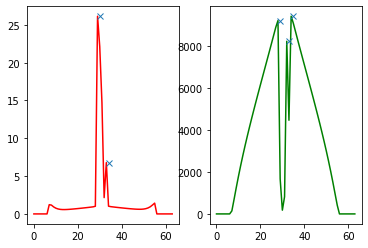

27
peaked


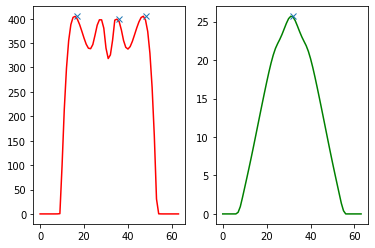

127
peaked


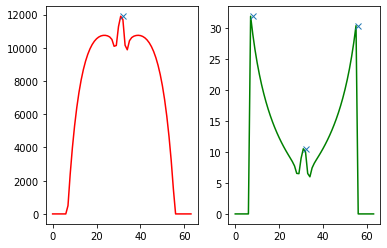

167
peaked


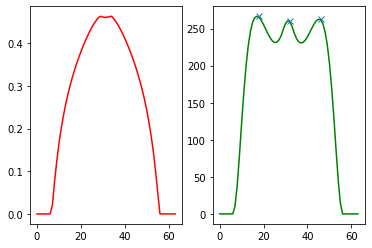

189
peaked


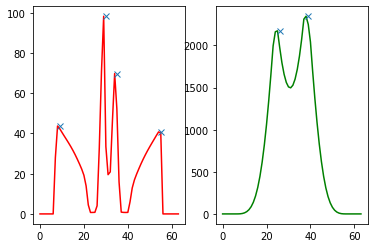

217
peaked


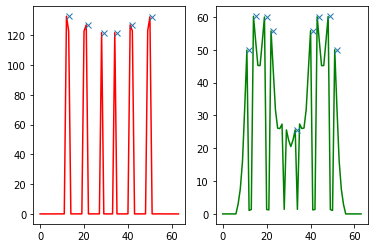

331
peaked


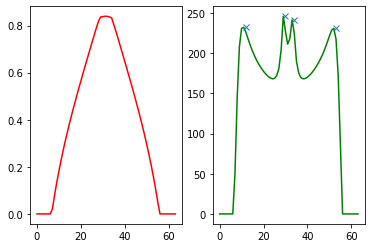

417
peaked


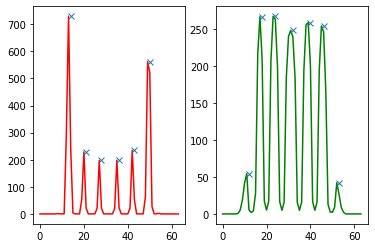

453
peaked


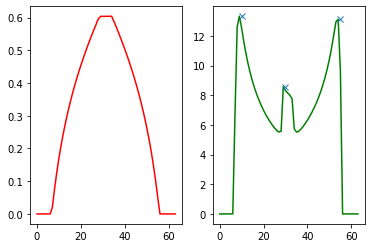

484
peaked


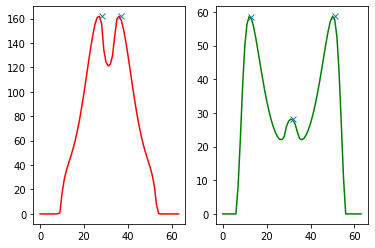

563
peaked


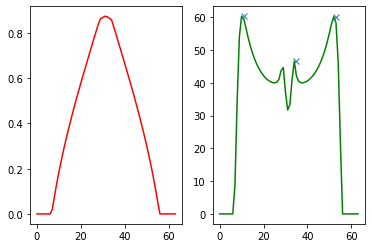

593
peaked


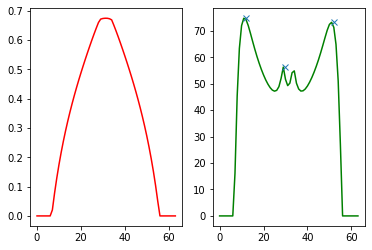

601
peaked


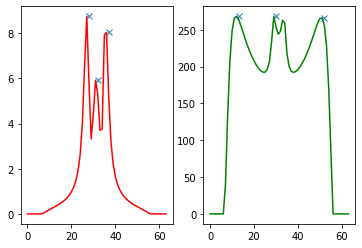

643
peaked


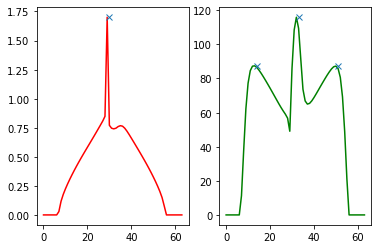

698
peaked


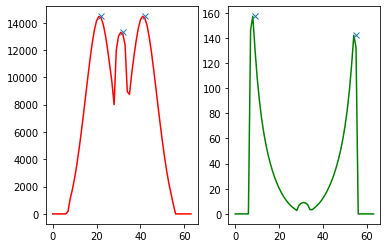

724
peaked


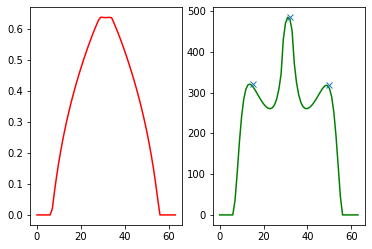

747
peaked


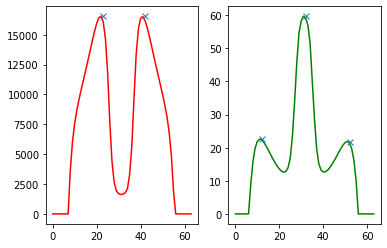

757
peaked


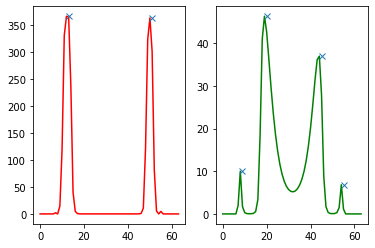

783
peaked


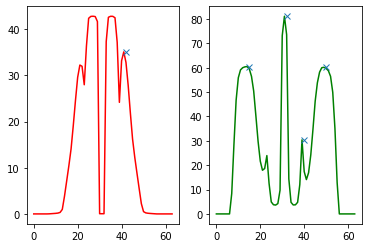

788
peaked


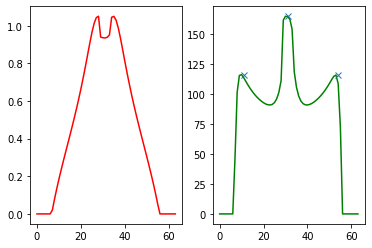

799
peaked


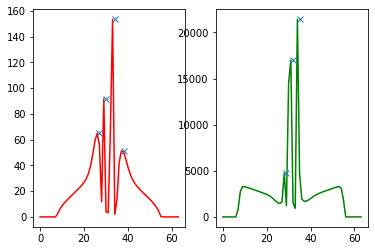

1006
peaked


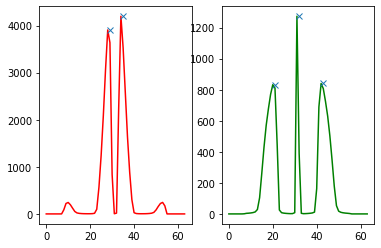

1021
peaked


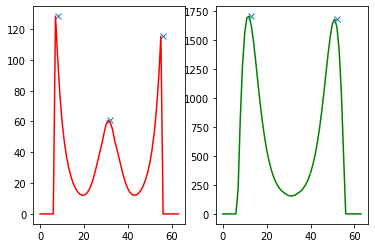

1028
peaked


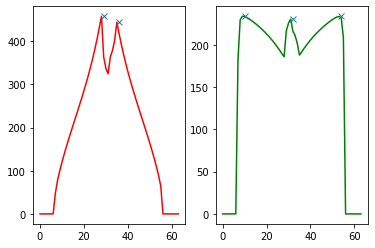

1035
peaked


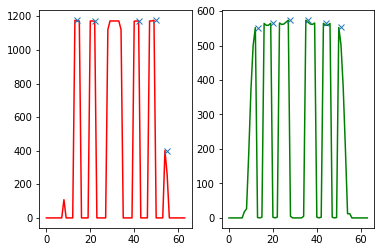

1071
peaked


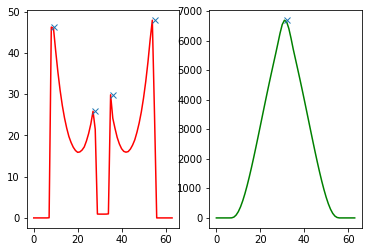

1131
peaked


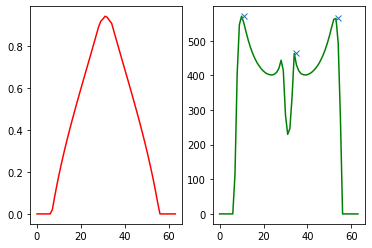

1169
peaked


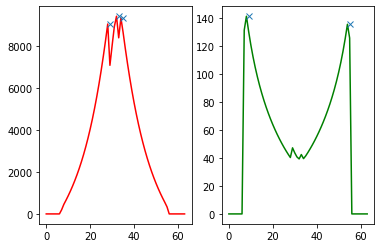

1177
peaked


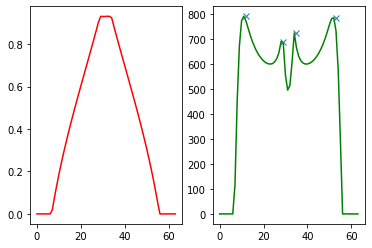

1231
peaked


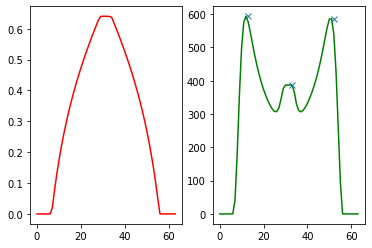

1312
peaked


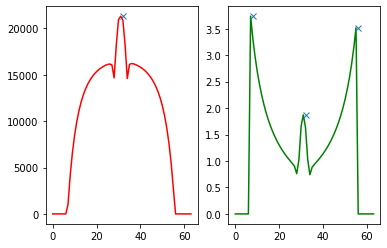

1401
peaked


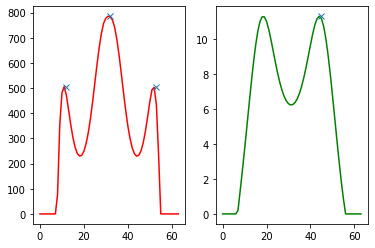

1414
peaked


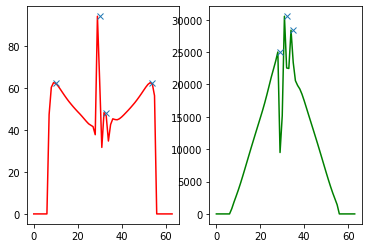

1417
peaked


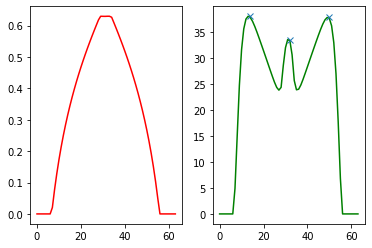

1459
peaked


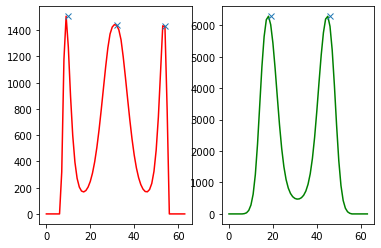

1478
peaked


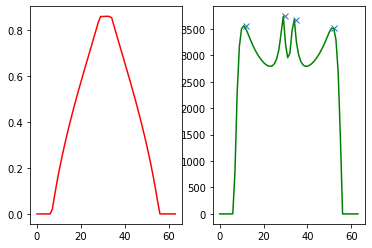

1610
peaked


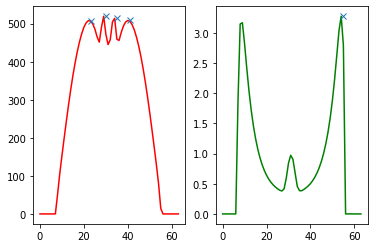

1623
peaked


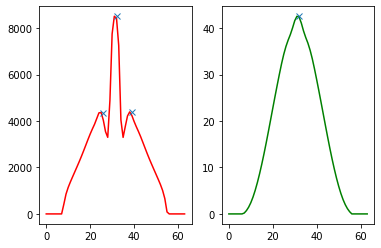

1705
peaked


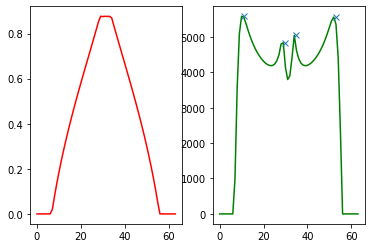

1748
peaked


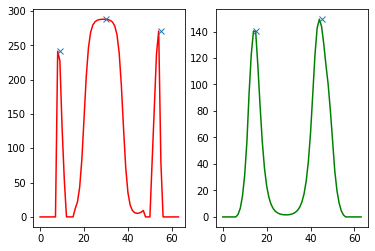

1754
peaked


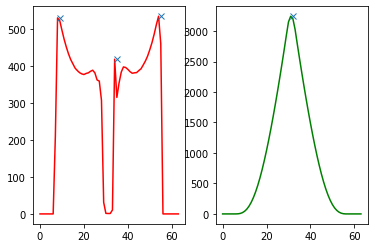

1781
peaked


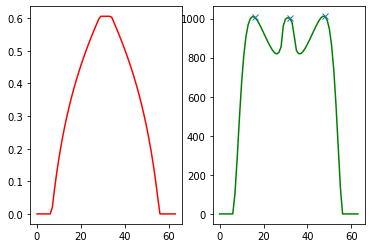

1872
peaked


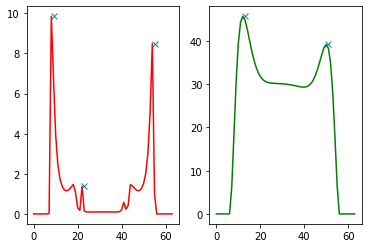

1893
peaked


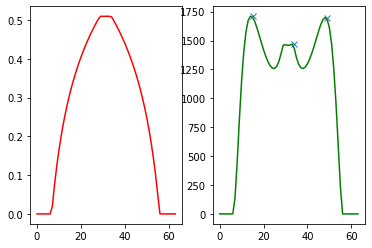

1926
peaked


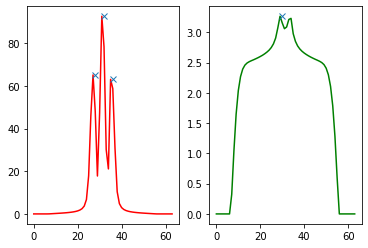

1955
peaked


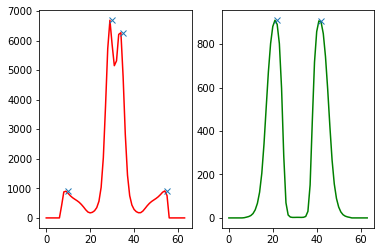

1990
peaked


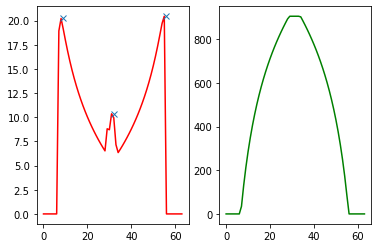

2017
peaked


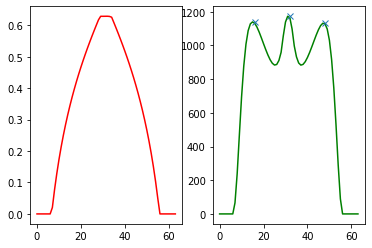

2053
peaked


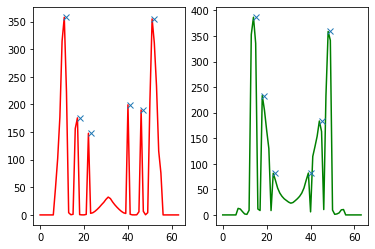

2081
peaked


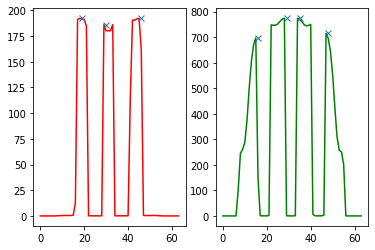

2156
peaked


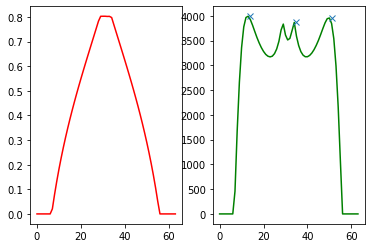

2223
peaked


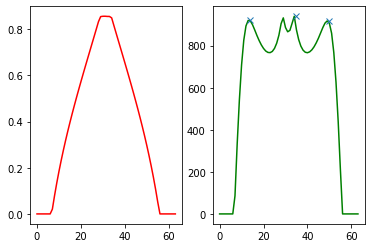

2326
peaked


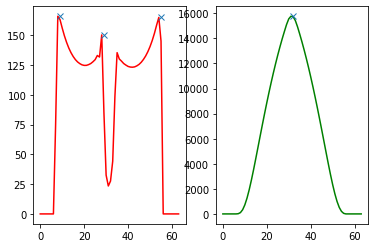

2365
peaked


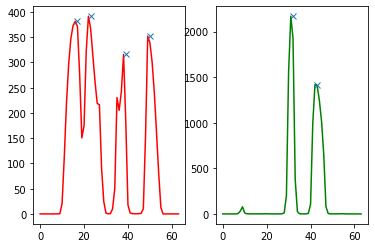

2415
peaked


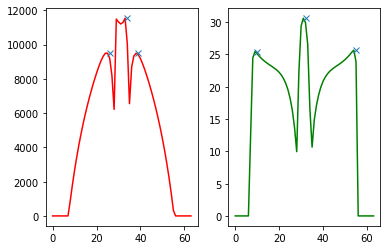

2428
peaked


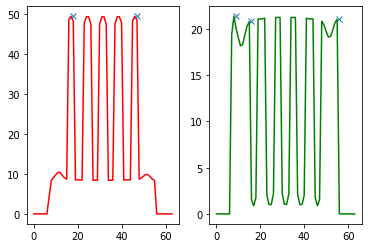

2463
peaked


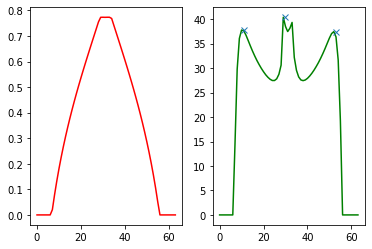

2522
peaked


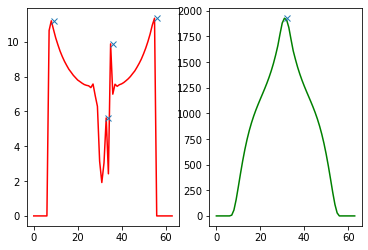

2567
peaked


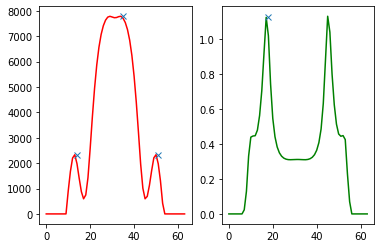

2607
peaked


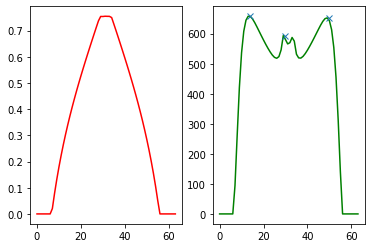

2749
peaked


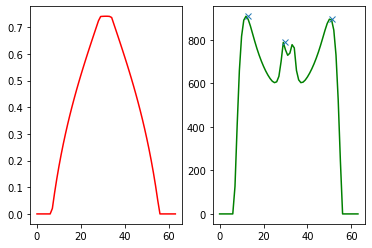

2791
peaked


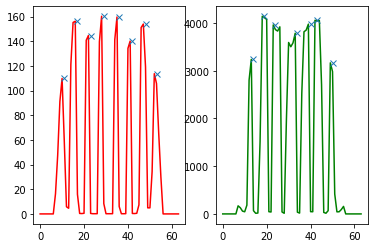

2799
peaked


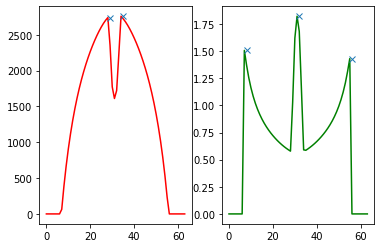

2817


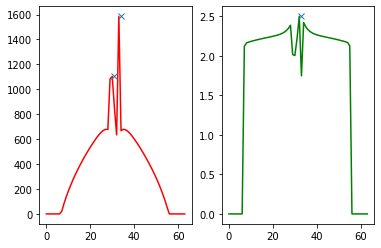

2852
peaked


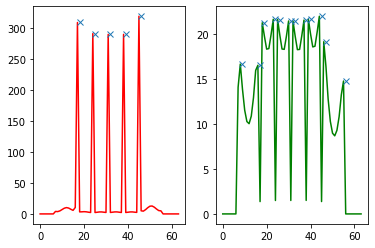

2970
peaked


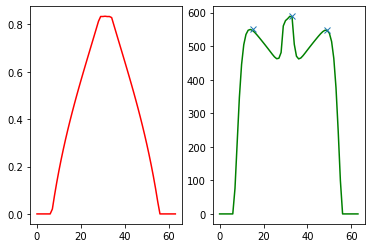

3023
peaked


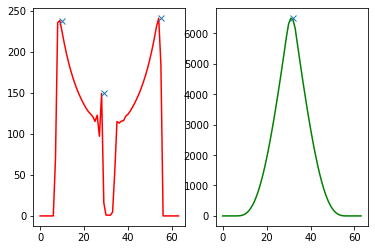

3037
peaked


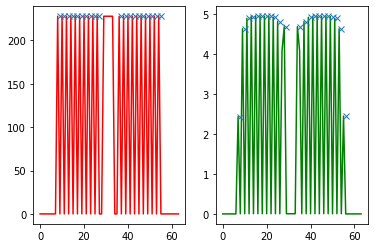

3064
peaked


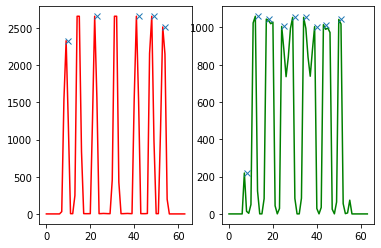

3117
peaked


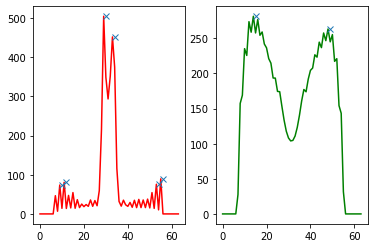

3163
peaked


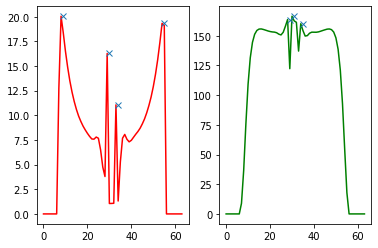

3168
peaked


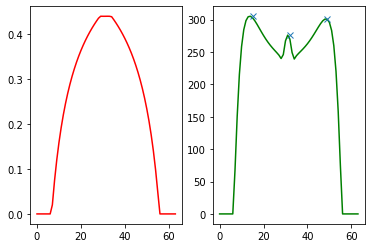

3180
peaked


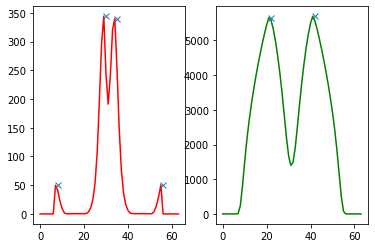

3191
peaked


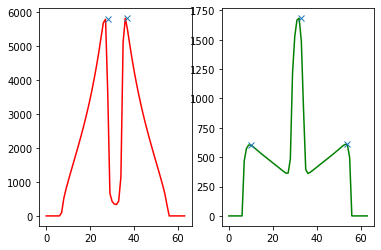

3255
peaked


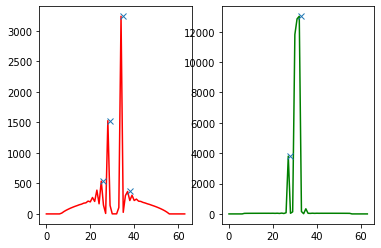

3296
peaked


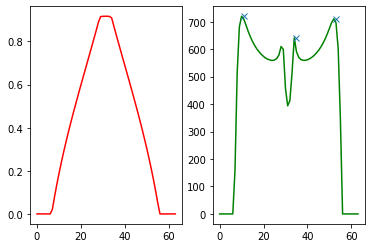

3312
peaked


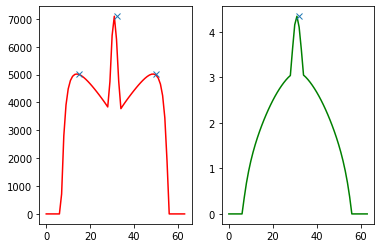

3408
peaked


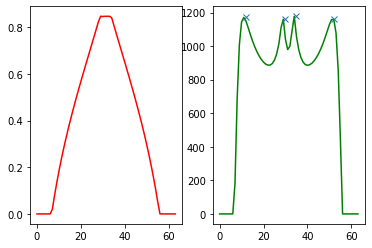

3551
peaked


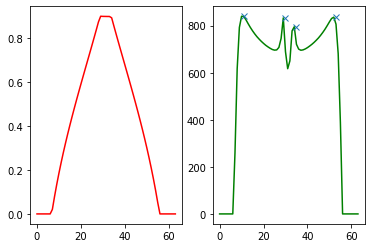

3656
peaked


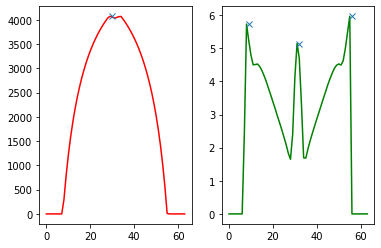

3726
peaked


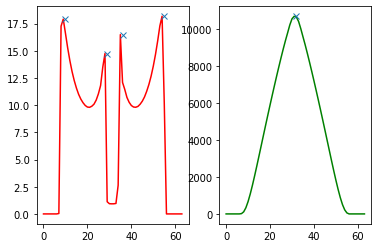

3766
peaked


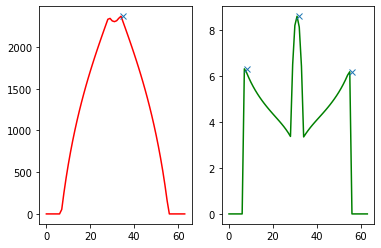

3816
peaked


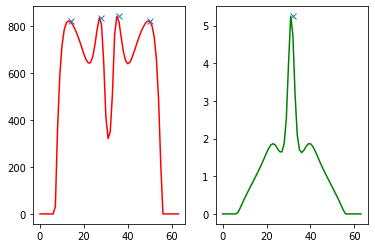

3926
peaked


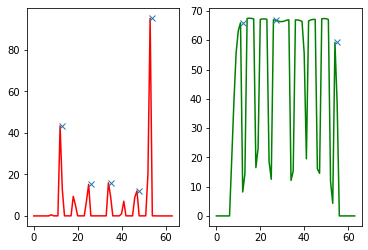

3988
peaked


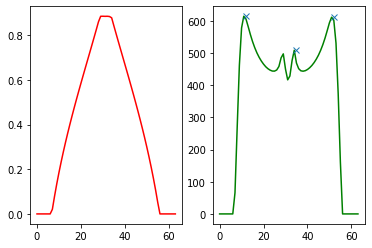

4055
peaked


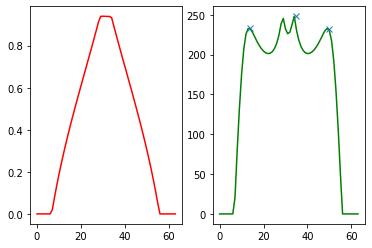

4164
peaked


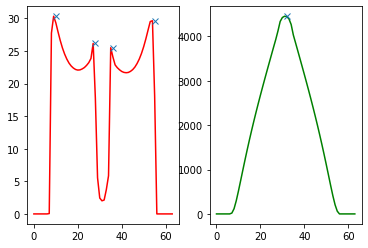

4205


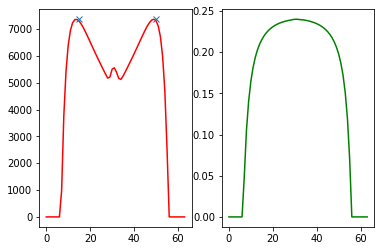

4257
peaked


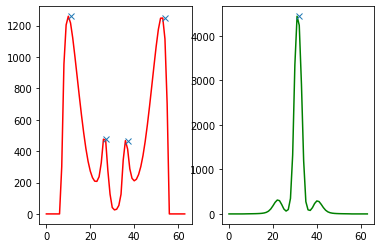

4374
peaked


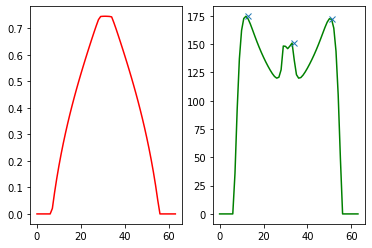

4378
peaked


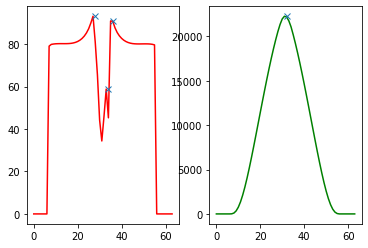

4451
peaked


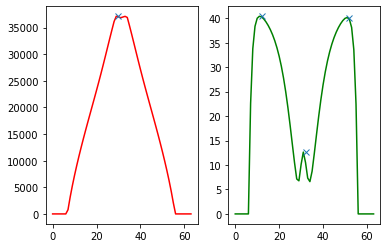

4465
peaked


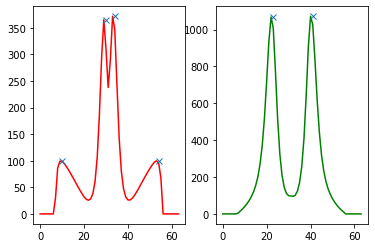

4564
peaked


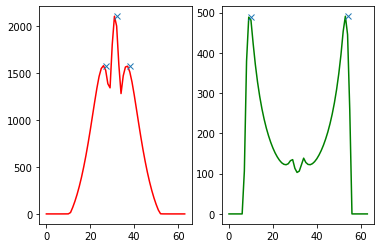

4567
peaked


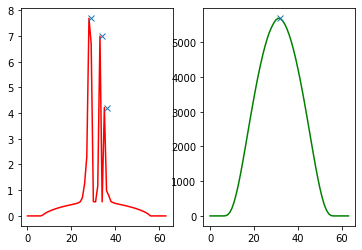

4584
peaked


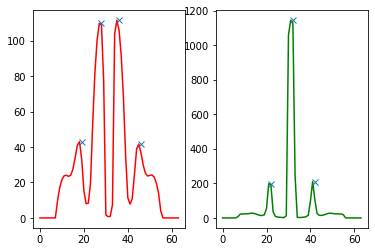

4608
peaked


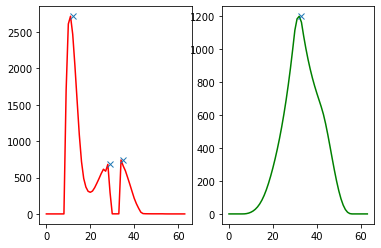

4619


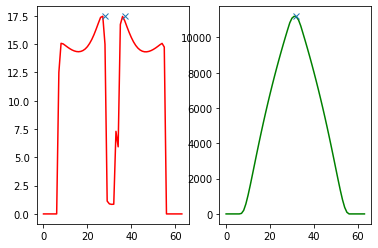

4666
peaked


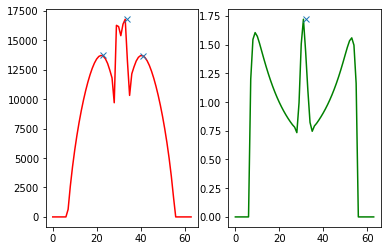

4732
peaked


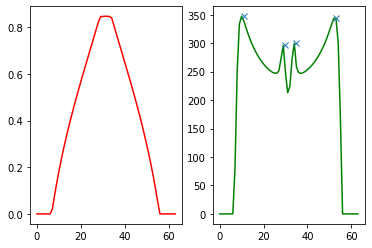

4781
peaked


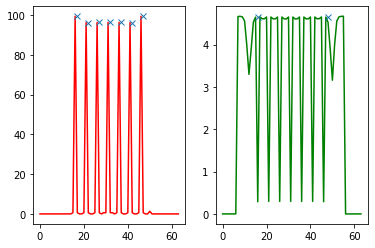

4980
peaked


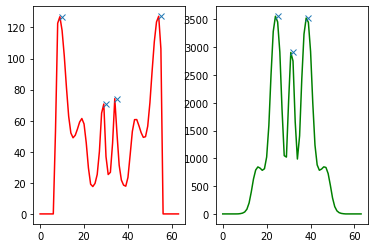

5009
peaked


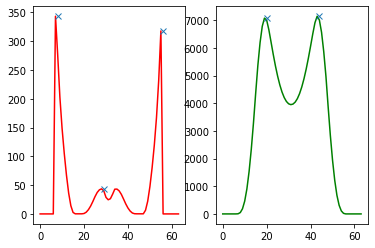

5018
peaked


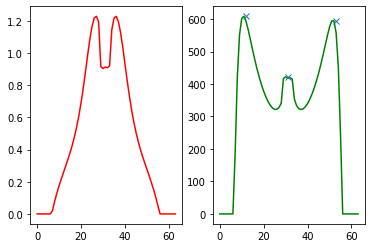

5058
peaked


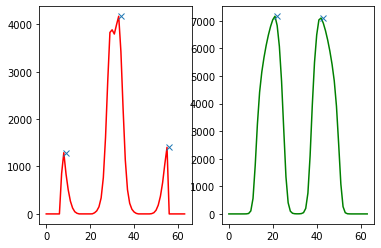

5139
peaked


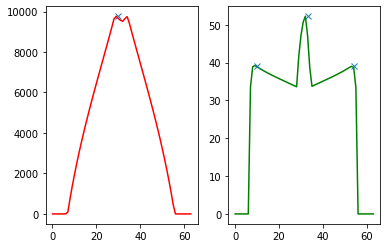

5211
peaked


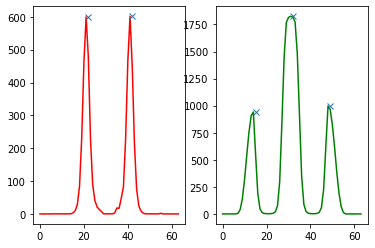

5311
peaked


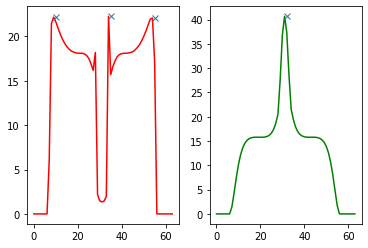

5397
peaked


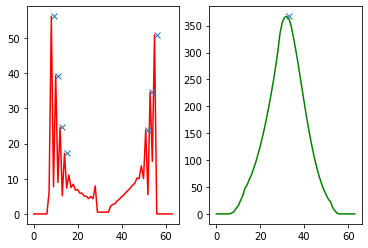

5504
peaked


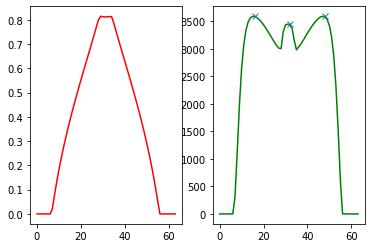

5513


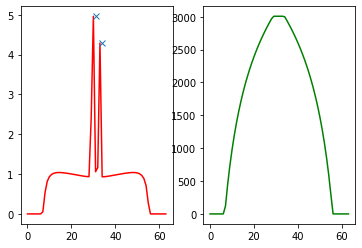

5515


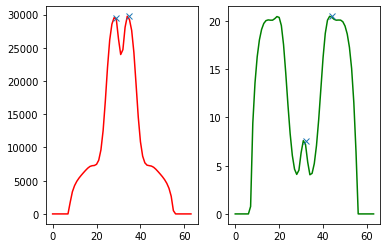

5533
peaked


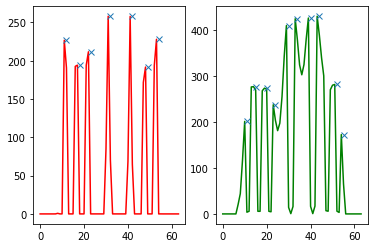

5716
peaked


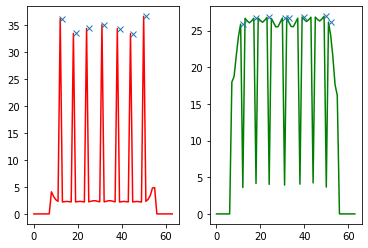

5719
peaked


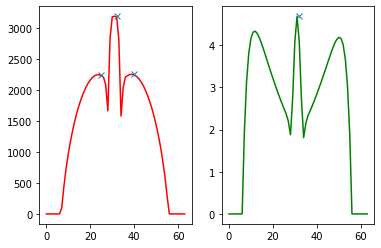

5727
peaked


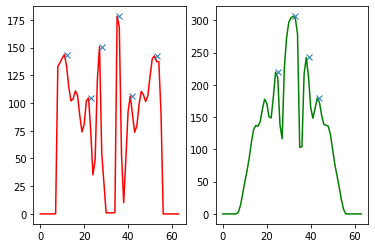

5745
peaked


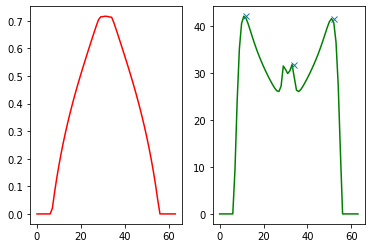

5807
peaked


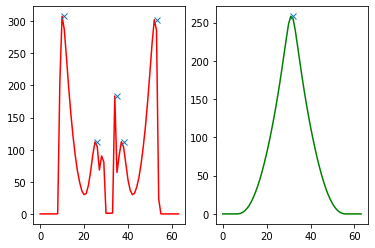

5875
peaked


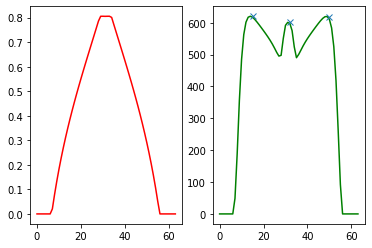

5980
peaked


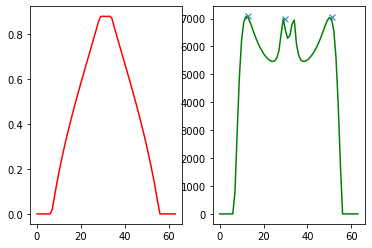

5998
peaked


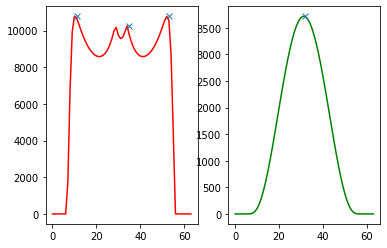

6028
peaked


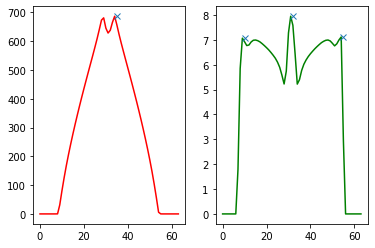

6179
peaked


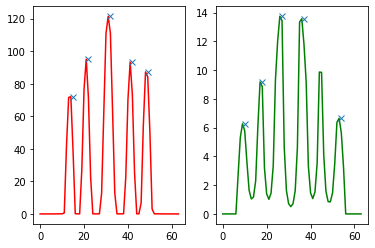

6231
peaked


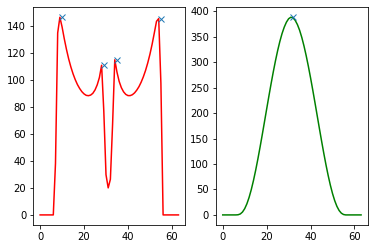

6243
peaked


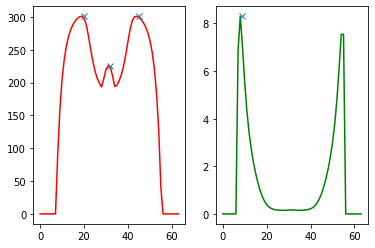

6298
peaked


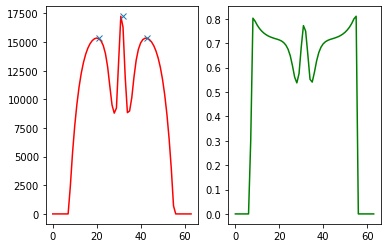

6344
peaked


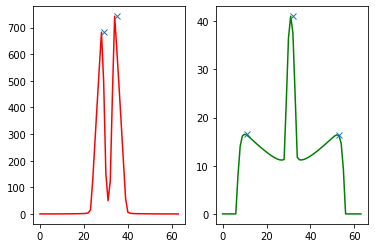

6415
peaked


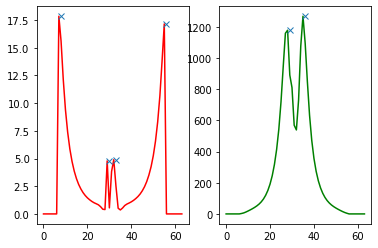

6512
peaked


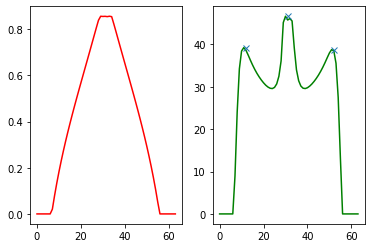

6516
peaked


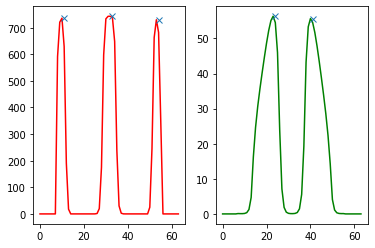

6522
peaked


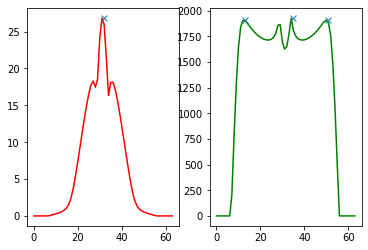

6721
peaked


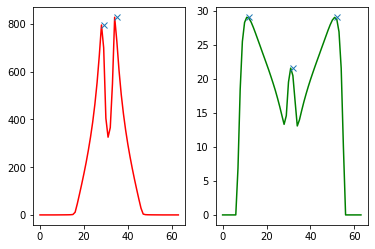

6748
peaked


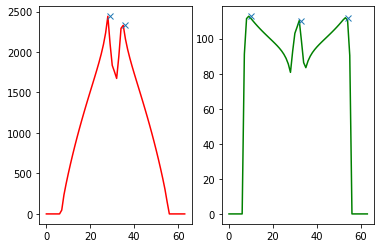

6835
peaked


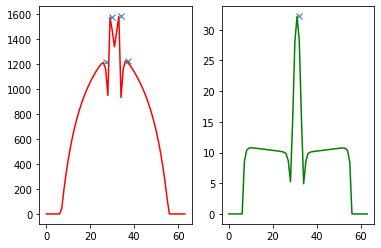

6960
peaked


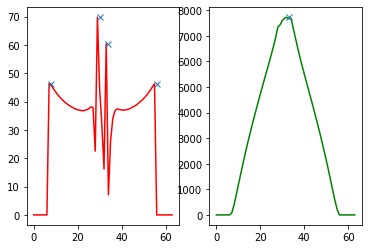

7016
peaked


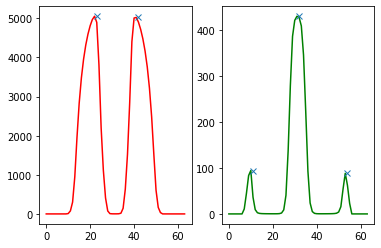

7243
peaked


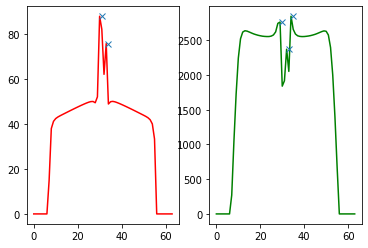

7481


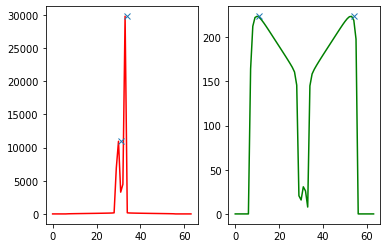

7512
peaked


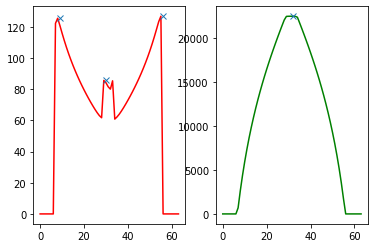

7639


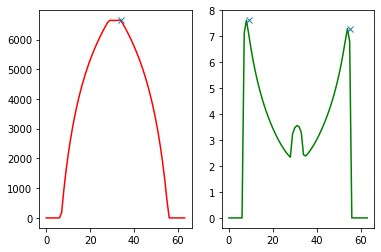

7657
peaked


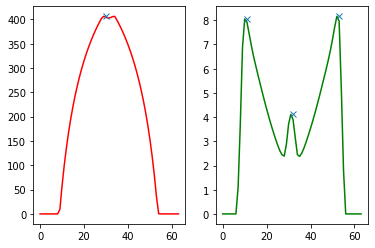

7672
peaked


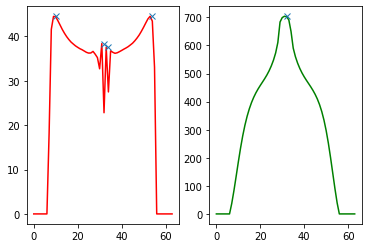

7790
peaked


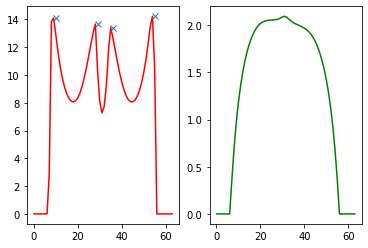

7793
peaked


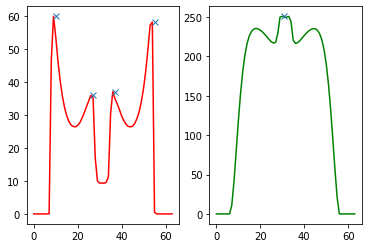

7922
peaked


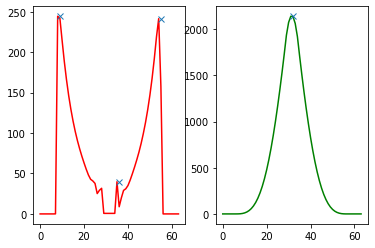

7945
peaked


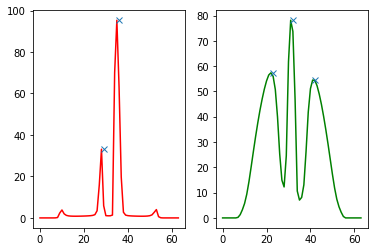

8145
peaked


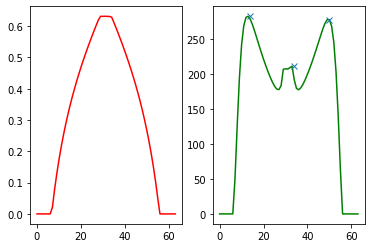

8170
peaked


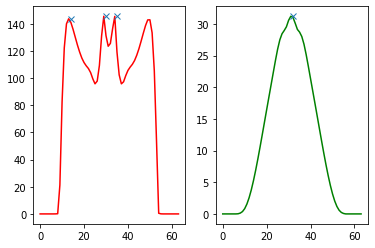

8224
peaked


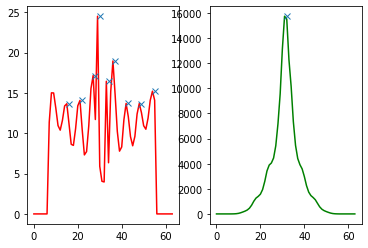

8241
peaked


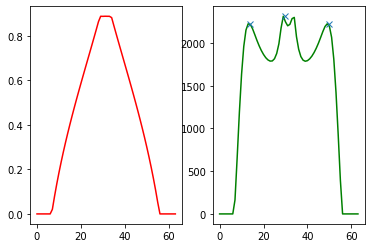

8269
peaked


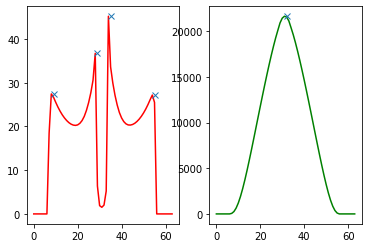

8290
peaked


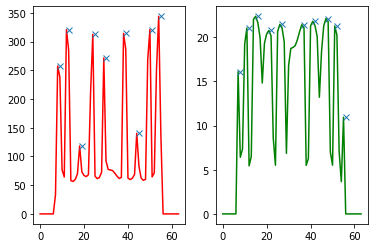

8326
peaked


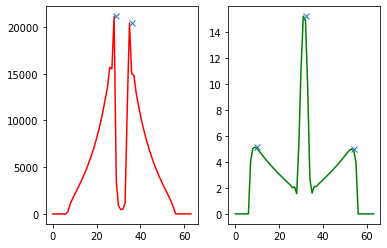

8401
peaked


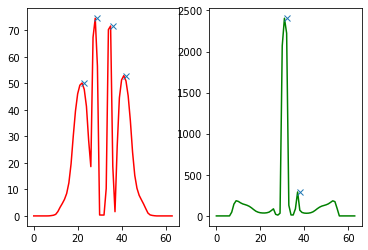

8457
peaked


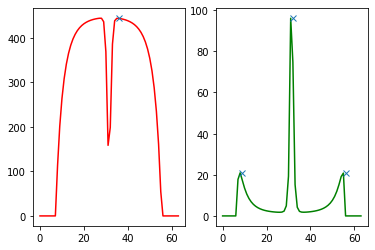

8465
peaked


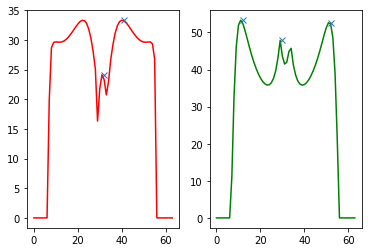

8483
peaked


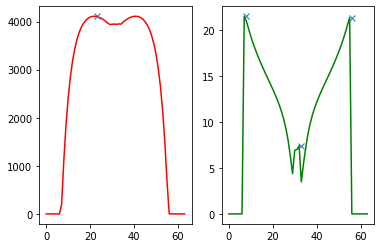

8497


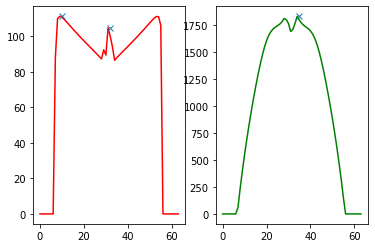

8720


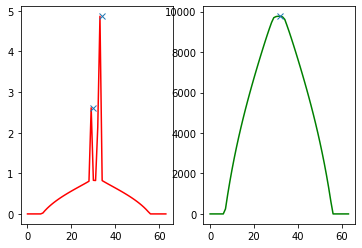

8746
peaked


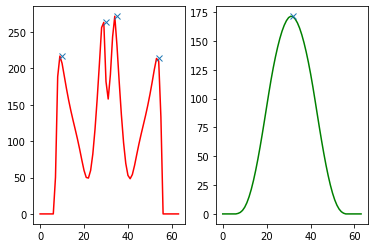

8923
peaked


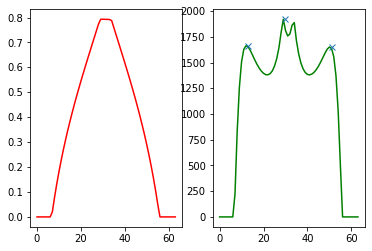

8999
peaked


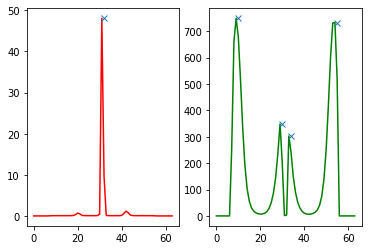

9034
peaked


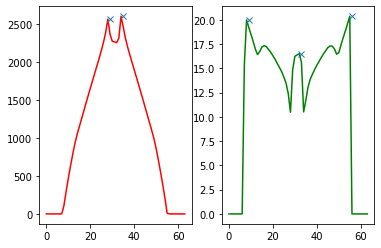

9073
peaked


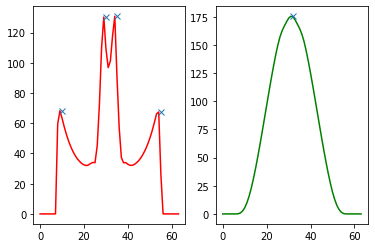

9284


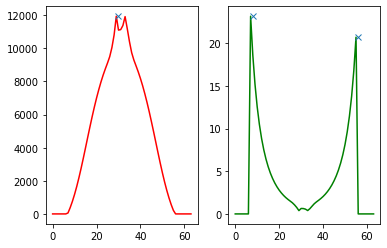

9357
peaked


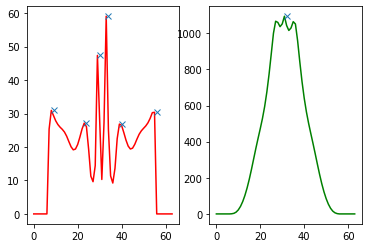

9453
peaked


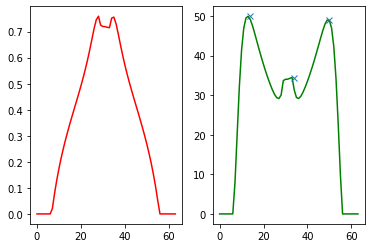

9462


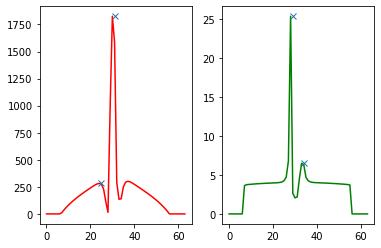

9520
peaked


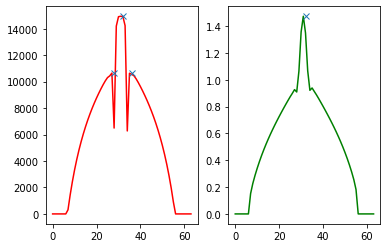

9624
peaked


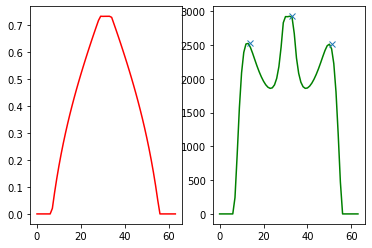

9740
peaked


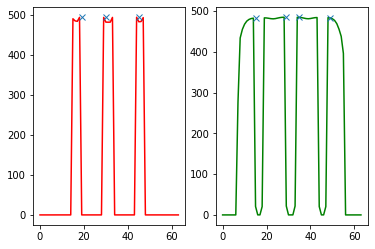

9888
peaked


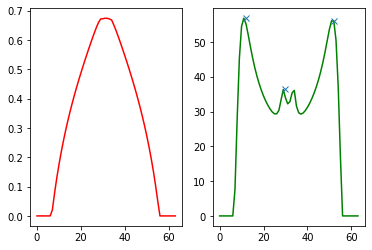

9921
peaked


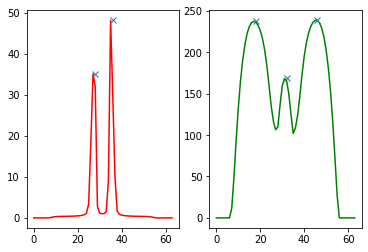

9948
peaked


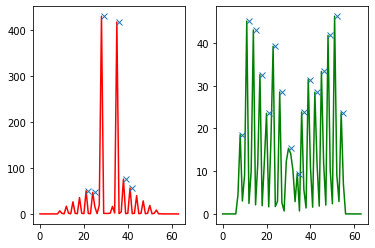

9951
peaked


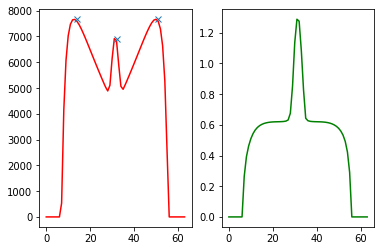

9990
peaked


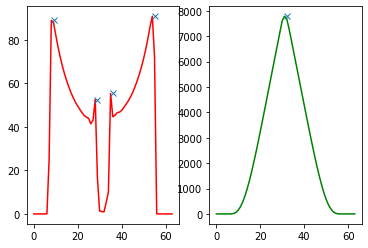

In [140]:
# stripped_parID = []
# nonstripped_parID = []
    
for parID in stripped_parID:
    filename = 'final_circuit%r_variant%r_boundary%r_%s_%sID%r_L%r_J%r_T%r_N%r'%(circuit_n,variant,boundary_coef, shape,mechanism,parID,L,J,T,N)
    simulation = pickle.load( open( modelling_ephemeral + '/3954/numerical_confocal/results/simulation/1M_df_fullcircuit/1D%s.pkl'%filename, "rb" ) ) 
    peaks_n = plot_peaks(simulation,parID,print_stripped=True)
#     if np.amax(peaks_n) > 2:
#         stripped_parID.append(parID)
#     else:
#         nonstripped_parID.append(parID)

In [20]:
pickle.dump( nonstripped_parID, open( "%s_boundary%r_nonstripped_parID_10000.pkl"%(shape,boundary_coef), "wb" ) )
pickle.dump( stripped_parID, open( "%s_boundary%r_stripped_parID_10000.pkl"%(shape,boundary_coef), "wb" ) )



# No growth + Open boundary

In [22]:
boundary_coef=1
shape='no_growth'
mechanism = 'general'
L,T,J,N = [8,100,64,12600]


In [23]:
nonstripped_parID = pickle.load( open( "%s_boundary%r_nonstripped_parID_%r.pkl"%(shape,boundary_coef,parametersets_n), "rb" ) ) 
stripped_parID  = pickle.load( open( "%s_boundary%r_stripped_parID_%r.pkl"%(shape,boundary_coef,parametersets_n), "rb" ) ) 


general_df['no_growth_1'] = general_df.apply (lambda row: define_column(row,stripped_parID), axis=1)


26
peaked


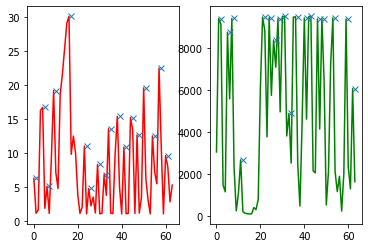

108
peaked


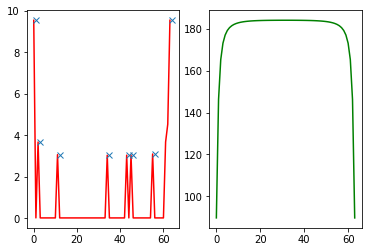

119
peaked


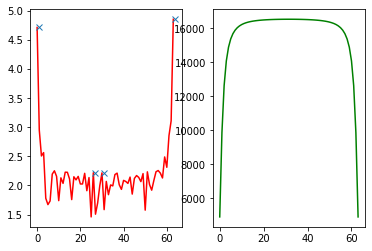

127
peaked


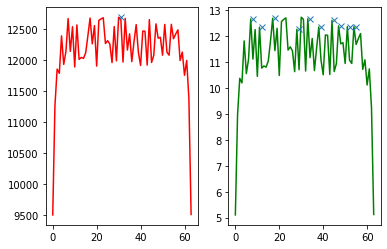

158
peaked


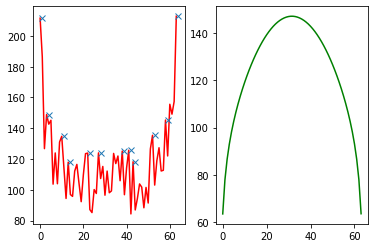

172
peaked


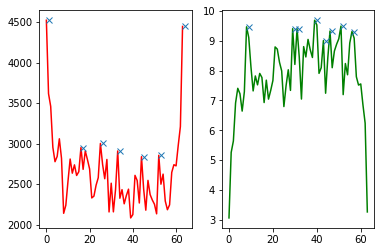

212
peaked


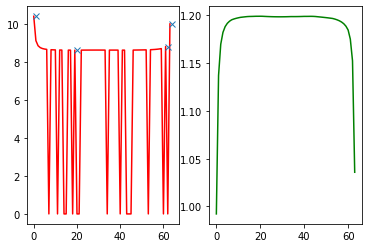

282
peaked


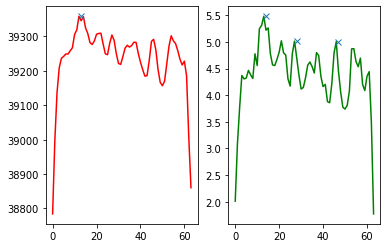

330
peaked


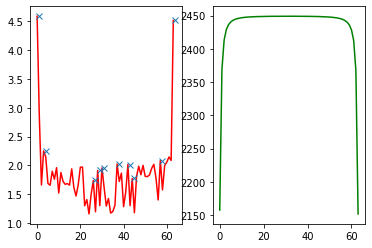

382
peaked


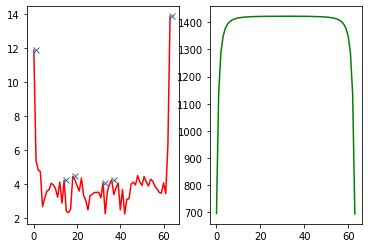

414
peaked


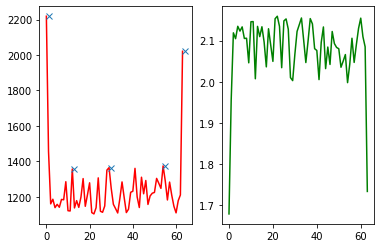

426
peaked


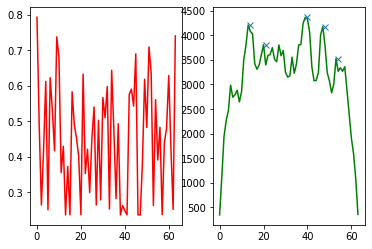

513
peaked


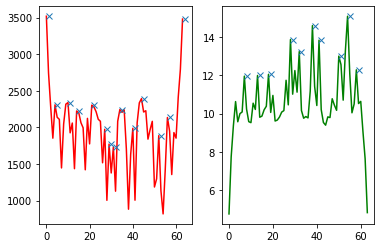

514
peaked


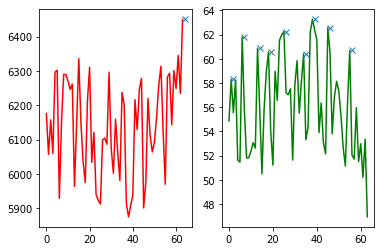

522
peaked


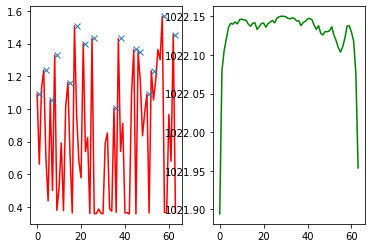

532
peaked


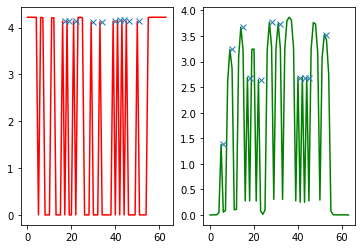

545
peaked


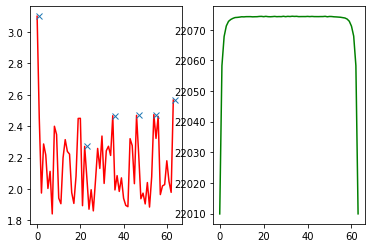

594
peaked


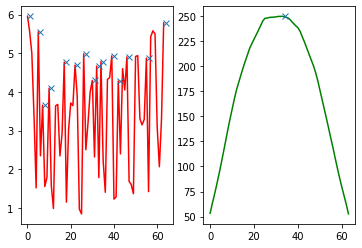

600
peaked


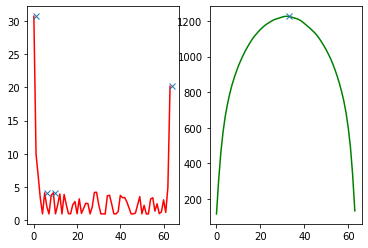

605
peaked


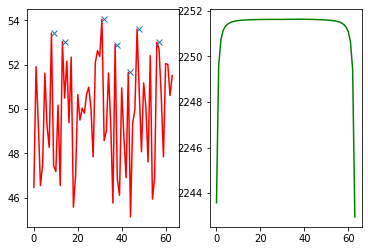

643
peaked


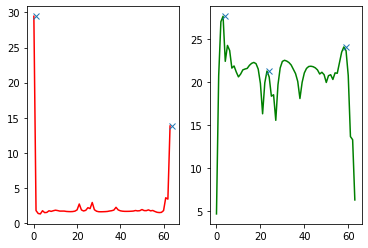

663
peaked


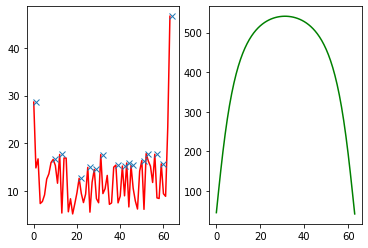

696
peaked


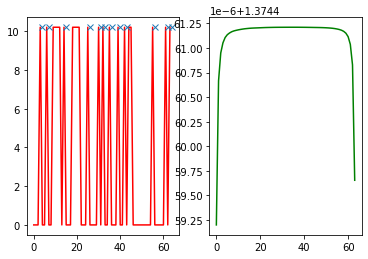

758
peaked


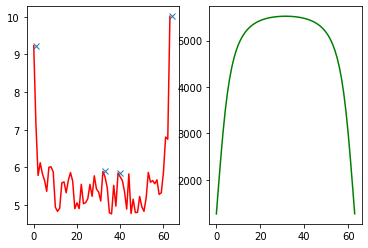

797
peaked


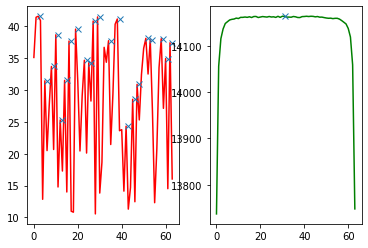

799
peaked


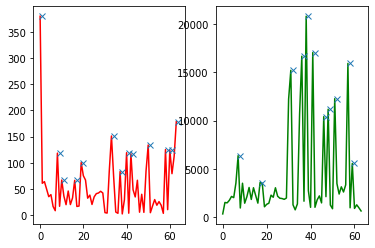

831
peaked


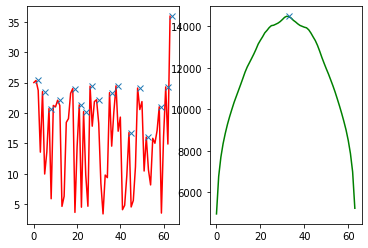

1168
peaked


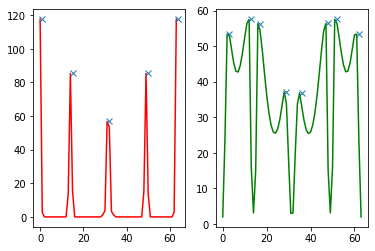

1169
peaked


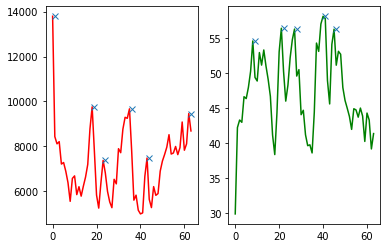

1170
peaked


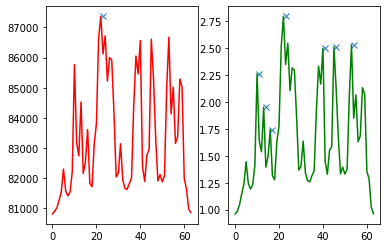

1391
peaked


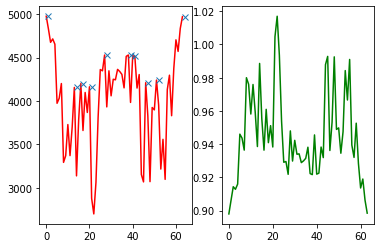

1404
peaked


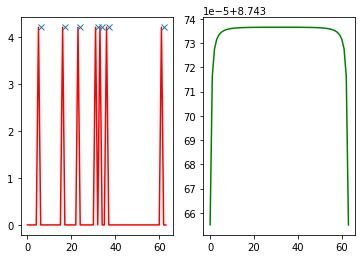

1414
peaked


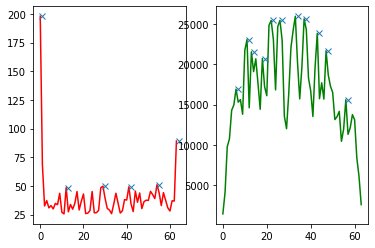

1511
peaked


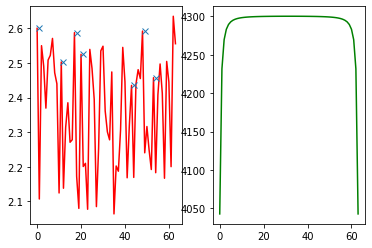

1640
peaked


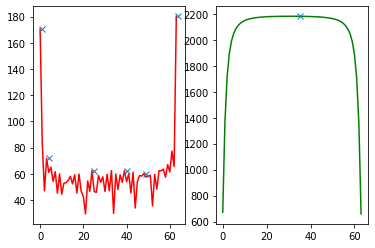

1718
peaked


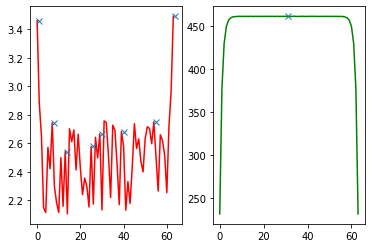

1797
peaked


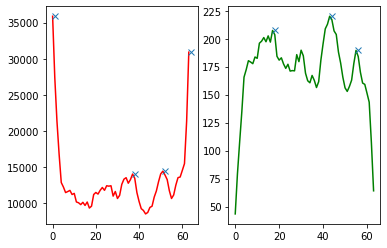

1928
peaked


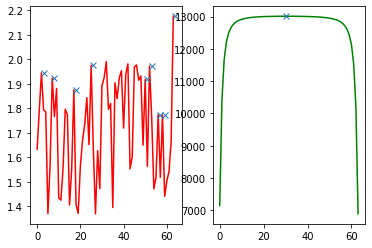

1980
peaked


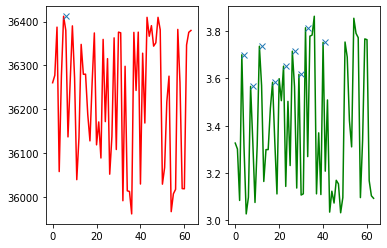

1990
peaked


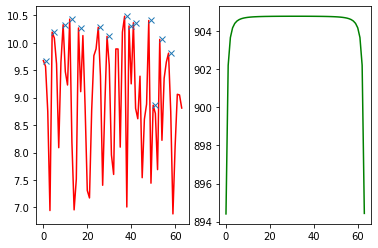

2005
peaked


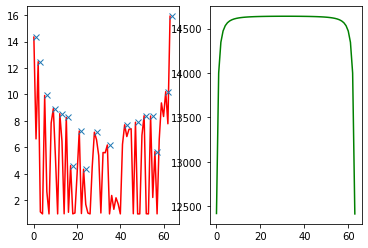

2008
peaked


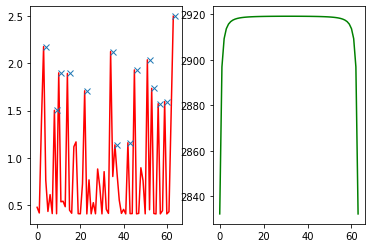

2111
peaked


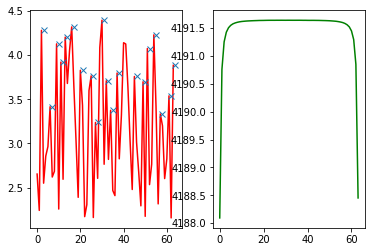

2136
peaked


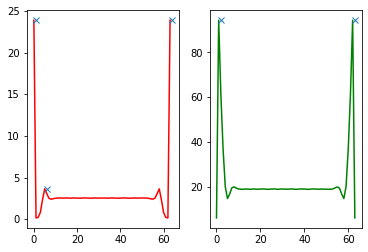

2160
peaked


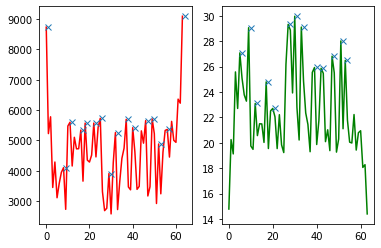

2173
peaked


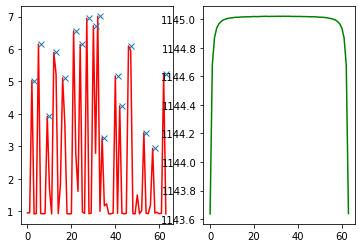

2185
peaked


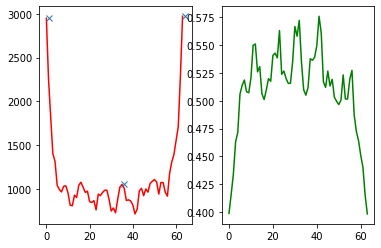

2300
peaked


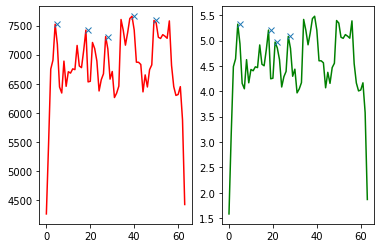

2306
peaked


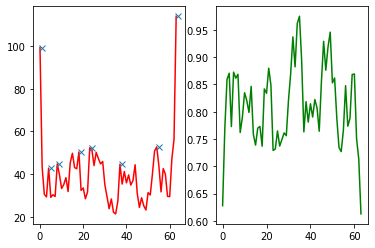

2326
peaked


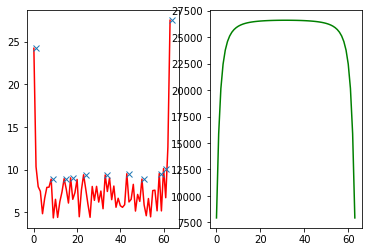

2387
peaked


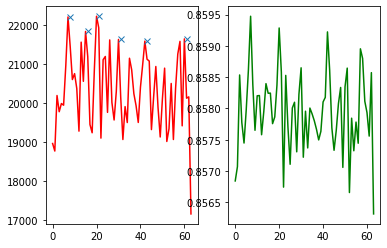

2390
peaked


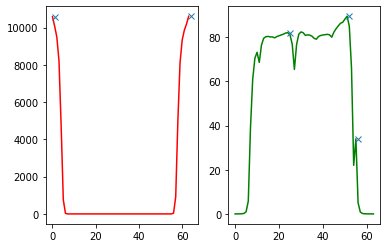

2459
peaked


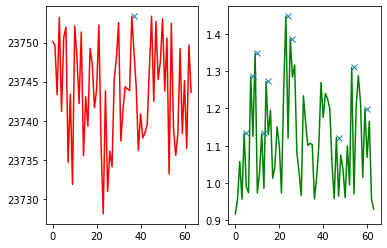

2522
peaked


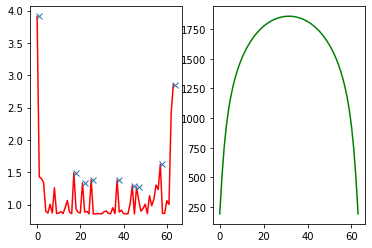

2681
peaked


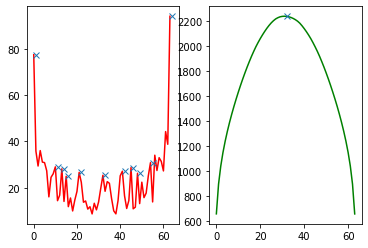

2690
peaked


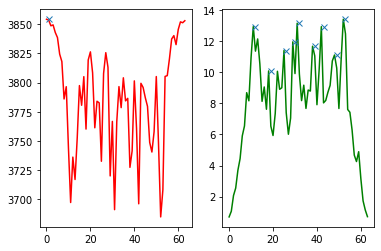

2802
peaked


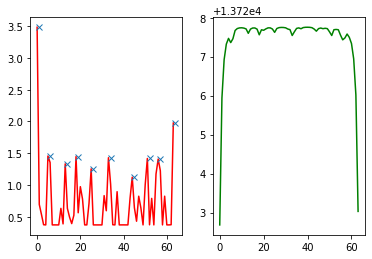

2817
peaked


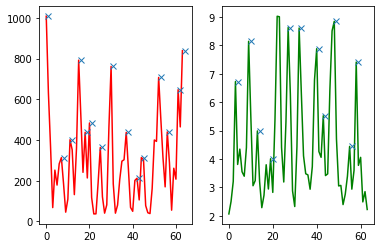

2852
peaked


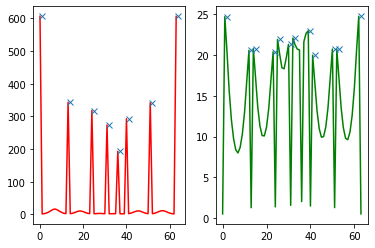

2905
peaked


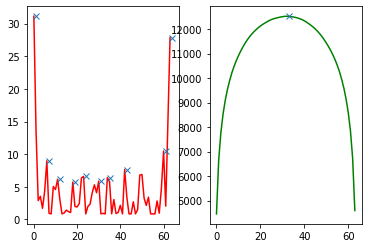

2954
peaked


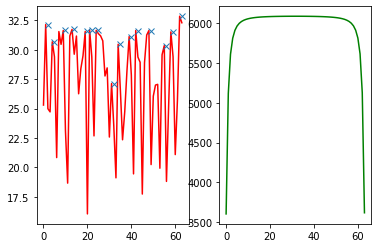

2989
peaked


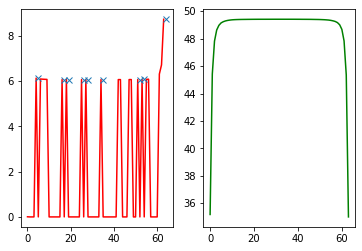

3043
peaked


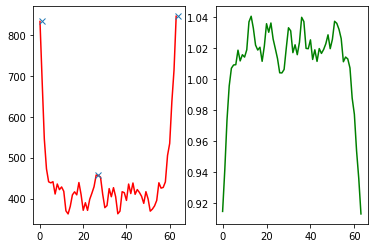

3117
peaked


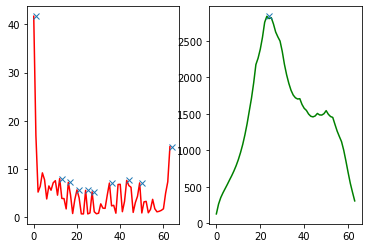

3183
peaked


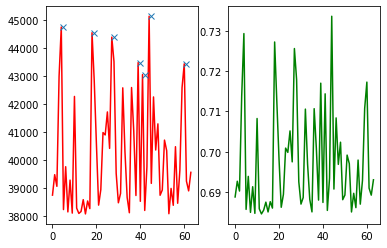

3190
peaked


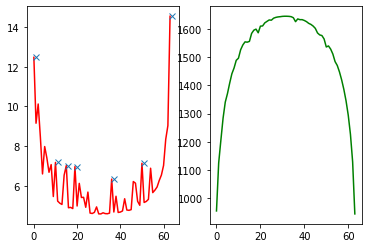

3191
peaked


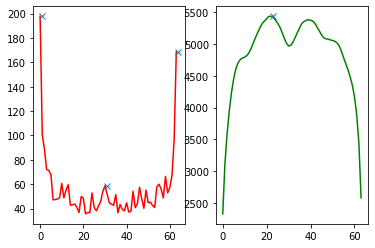

3232
peaked


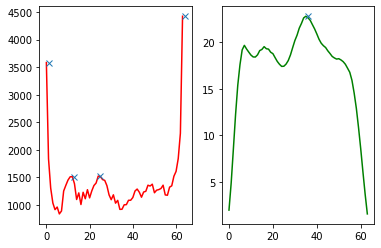

3243
peaked


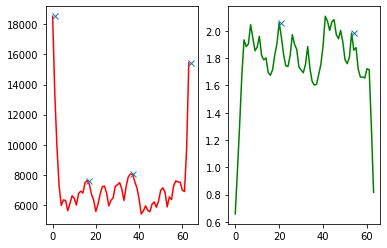

3270
peaked


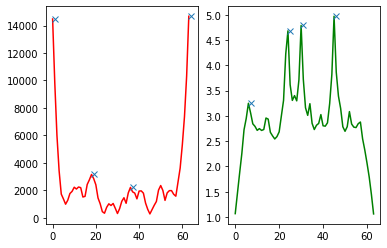

3311
peaked


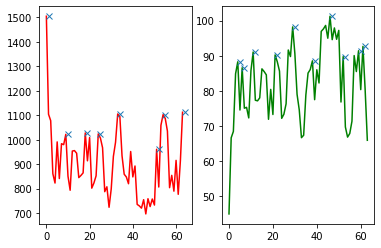

3337
peaked


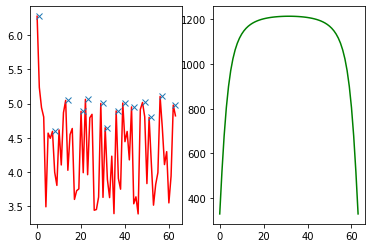

3358
peaked


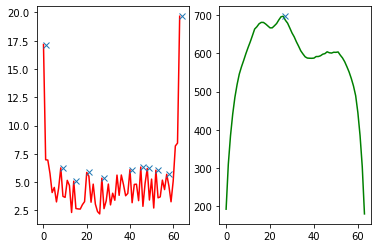

3375
peaked


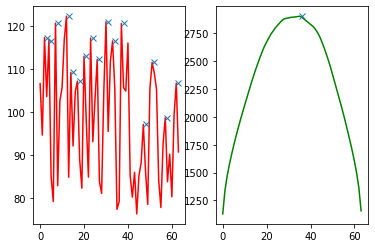

3465
peaked


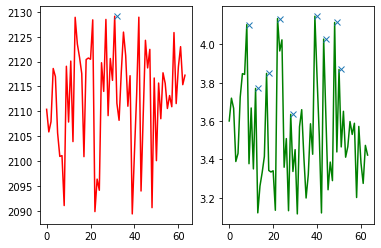

3539
peaked


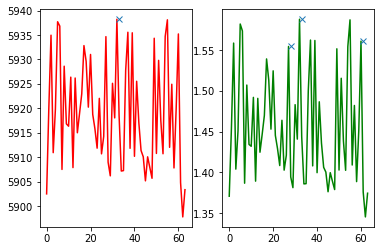

3704
peaked


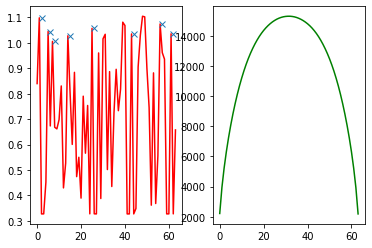

3736
peaked


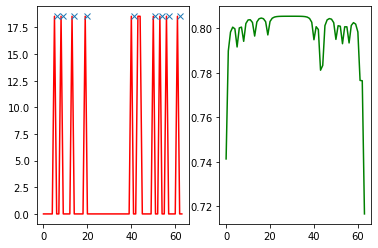

3744
peaked


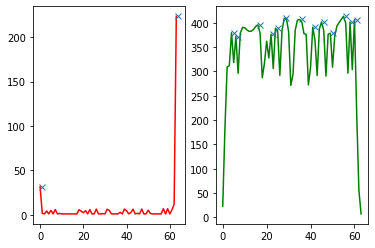

3790
peaked


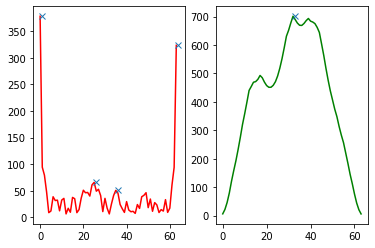

3805
peaked


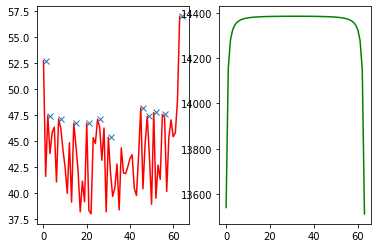

3832
peaked


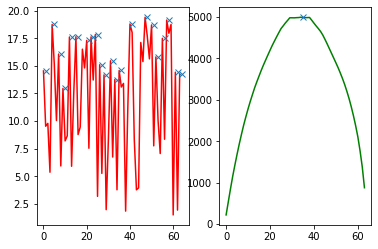

3837
peaked


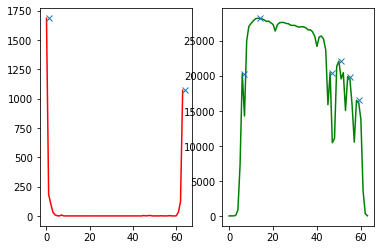

3872
peaked


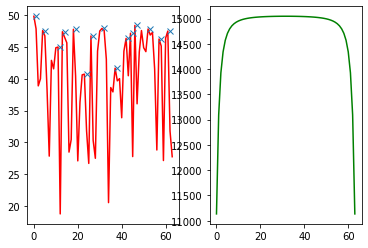

3891
peaked


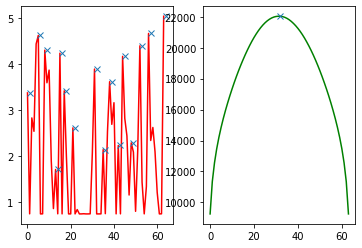

4049
peaked


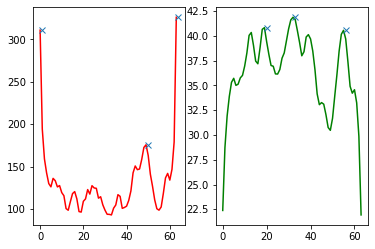

4066
peaked


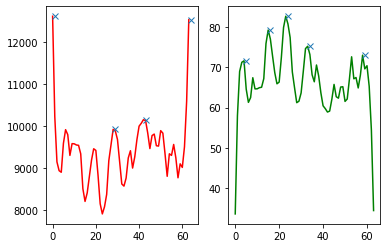

4297
peaked


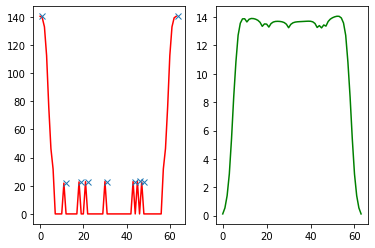

4378
peaked


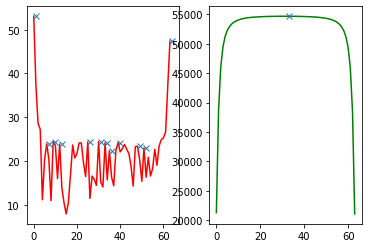

4562
peaked


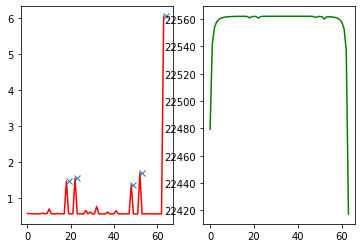

4654
peaked


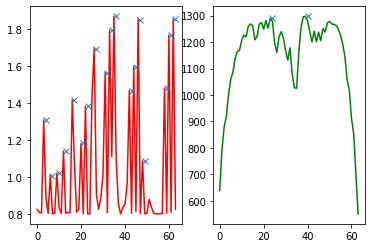

4678
peaked


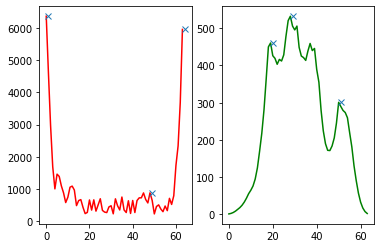

4725
peaked


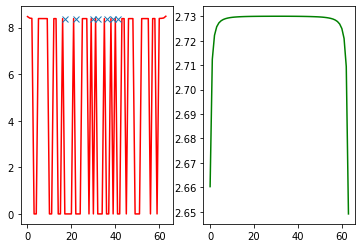

4731
peaked


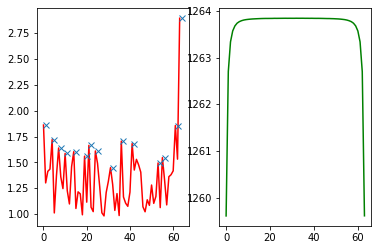

4781
peaked


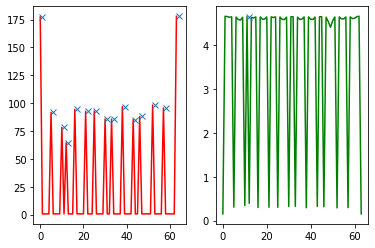

4807
peaked


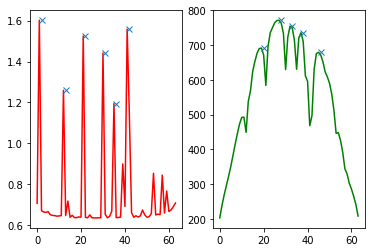

4961
peaked


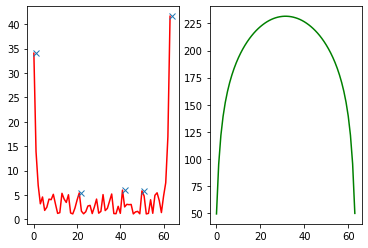

4973
peaked


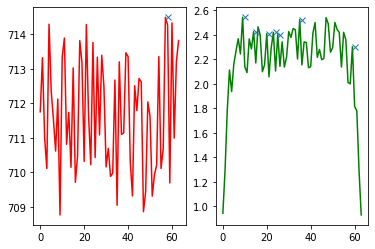

4978
peaked


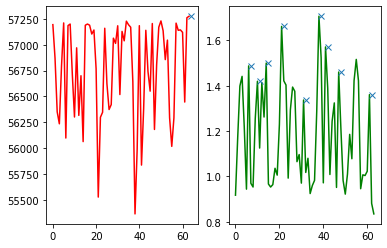

4987
peaked


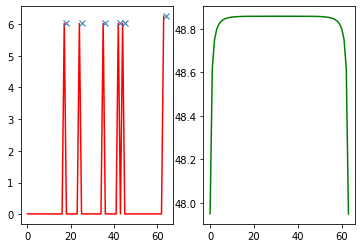

5009
peaked


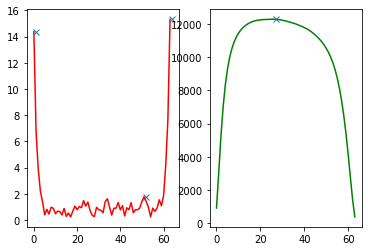

5070
peaked


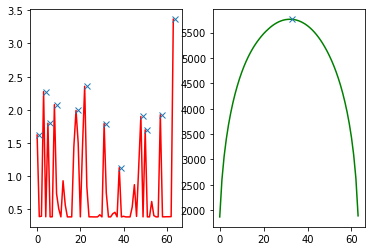

5095
peaked


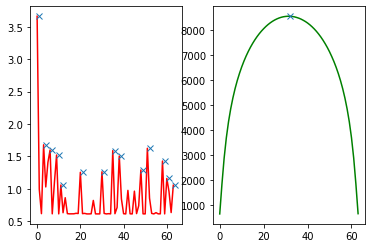

5110
peaked


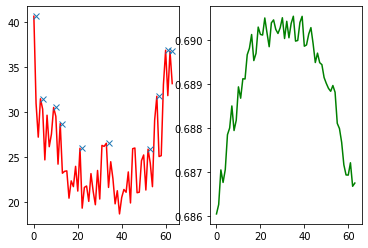

5135
peaked


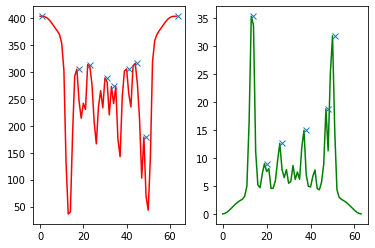

5163
peaked


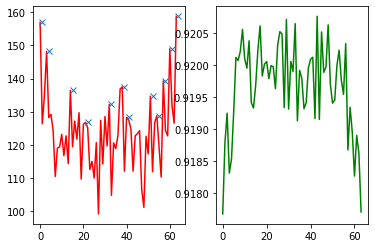

5255
peaked


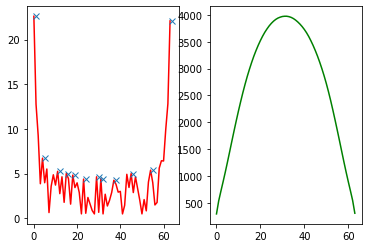

5295
peaked


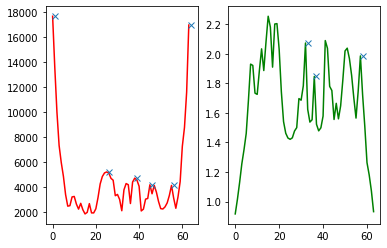

5296
peaked


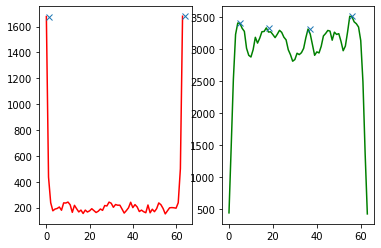

5436
peaked


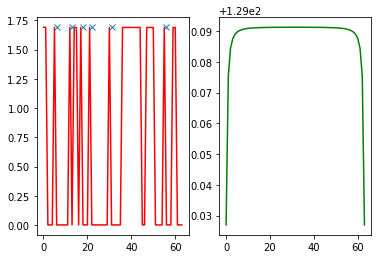

5448
peaked


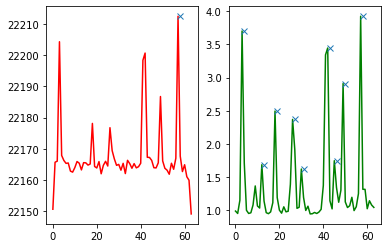

5478
peaked


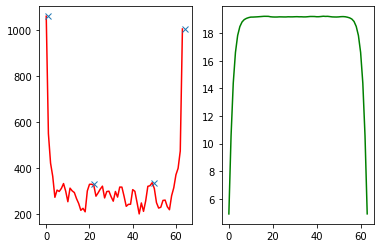

5513
peaked


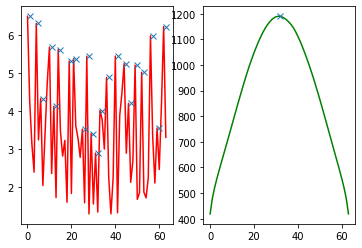

5525
peaked


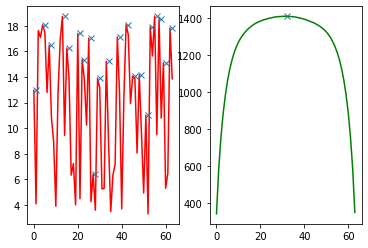

5536
peaked


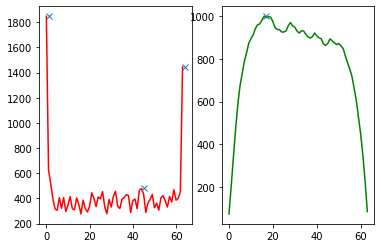

5622
peaked


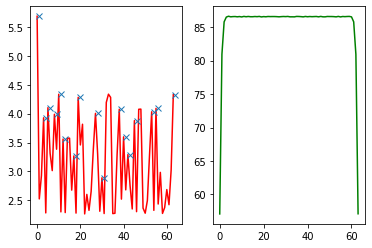

5716
peaked


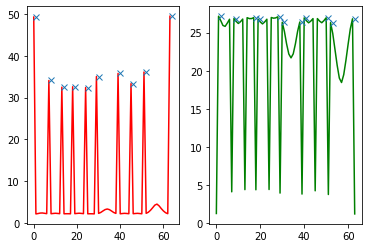

5815
peaked


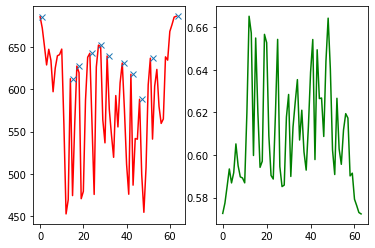

5987
peaked


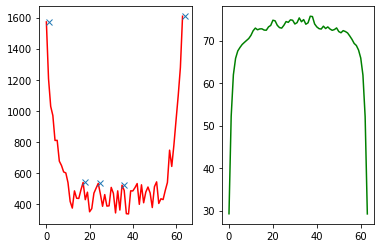

6137
peaked


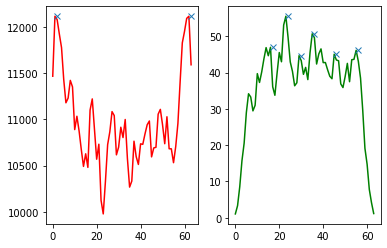

6144
peaked


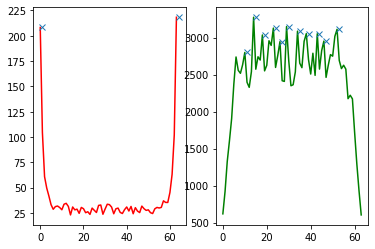

6176
peaked


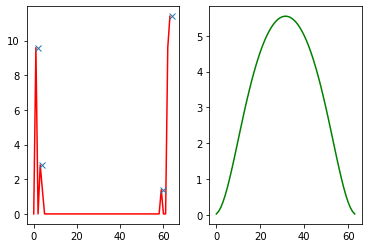

6205
peaked


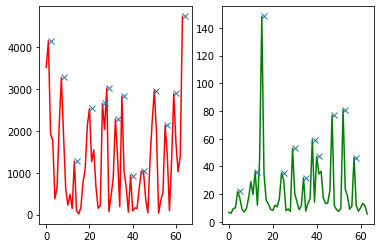

6240
peaked


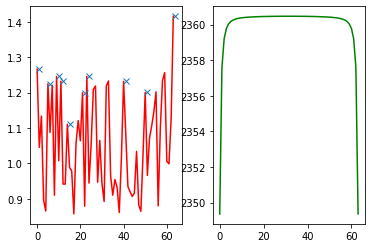

6389
peaked


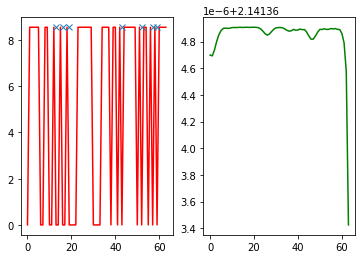

6415
peaked


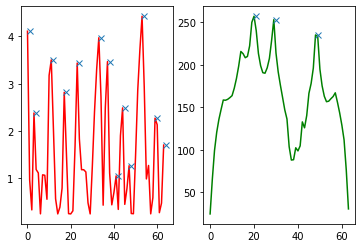

6557
peaked


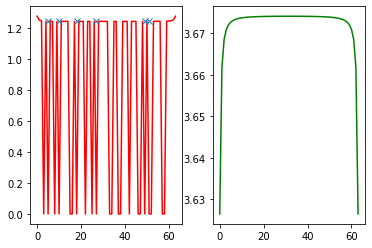

6660
peaked


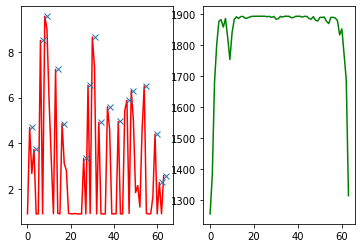

6667
peaked


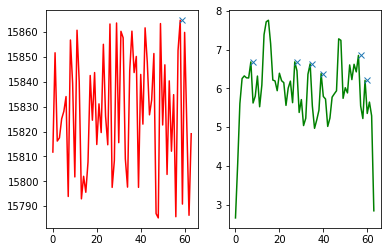

6748
peaked


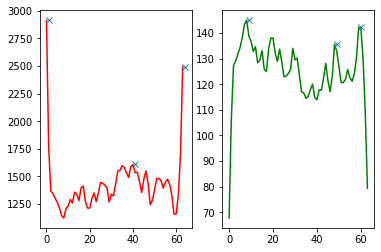

6774
peaked


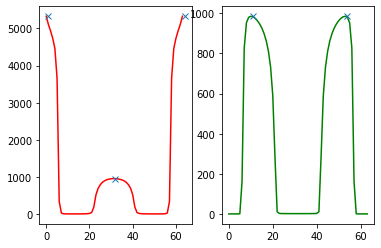

6825
peaked


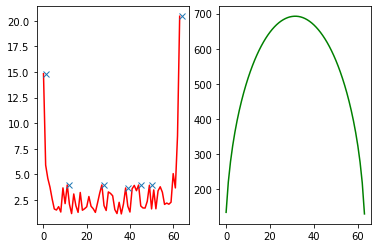

6873
peaked


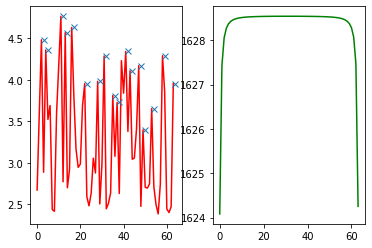

6960
peaked


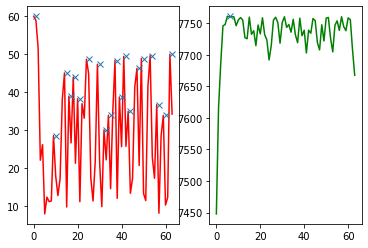

7003
peaked


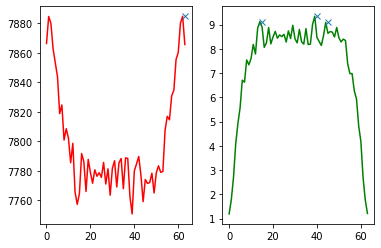

7029
peaked


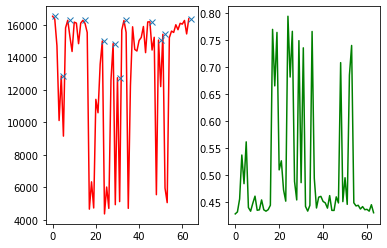

7124
peaked


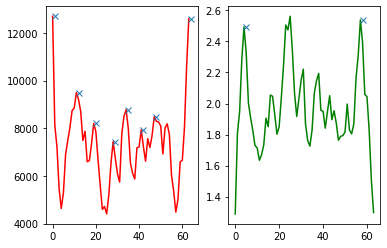

7237
peaked


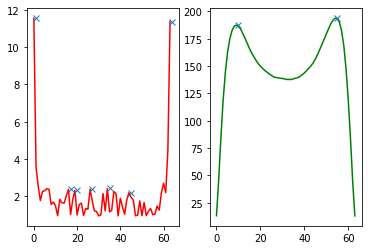

7243
peaked


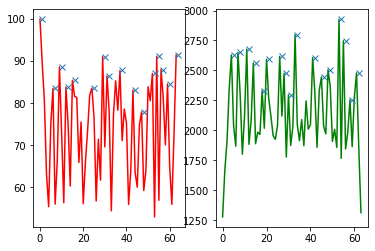

7446
peaked


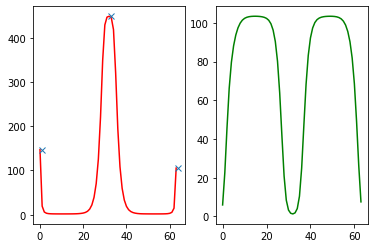

7481
peaked


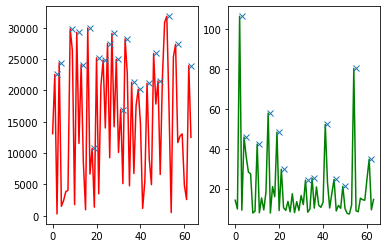

7512
peaked


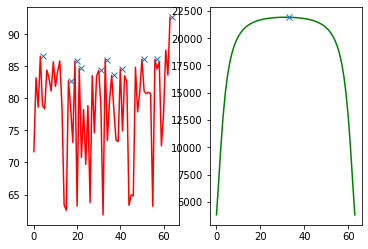

7625
peaked


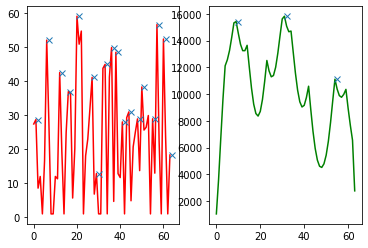

7650
peaked


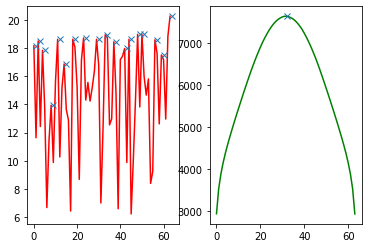

7672
peaked


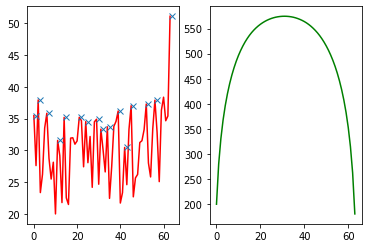

7680
peaked


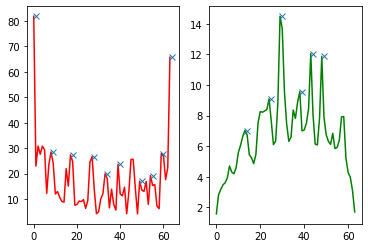

7759
peaked


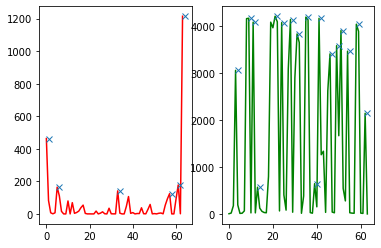

7911
peaked


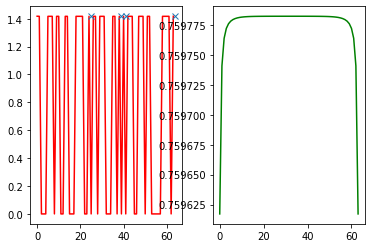

7915
peaked


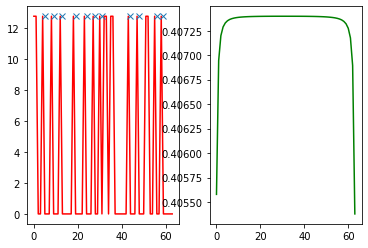

7916
peaked


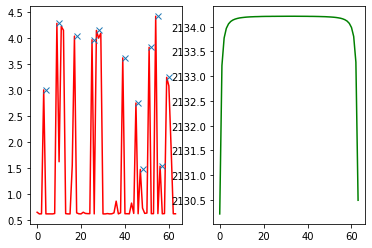

8044
peaked


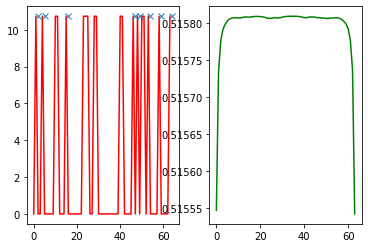

8065
peaked


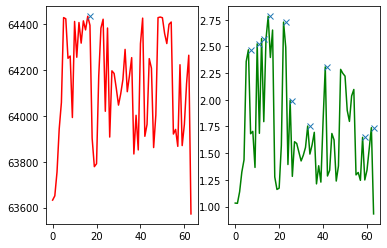

8232
peaked


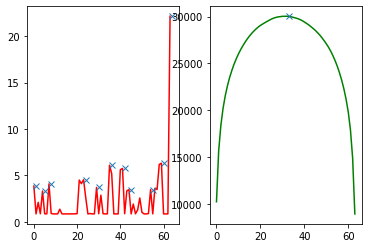

8269
peaked


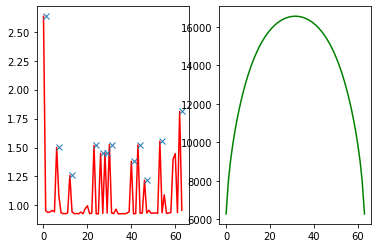

8290
peaked


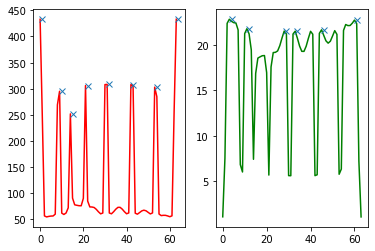

8307
peaked


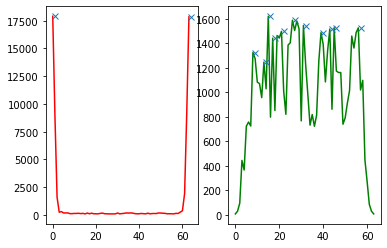

8310
peaked


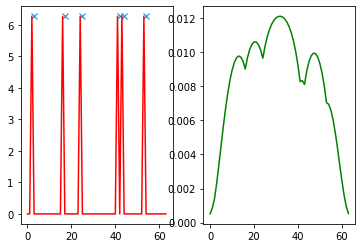

8353
peaked


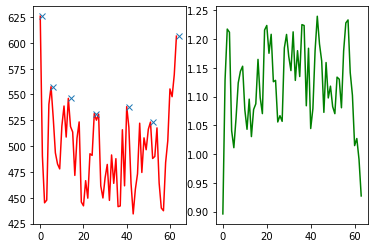

8416
peaked


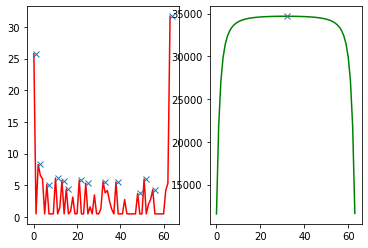

8468
peaked


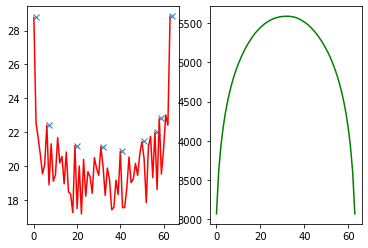

8483
peaked


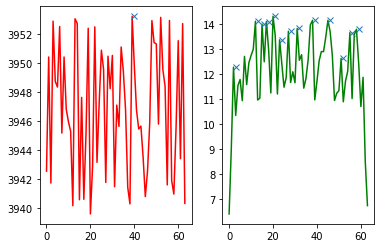

8497
peaked


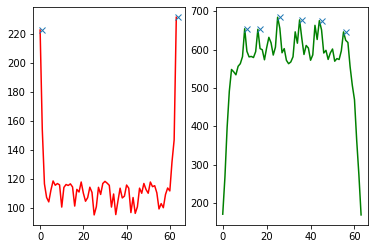

8507
peaked


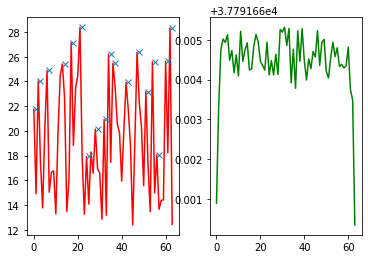

8569
peaked


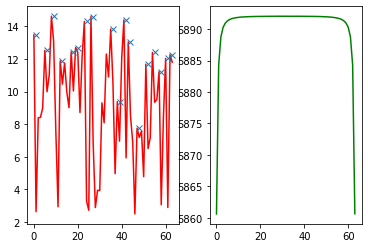

8616
peaked


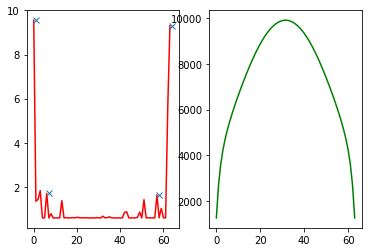

8720
peaked


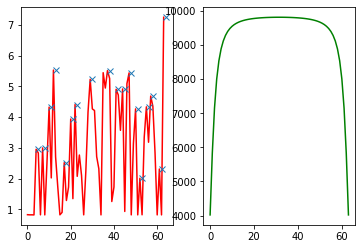

8737
peaked


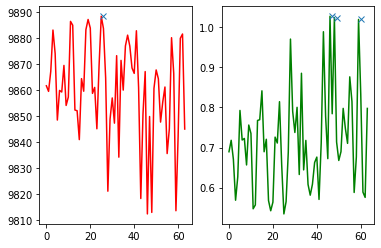

8743
peaked


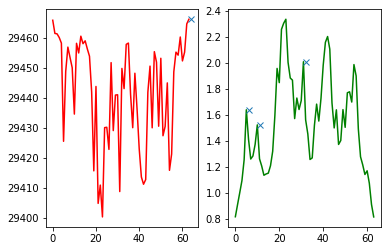

8758
peaked


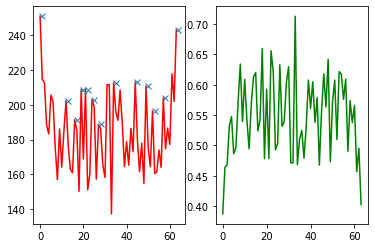

8777
peaked


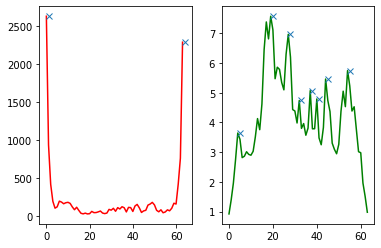

8781
peaked


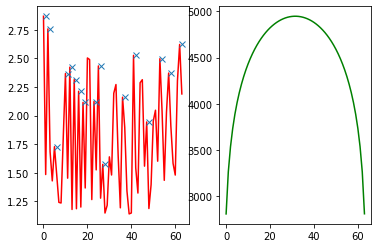

8827
peaked


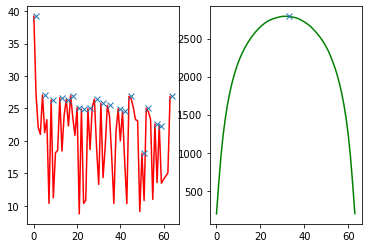

9163
peaked


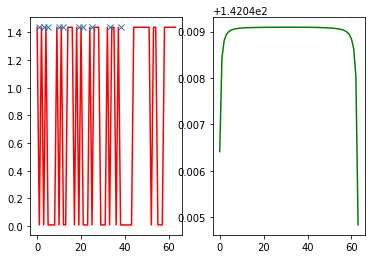

9188
peaked


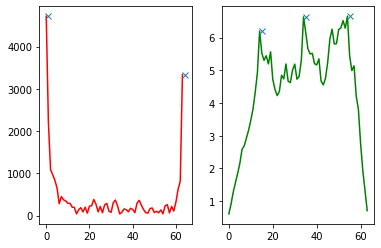

9189
peaked


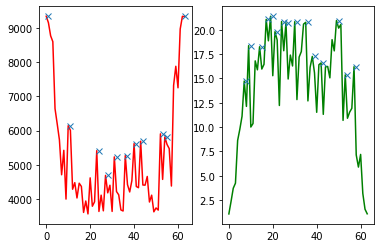

9223
peaked


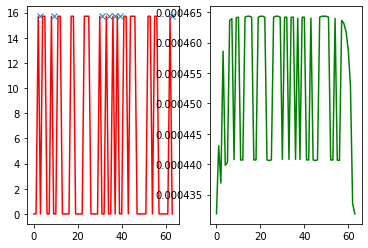

9224
peaked


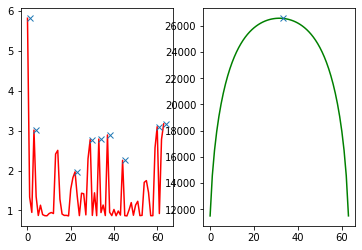

9238
peaked


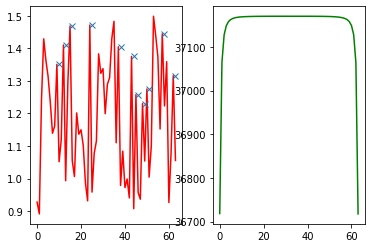

9266
peaked


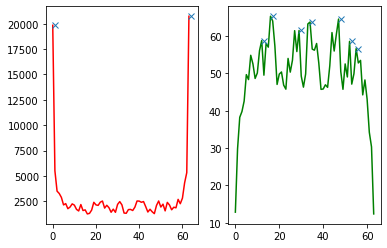

9284
peaked


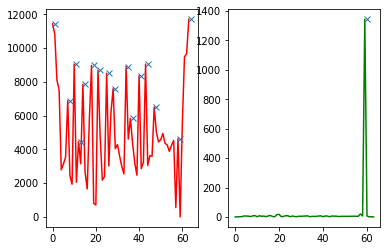

9289
peaked


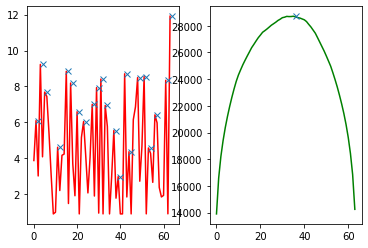

9348
peaked


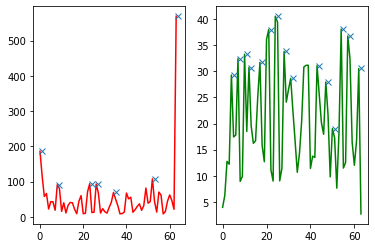

9357
peaked


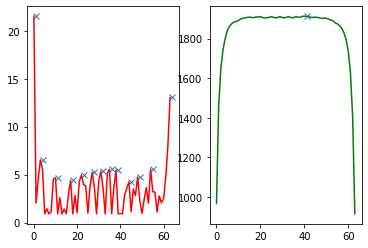

9462
peaked


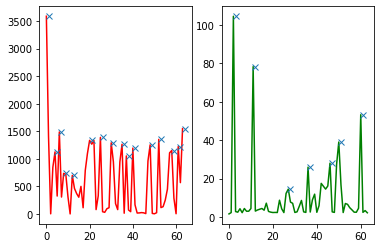

9477
peaked


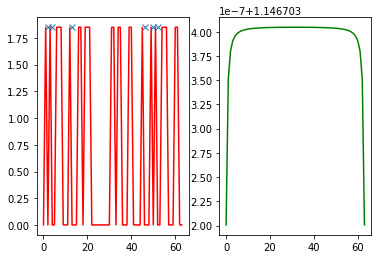

9493
peaked


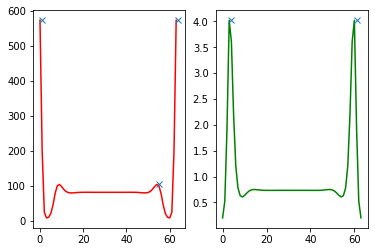

9499
peaked


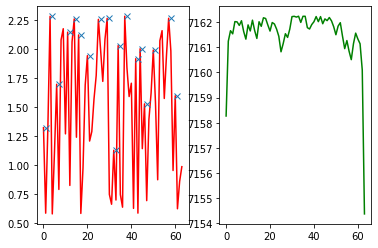

9503
peaked


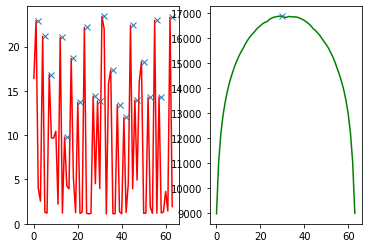

9513
peaked


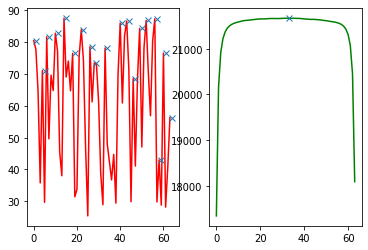

9563
peaked


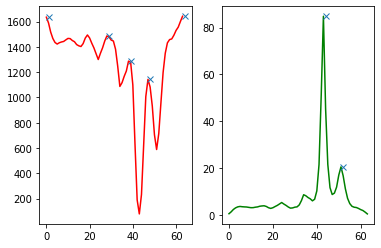

9577
peaked


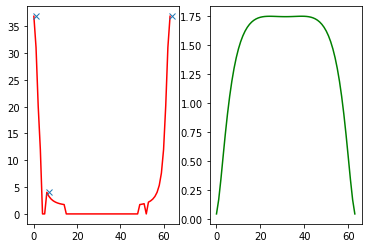

9657
peaked


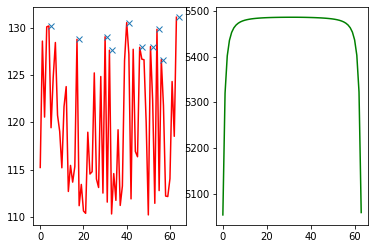

9661
peaked


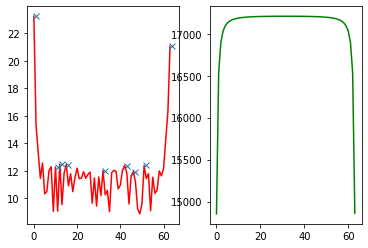

9693
peaked


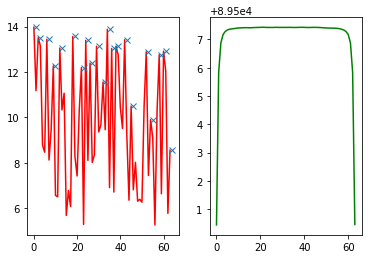

9752
peaked


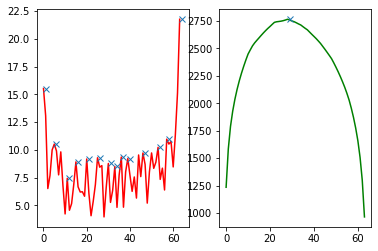

9843
peaked


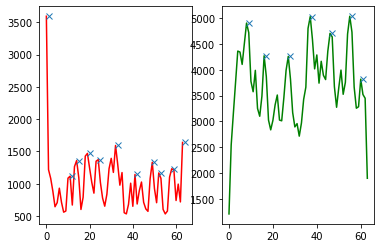

9885
peaked


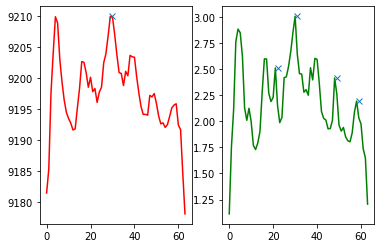

9968
peaked


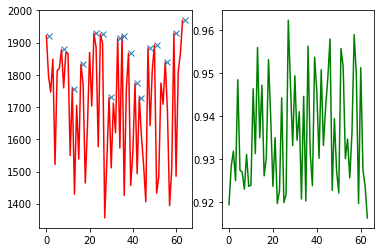

9979
peaked


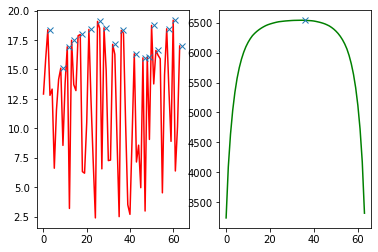

In [19]:
# stripped_parID = []
# nonstripped_parID = []
    
for parID in stripped_parID:
    filename = 'final_circuit%r_variant%r_boundary%r_%s_%sID%r_L%r_J%r_T%r_N%r'%(circuit_n,variant,boundary_coef, shape,mechanism,parID,L,J,T,N)
    simulation = pickle.load( open( modelling_ephemeral + '/3954/numerical_confocal/results/simulation/1M_df_fullcircuit/1D%s.pkl'%filename, "rb" ) ) 
    peaks_n = plot_peaks(simulation,parID,print_stripped=True)
#     if np.amax(peaks_n) > 2:
#         stripped_parID.append(parID)
#     else:
#         nonstripped_parID.append(parID)

In [23]:
pickle.dump( nonstripped_parID, open( "%s_boundary%r_nonstripped_parID_10000.pkl"%(shape,boundary_coef), "wb" ) )
pickle.dump( stripped_parID, open( "%s_boundary%r_stripped_parID_10000.pkl"%(shape,boundary_coef), "wb" ) )



# No growth + Closed boundary

In [24]:
boundary_coef=0
shape='no_growth'
mechanism = 'general'
L,T,J,N = [8,100,64,12600]



In [25]:
nonstripped_parID = pickle.load( open( "%s_boundary%r_nonstripped_parID_%r.pkl"%(shape,boundary_coef,parametersets_n), "rb" ) ) 
stripped_parID  = pickle.load( open( "%s_boundary%r_stripped_parID_%r.pkl"%(shape,boundary_coef,parametersets_n), "rb" ) ) 


general_df['no_growth_0'] = general_df.apply (lambda row: define_column(row,stripped_parID), axis=1)



26
peaked


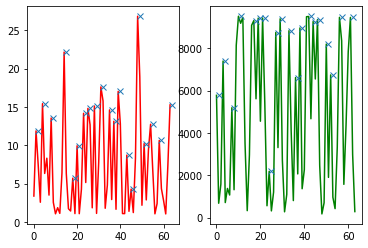

108
peaked


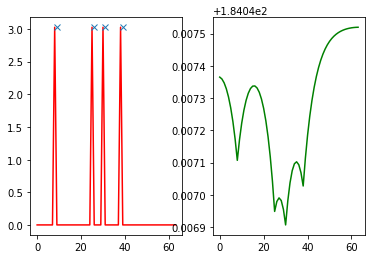

119
peaked


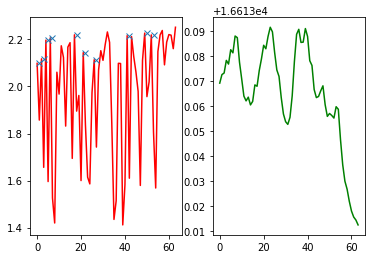

127
peaked


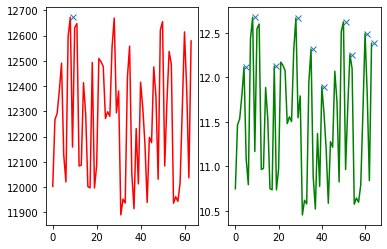

158
peaked


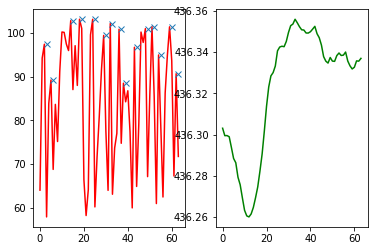

172
peaked


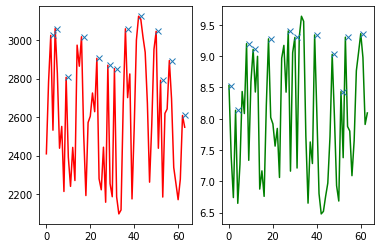

282
peaked


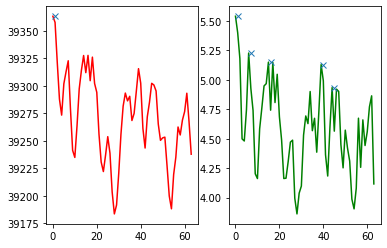

292
peaked


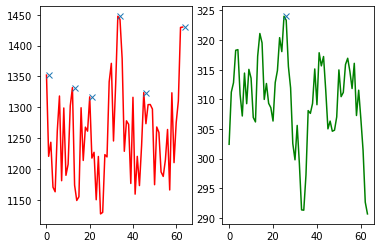

322
peaked


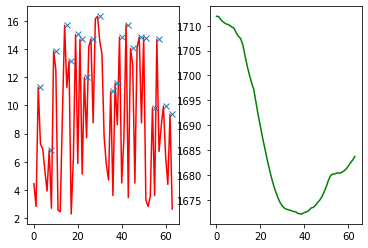

330
peaked


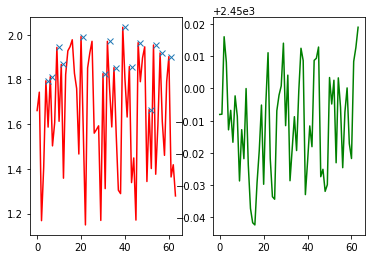

382
peaked


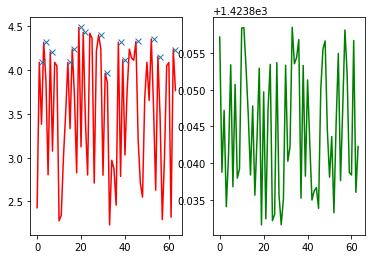

414
peaked


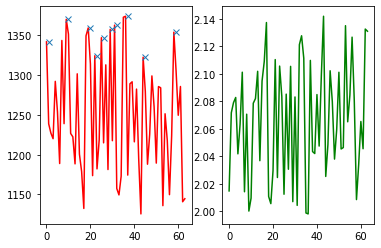

426
peaked


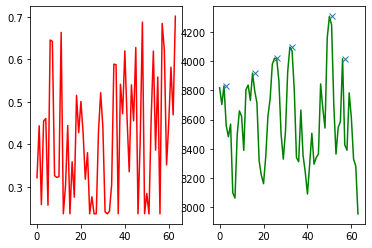

433
peaked


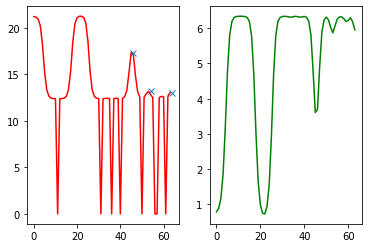

513
peaked


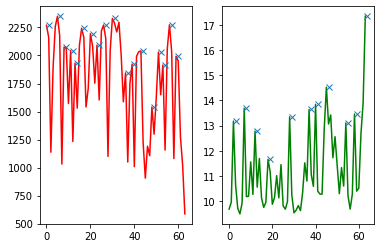

514
peaked


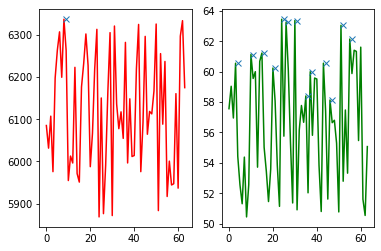

522
peaked


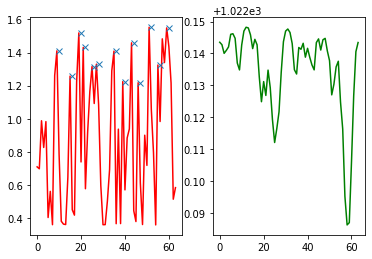

532
peaked


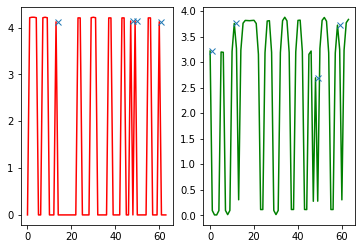

539
peaked


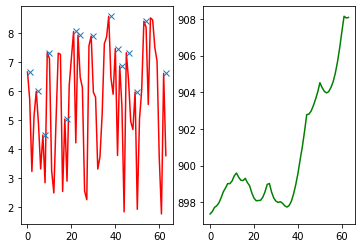

543
peaked


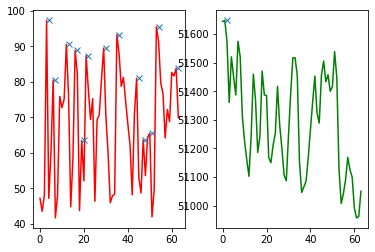

545
peaked


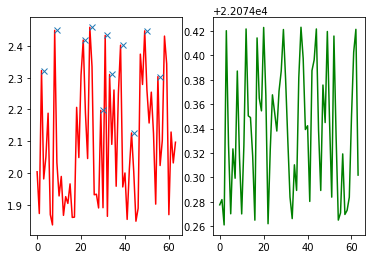

550
peaked


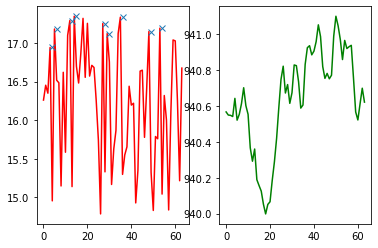

594
peaked


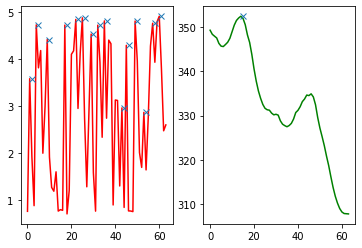

600
peaked


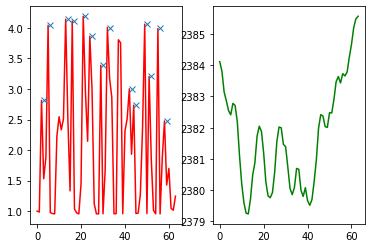

605
peaked


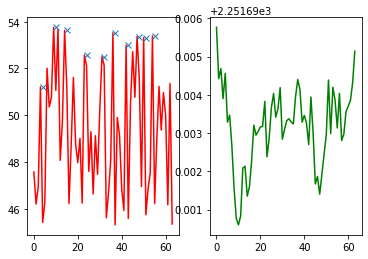

643
peaked


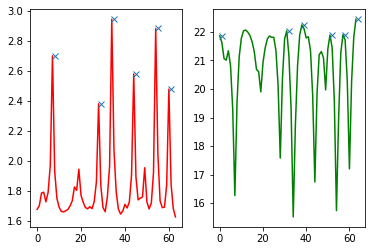

663
peaked


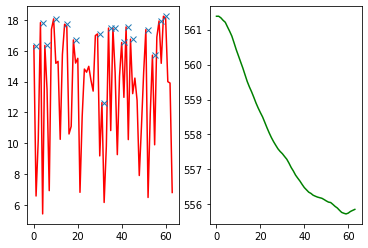

696
peaked


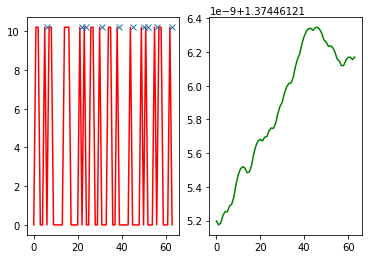

710
peaked


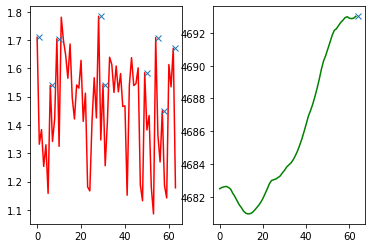

758
peaked


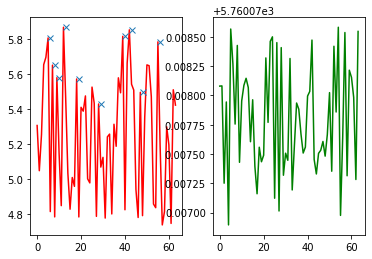

797
peaked


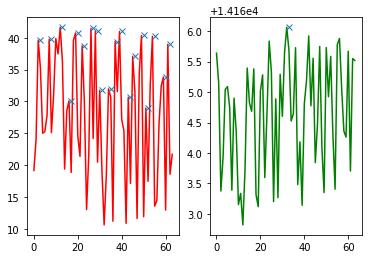

799
peaked


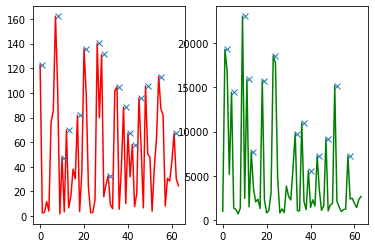

821
peaked


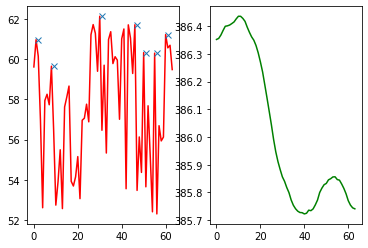

831
peaked


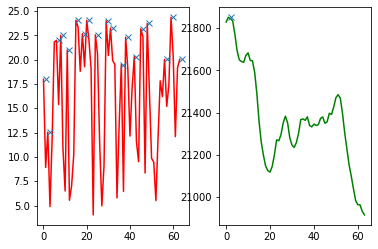

907
peaked


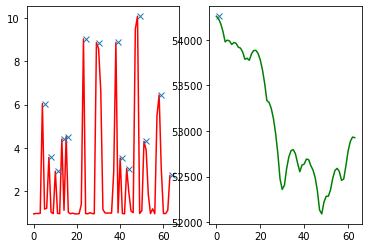

983
peaked


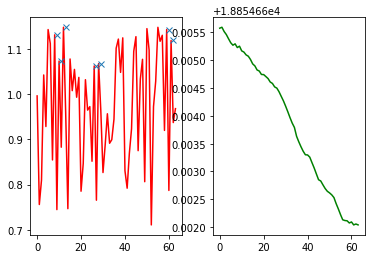

994
peaked


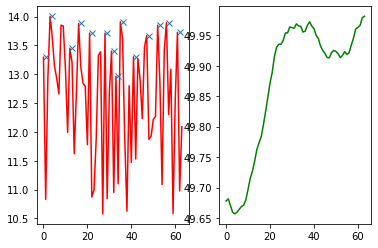

1024
peaked


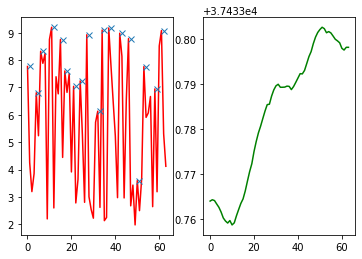

1028
peaked


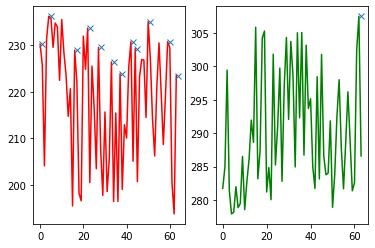

1029
peaked


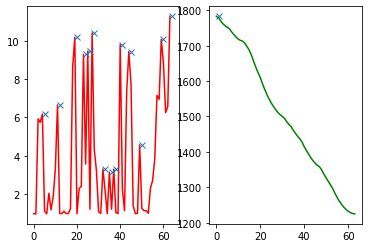

1040
peaked


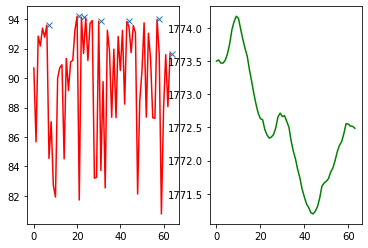

1073
peaked


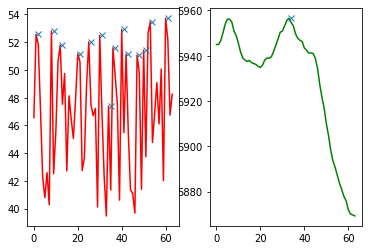

1169
peaked


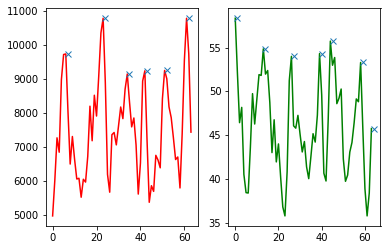

1170
peaked


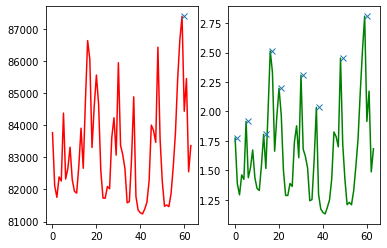

1311
peaked


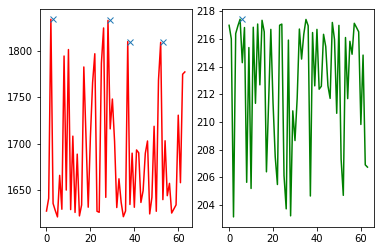

1328
peaked


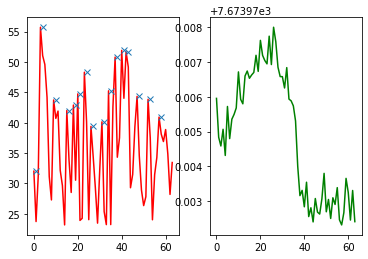

1360
peaked


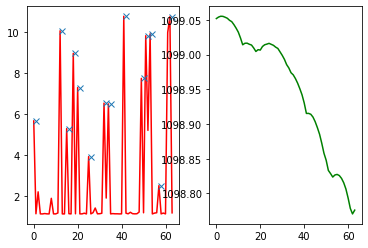

1391
peaked


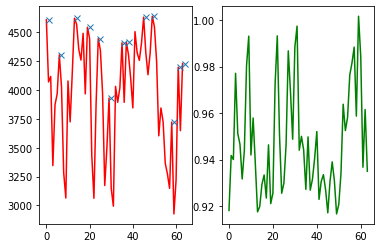

1404
peaked


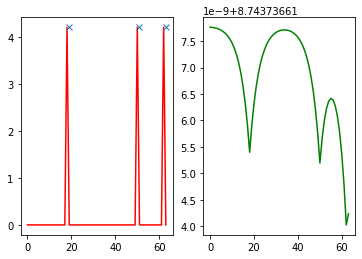

1414
peaked


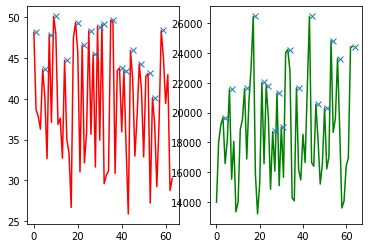

1459
peaked


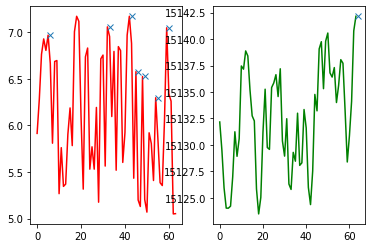

1475
peaked


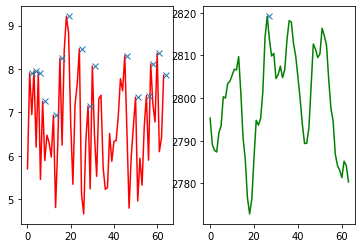

1511
peaked


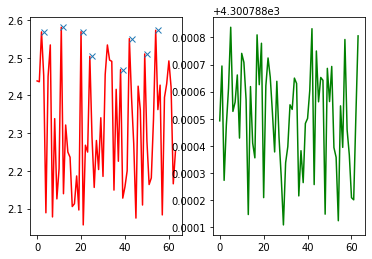

1560
peaked


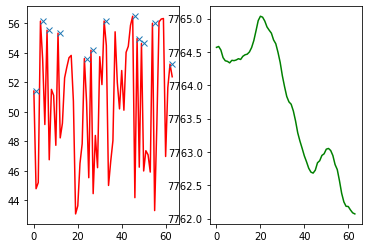

1640
peaked


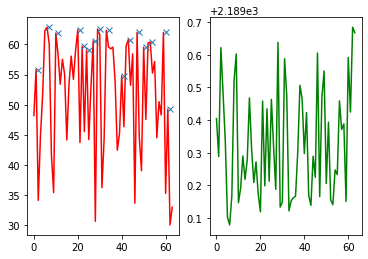

1709
peaked


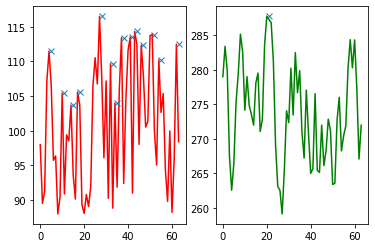

1718
peaked


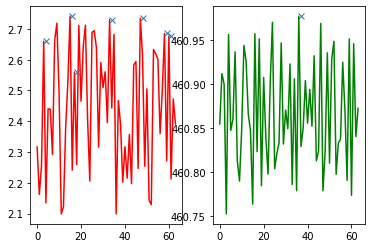

1797
peaked


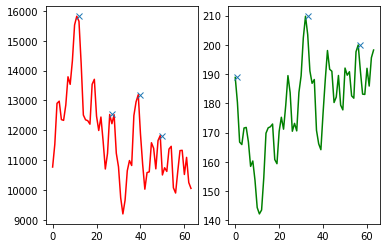

1928
peaked


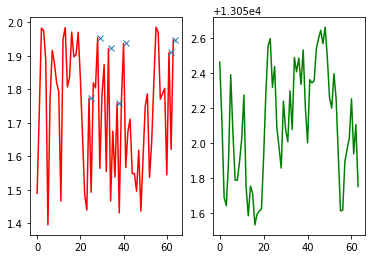

1955
peaked


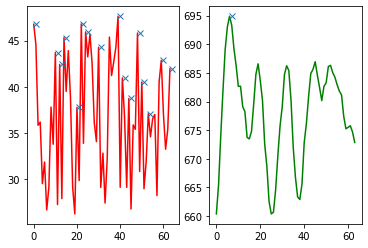

1965
peaked


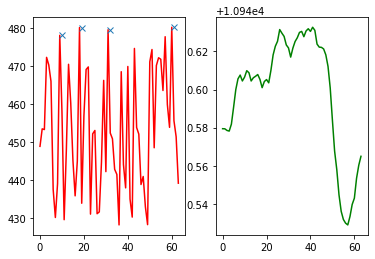

1980
peaked


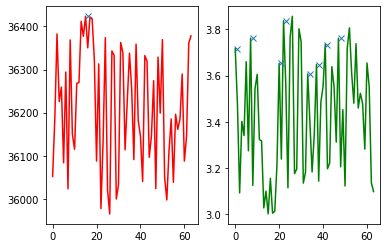

1990
peaked


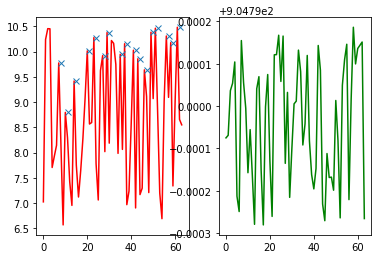

1996
peaked


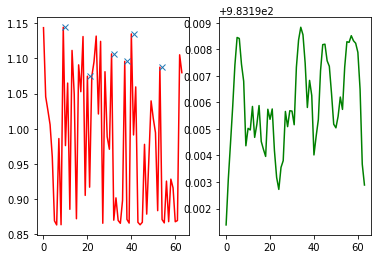

2001
peaked


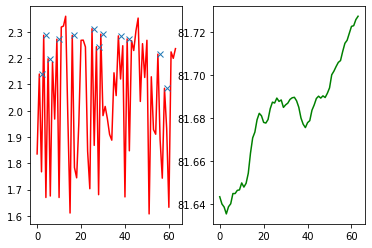

2005
peaked


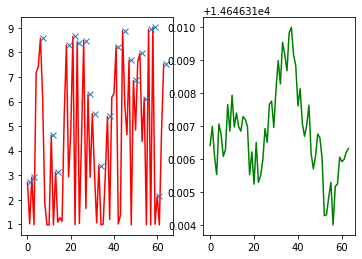

2008
peaked


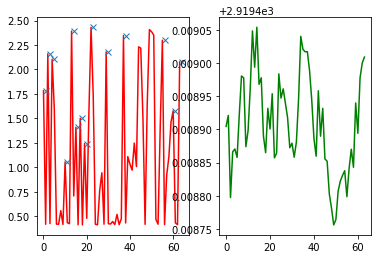

2037
peaked


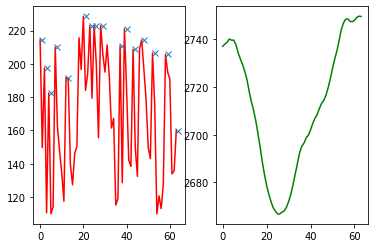

2039
peaked


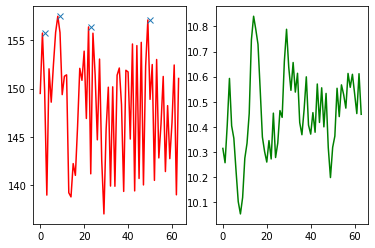

2053
peaked


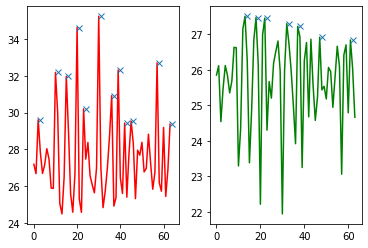

2111
peaked


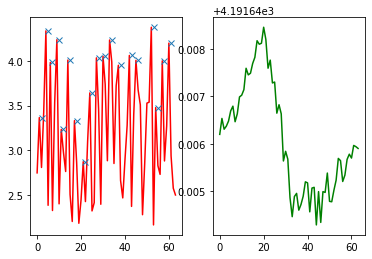

2160
peaked


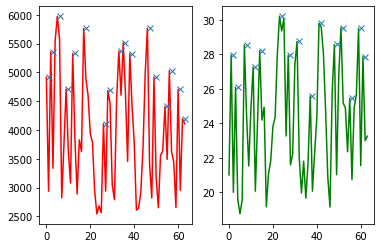

2173
peaked


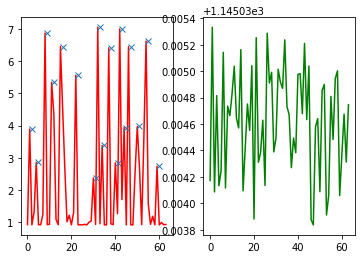

2185
peaked


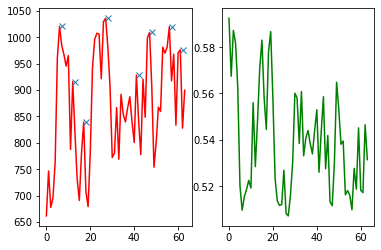

2199
peaked


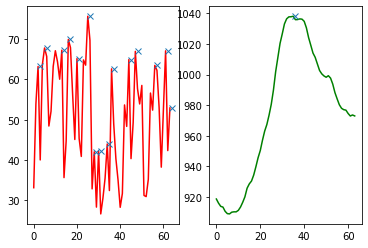

2288
peaked


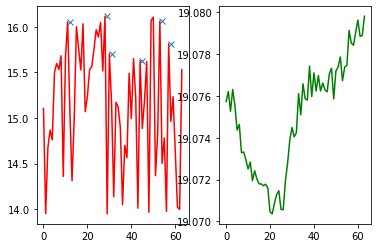

2300
peaked


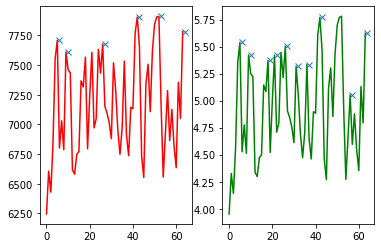

2306
peaked


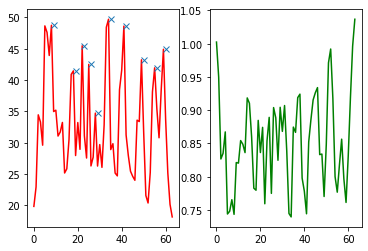

2326
peaked


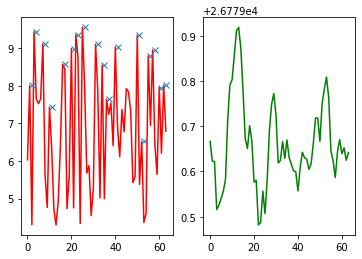

2387
peaked


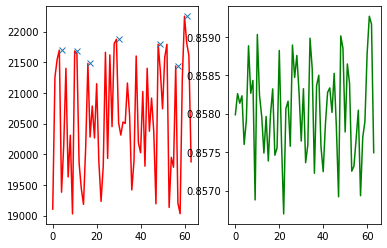

2459
peaked


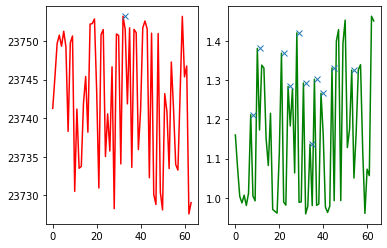

2522
peaked


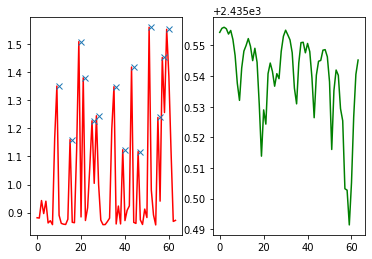

2681
peaked


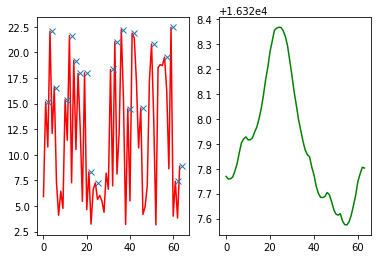

2690
peaked


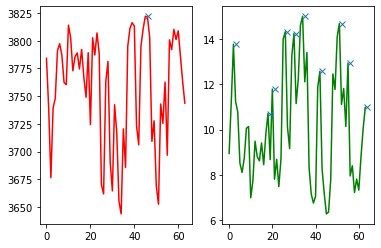

2698
peaked


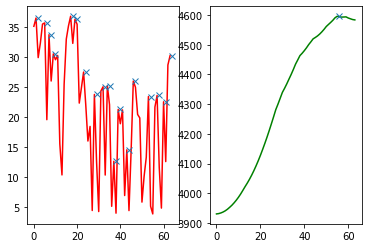

2802
peaked


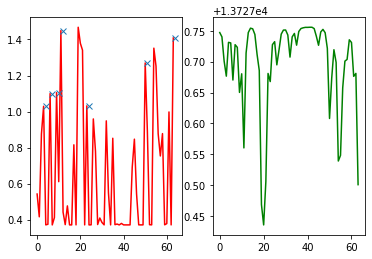

2817
peaked


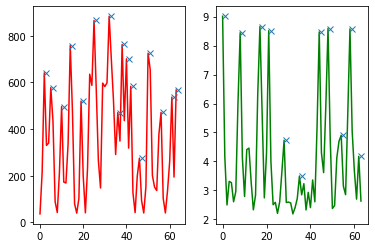

2838
peaked


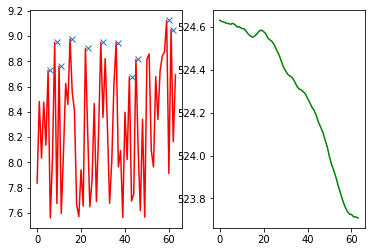

2852
peaked


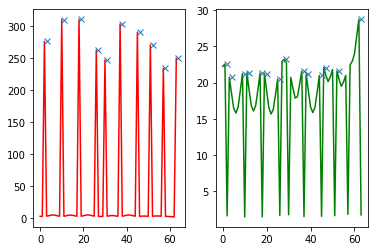

2905
peaked


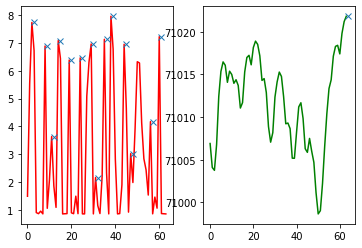

2954
peaked


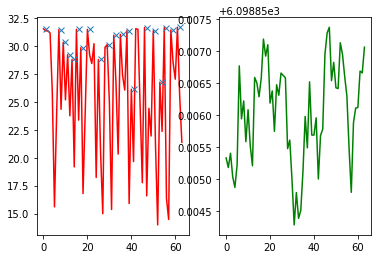

2989
peaked


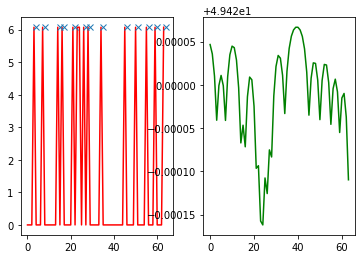

3043
peaked


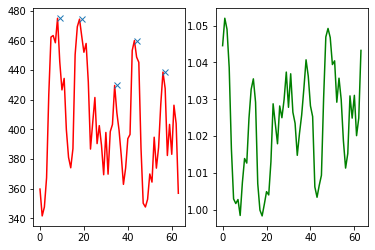

3117
peaked


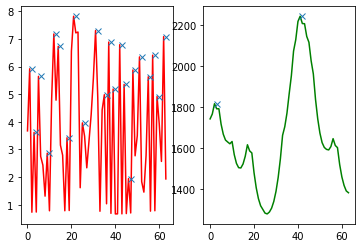

3183
peaked


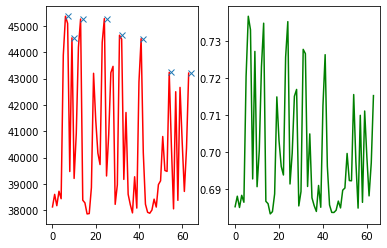

3190
peaked


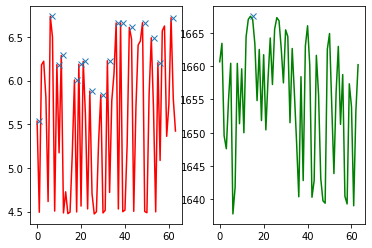

3191
peaked


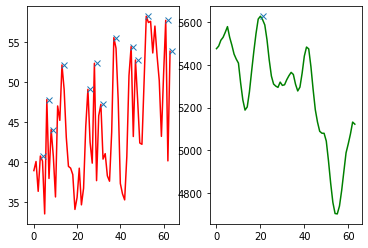

3212
peaked


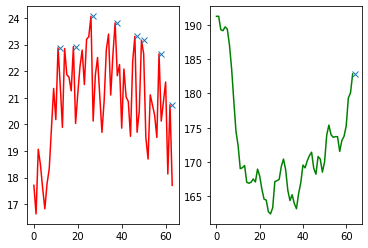

3232
peaked


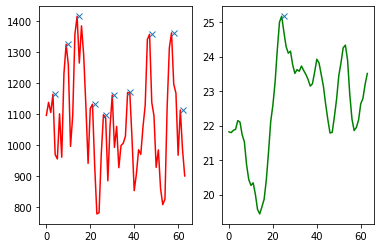

3243
peaked


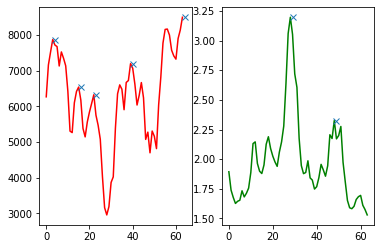

3270
peaked


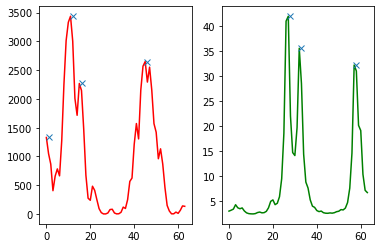

3293
peaked


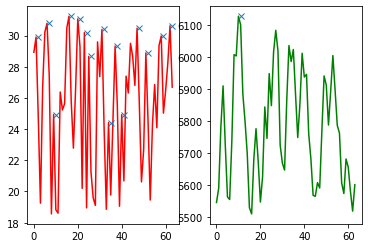

3311
peaked


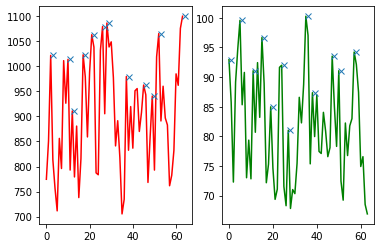

3312
peaked


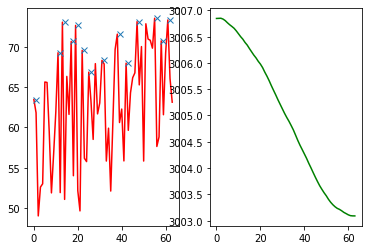

3317
peaked


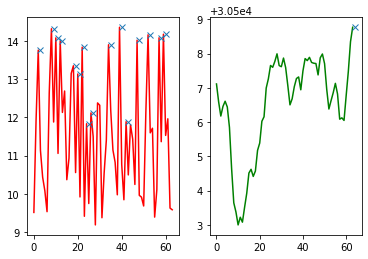

3337
peaked


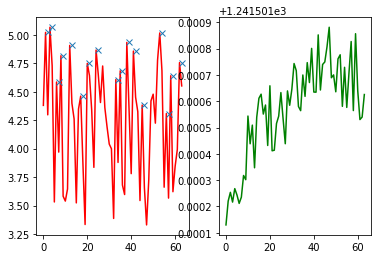

3358
peaked


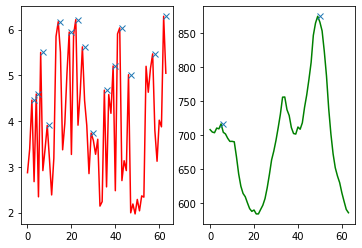

3375
peaked


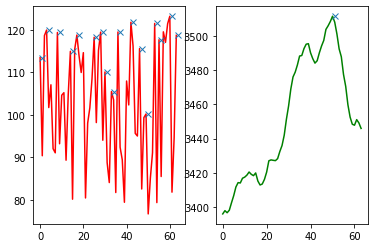

3465
peaked


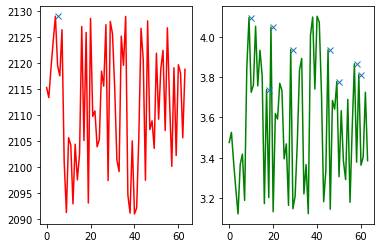

3507
peaked


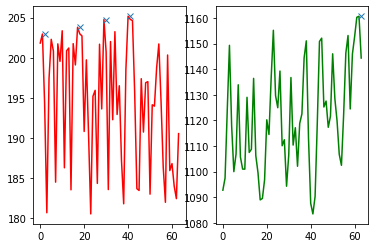

3508
peaked


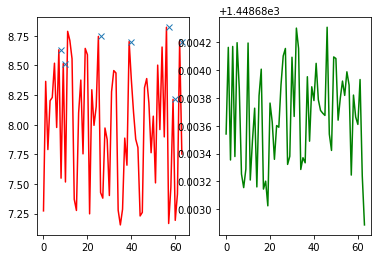

3607
peaked


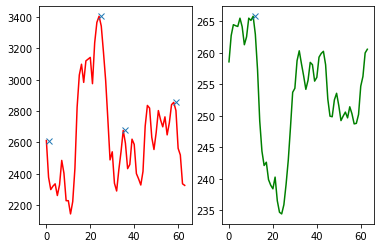

3704
peaked


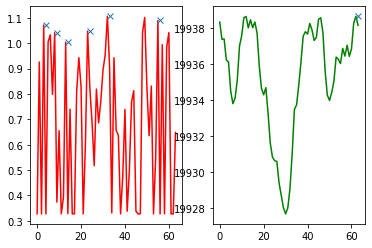

3736
peaked


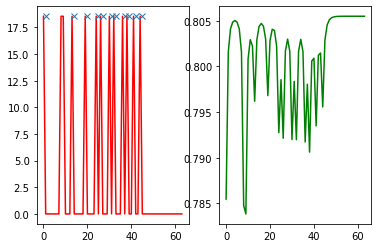

3744
peaked


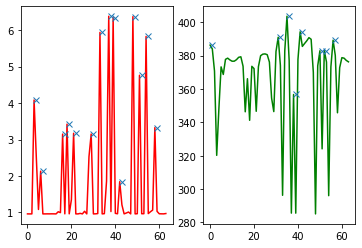

3752
peaked


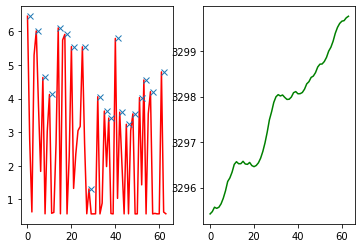

3777
peaked


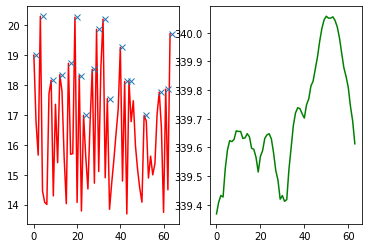

3790
peaked


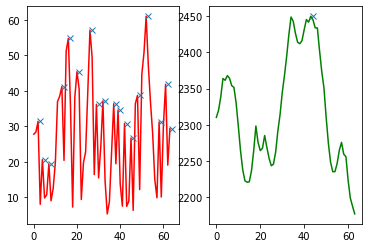

3805
peaked


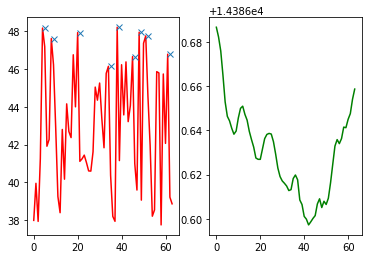

3832
peaked


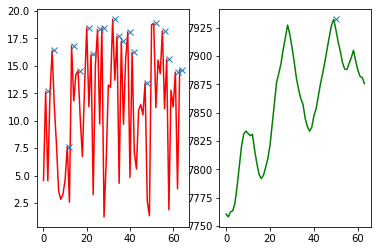

3837
peaked


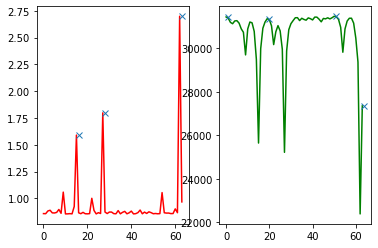

3872
peaked


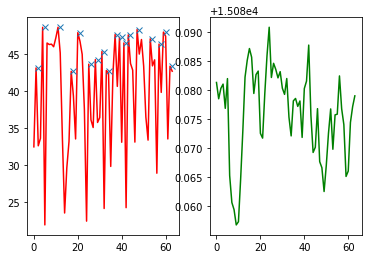

3891
peaked


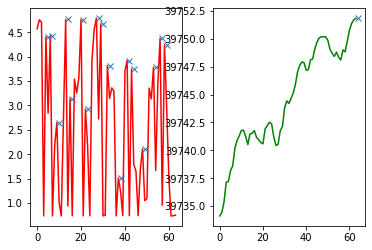

3954
peaked


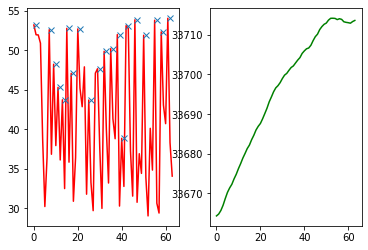

3989
peaked


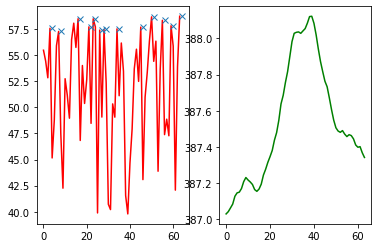

4049
peaked


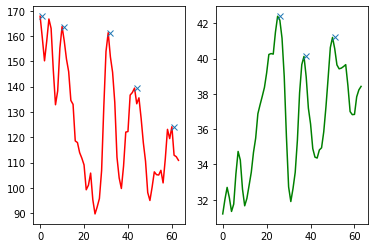

4066
peaked


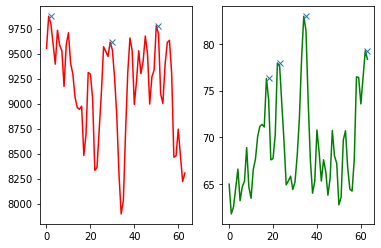

4105
peaked


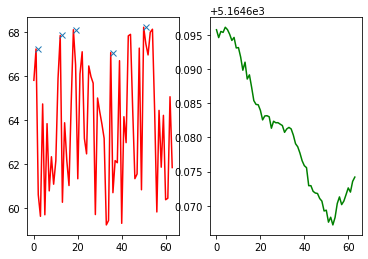

4135
peaked


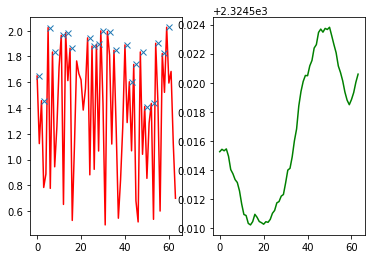

4229
peaked


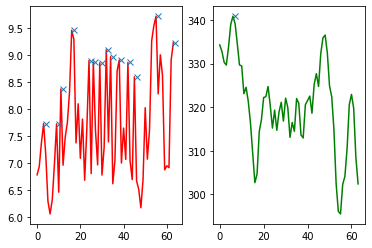

4257
peaked


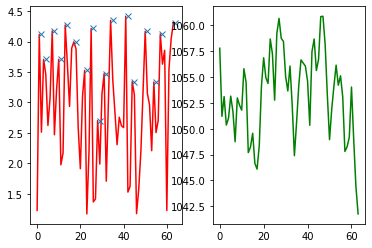

4273
peaked


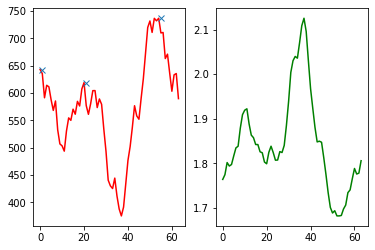

4297
peaked


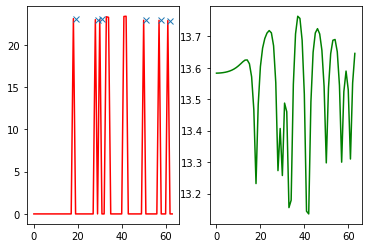

4378
peaked


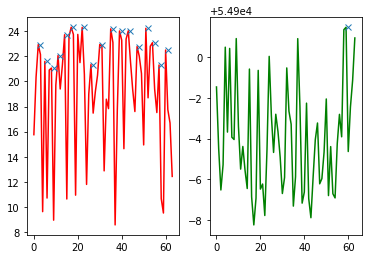

4440
peaked


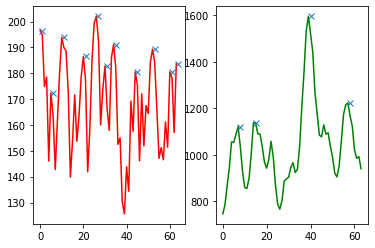

4465
peaked


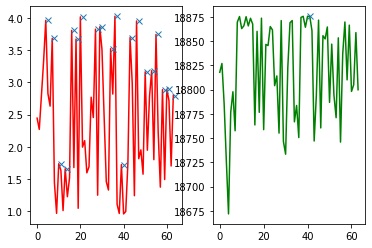

4484
peaked


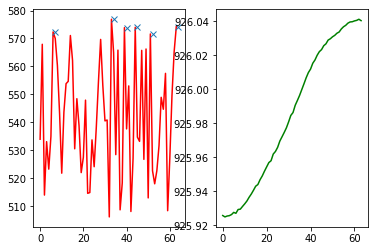

4510
peaked


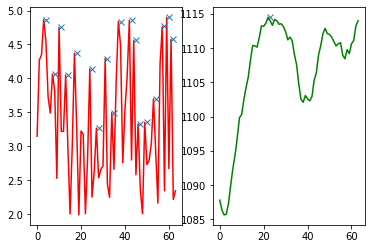

4562
peaked


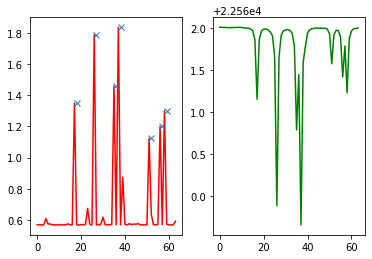

4587
peaked


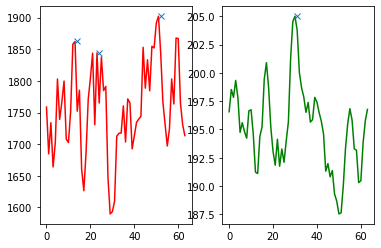

4653
peaked


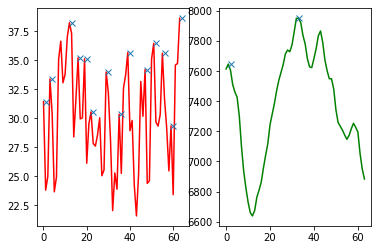

4654
peaked


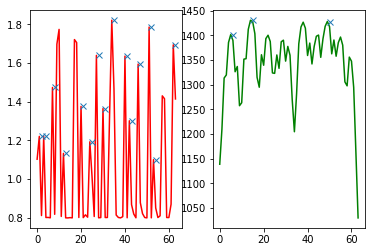

4666
peaked


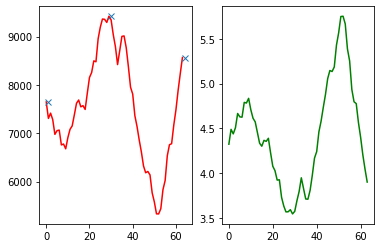

4678
peaked


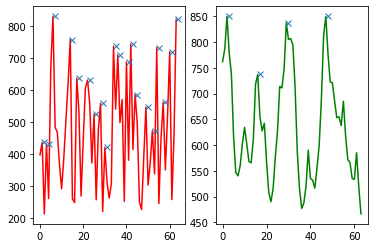

4731
peaked


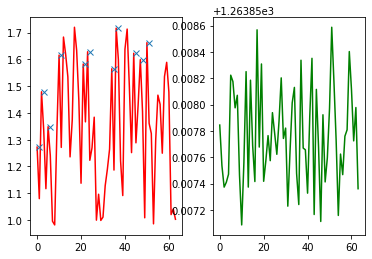

4781
peaked


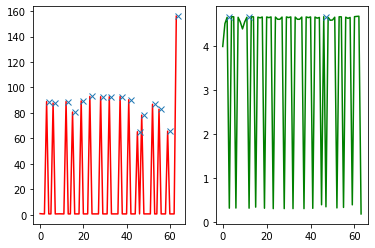

4807
peaked


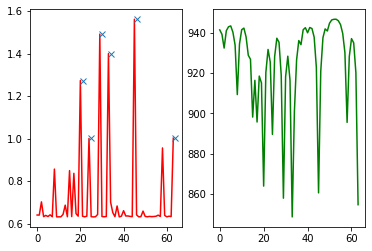

4875
peaked


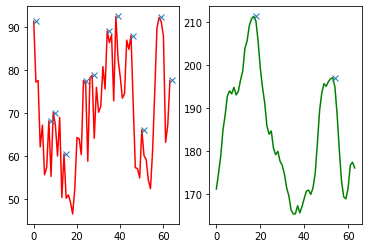

4903
peaked


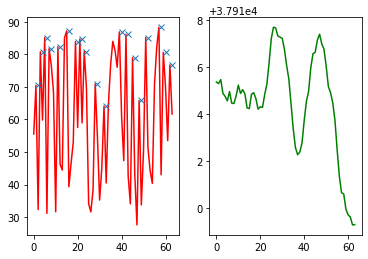

4961
peaked


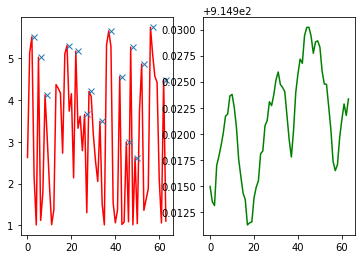

4973
peaked


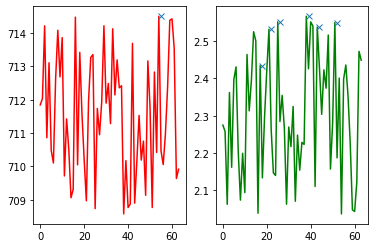

4978
peaked


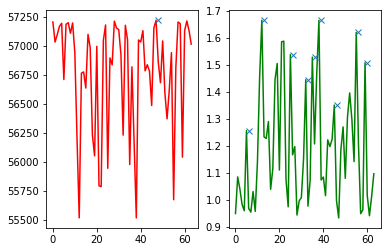

4987
peaked


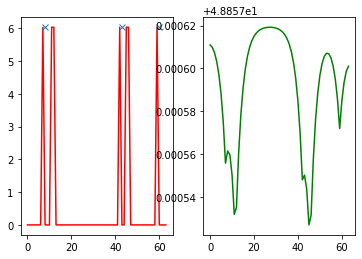

5007
peaked


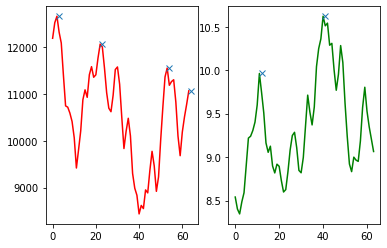

5009
peaked


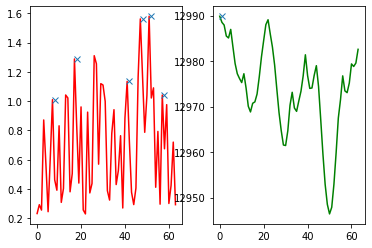

5014
peaked


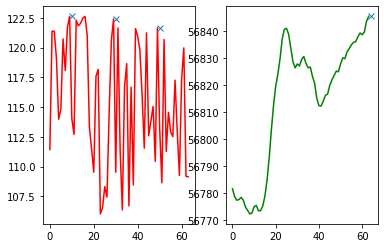

5055
peaked


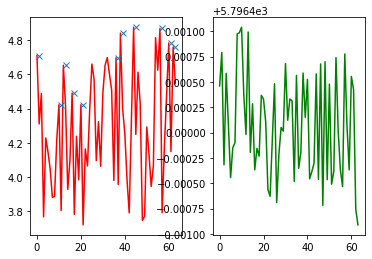

5070
peaked


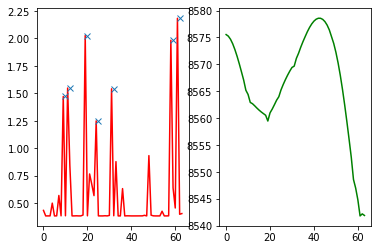

5077
peaked


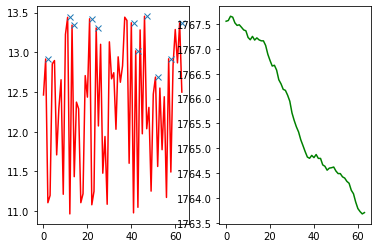

5095
peaked


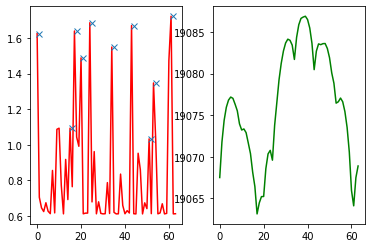

5110
peaked


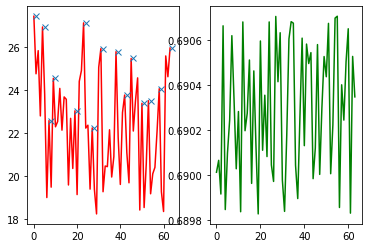

5135
peaked


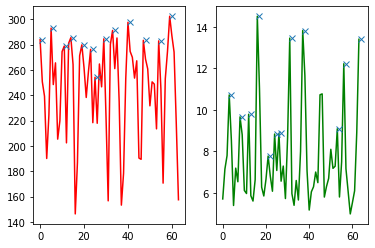

5163
peaked


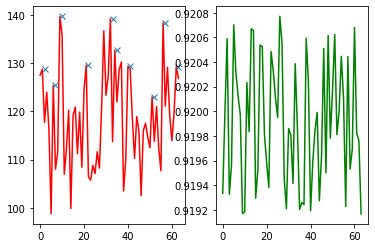

5255
peaked


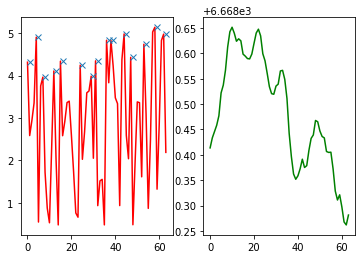

5263
peaked


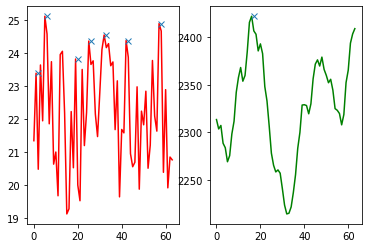

5295
peaked


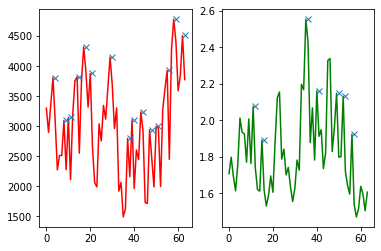

5296
peaked


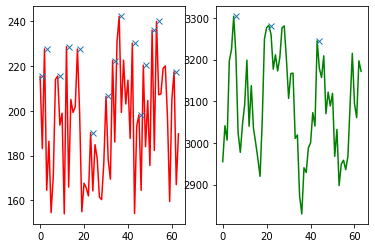

5436
peaked


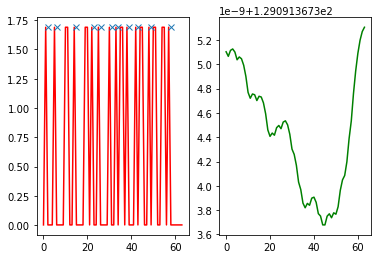

5448
peaked


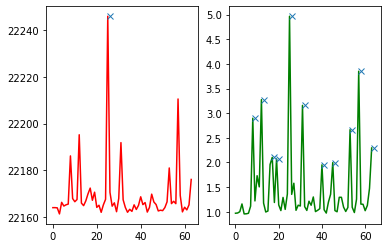

5478
peaked


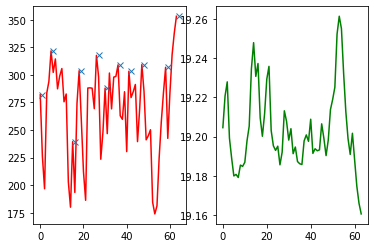

5480
peaked


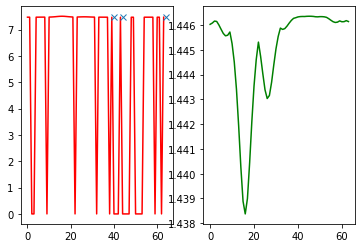

5497
peaked


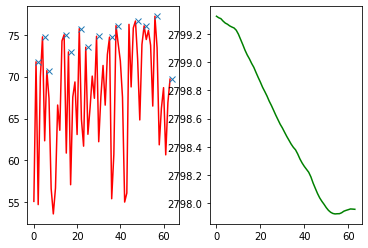

5500
peaked


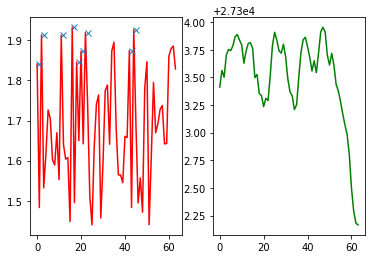

5513
peaked


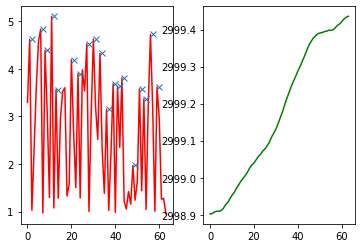

5525
peaked


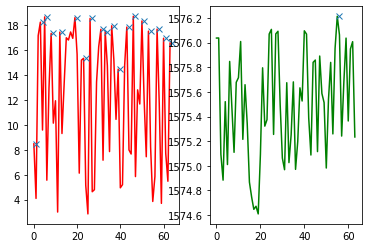

5536
peaked


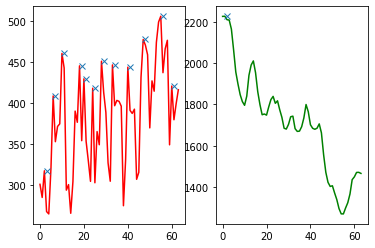

5550
peaked


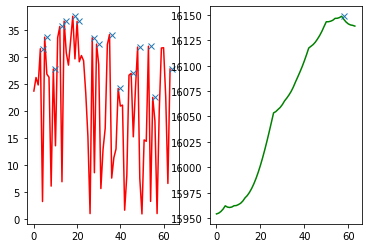

5622
peaked


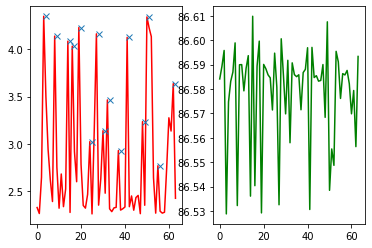

5714
peaked


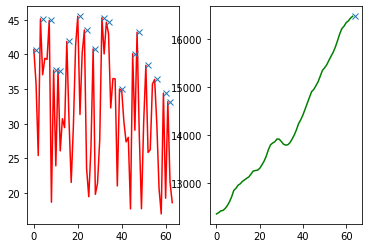

5716
peaked


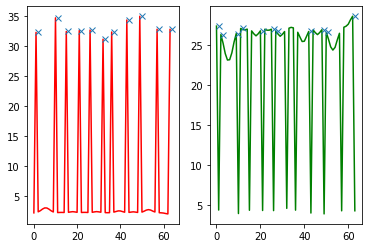

5763
peaked


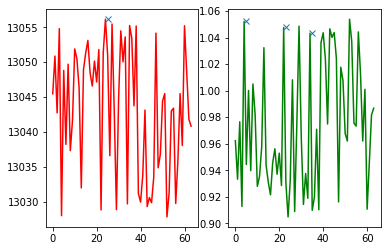

5815
peaked


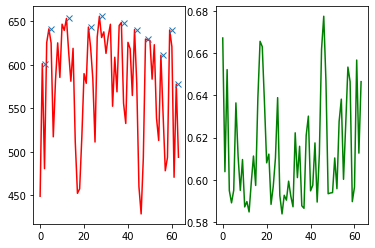

5876
peaked


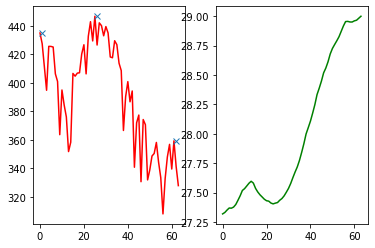

5925
peaked


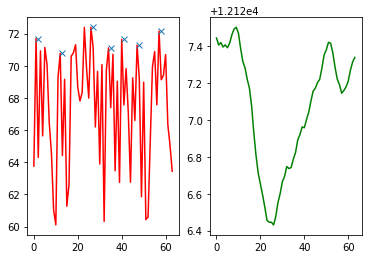

5987
peaked


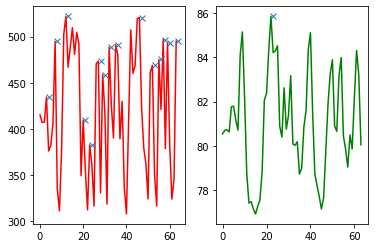

6055
peaked


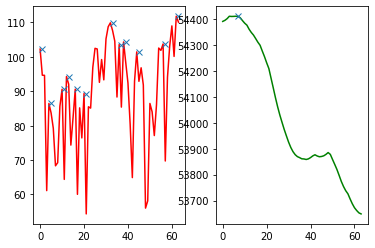

6137
peaked


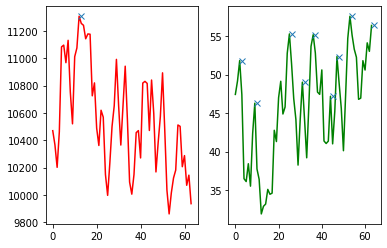

6144
peaked


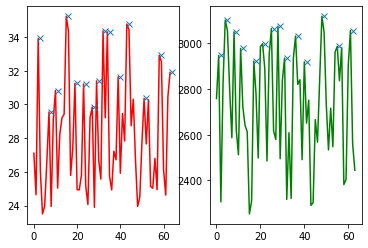

6205
peaked


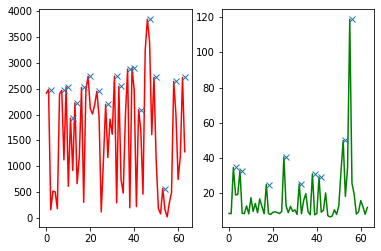

6240
peaked


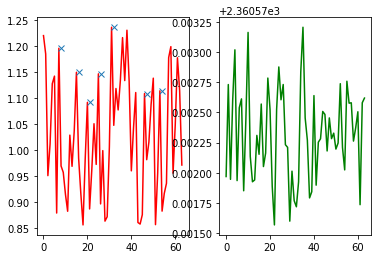

6333
peaked


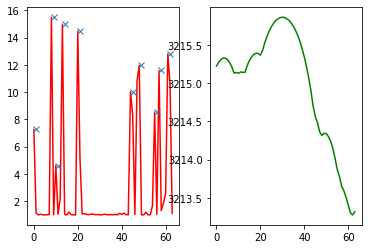

6389
peaked


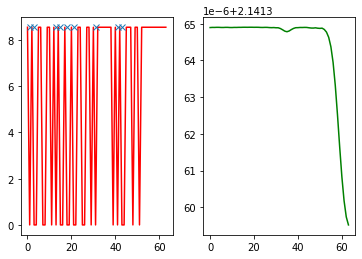

6415
peaked


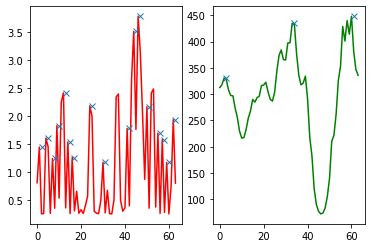

6434
peaked


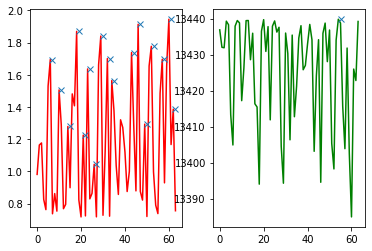

6557
peaked


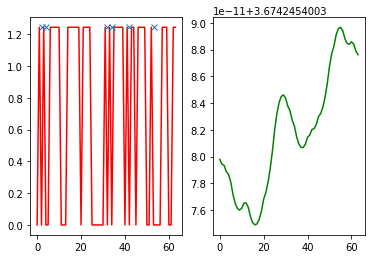

6569
peaked


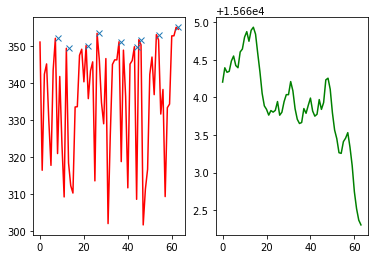

6607
peaked


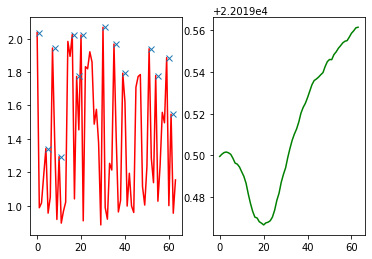

6629
peaked


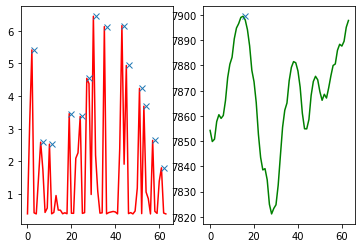

6660
peaked


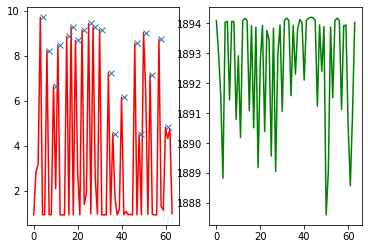

6667
peaked


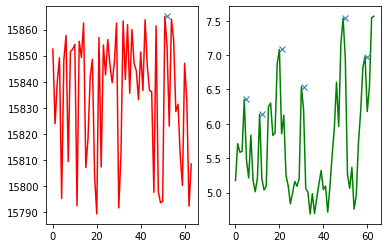

6748
peaked


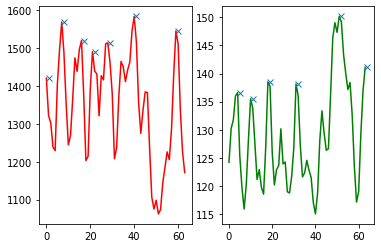

6760
peaked


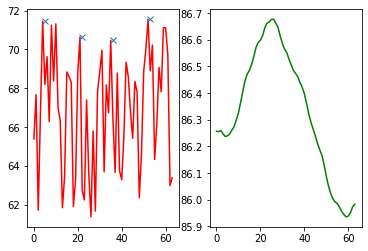

6825
peaked


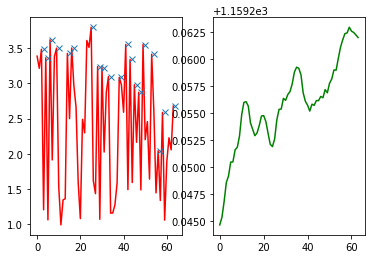

6873
peaked


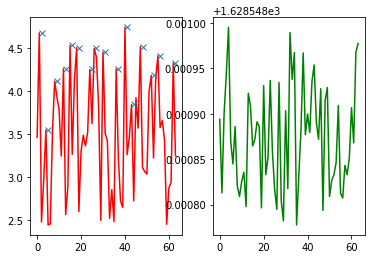

6960
peaked


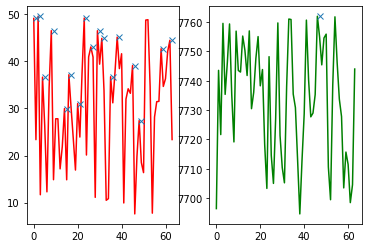

7003
peaked


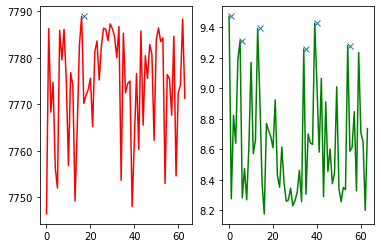

7029
peaked


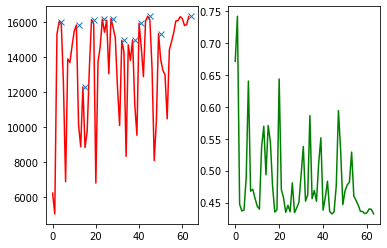

7124
peaked


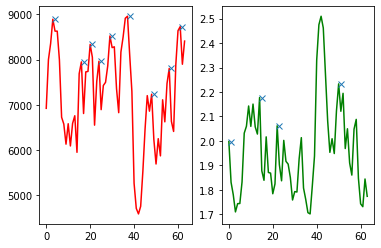

7137
peaked


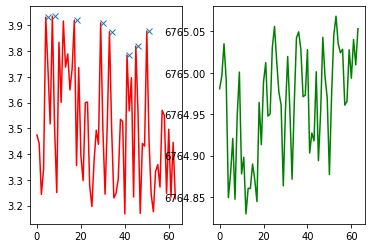

7160
peaked


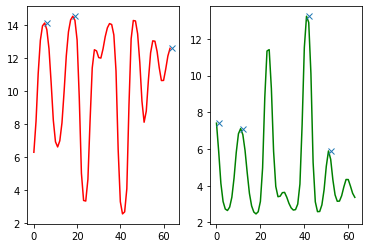

7178
peaked


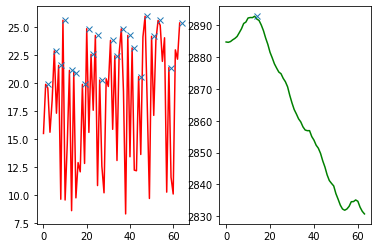

7237
peaked


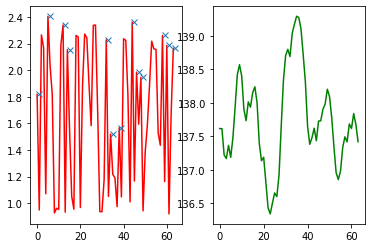

7243
peaked


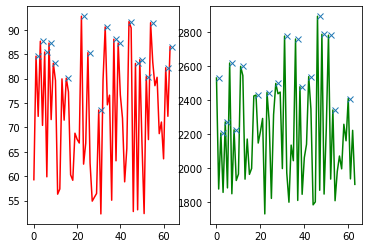

7331
peaked


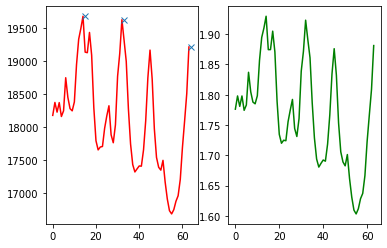

7335
peaked


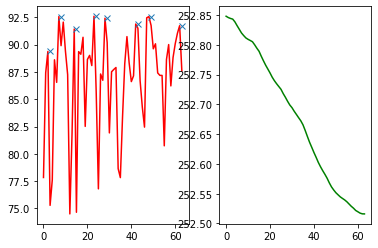

7388
peaked


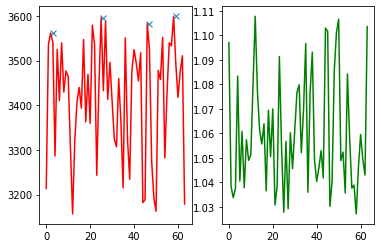

7399
peaked


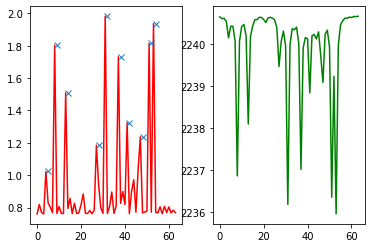

7451
peaked


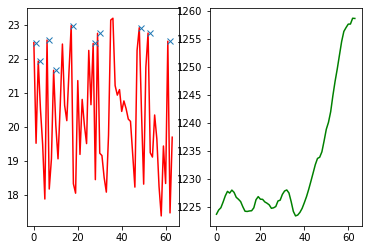

7475
peaked


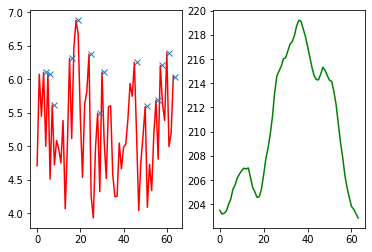

7481
peaked


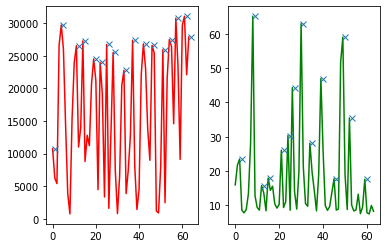

7512
peaked


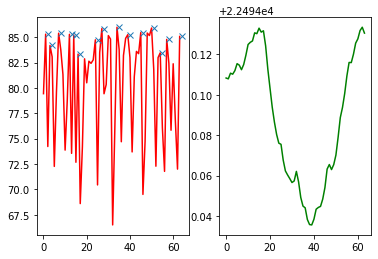

7612
peaked


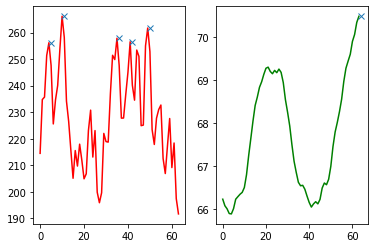

7625
peaked


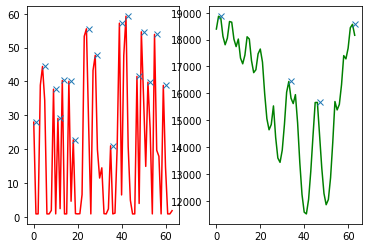

7650
peaked


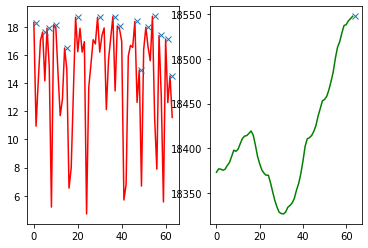

7672
peaked


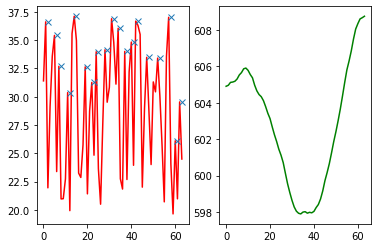

7677
peaked


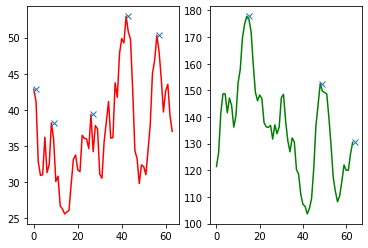

7680
peaked


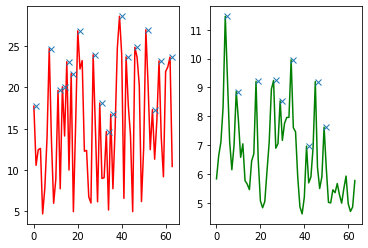

7703
peaked


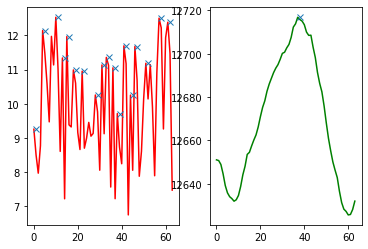

7706
peaked


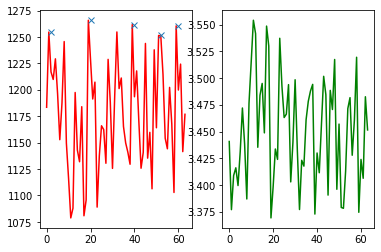

7759
peaked


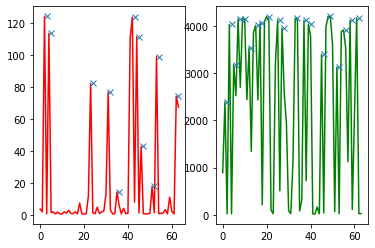

7911
peaked


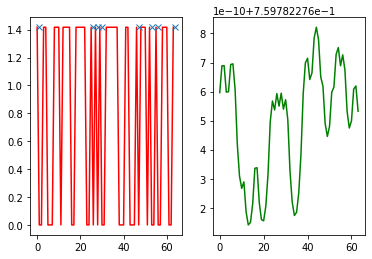

7915
peaked


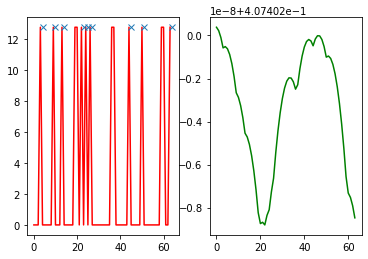

7916
peaked


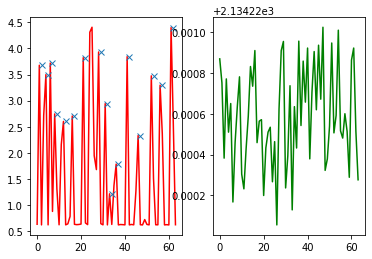

7925
peaked


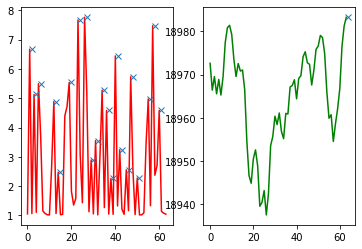

7977
peaked


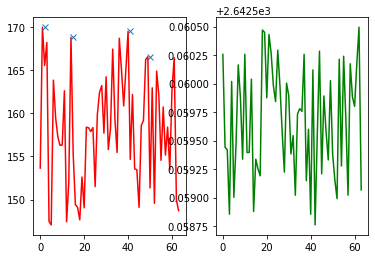

7988
peaked


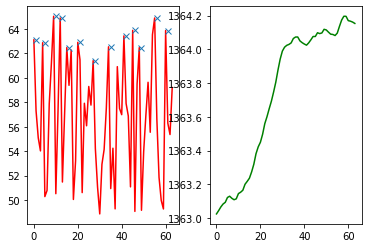

8044
peaked


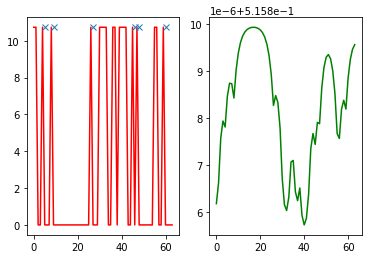

8065
peaked


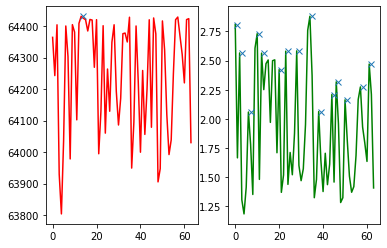

8126
peaked


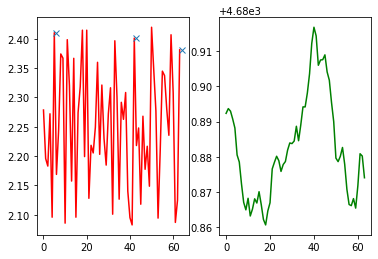

8127
peaked


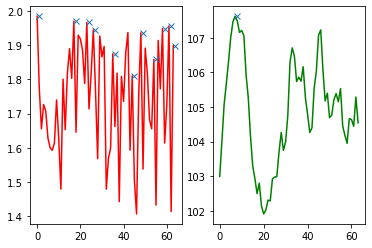

8232
peaked


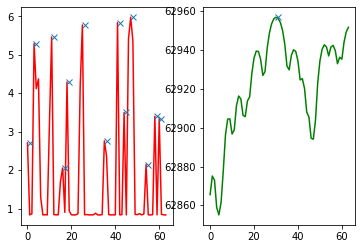

8269
peaked


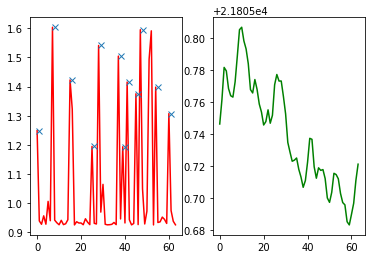

8290
peaked


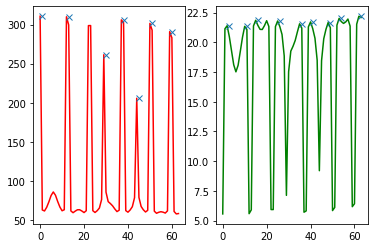

8307
peaked


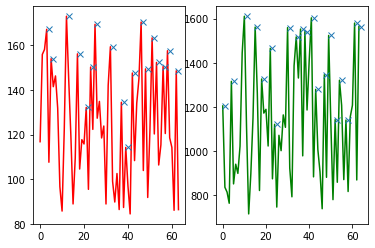

8310
peaked


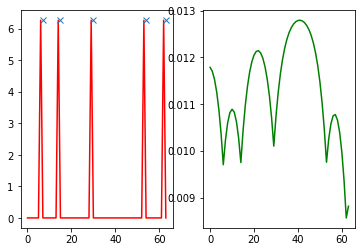

8326
peaked


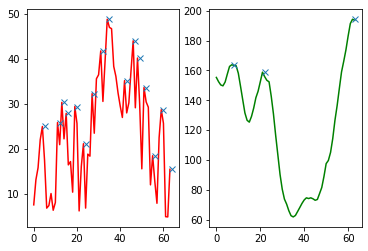

8353
peaked


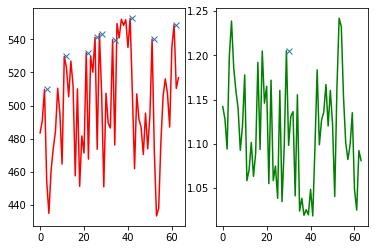

8354
peaked


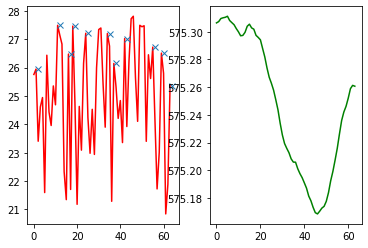

8361
peaked


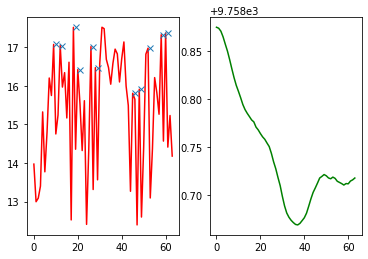

8416
peaked


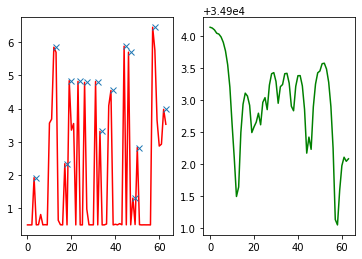

8468
peaked


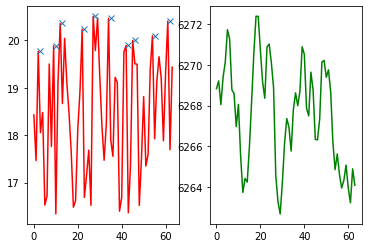

8483
peaked


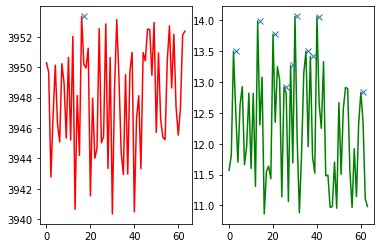

8497
peaked


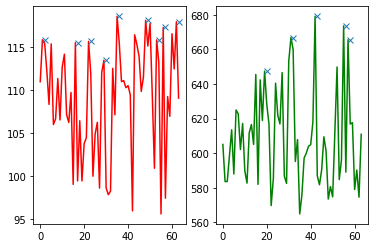

8507
peaked


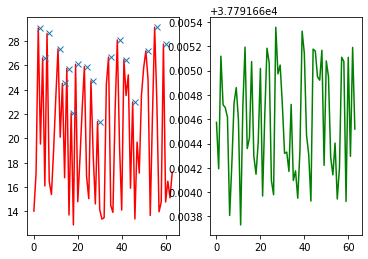

8558
peaked


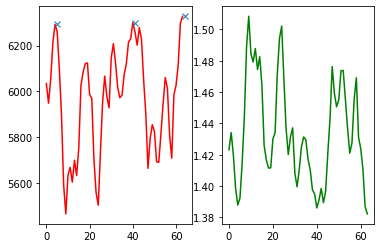

8569
peaked


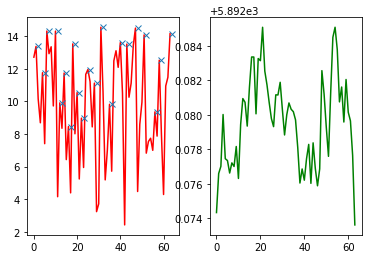

8583
peaked


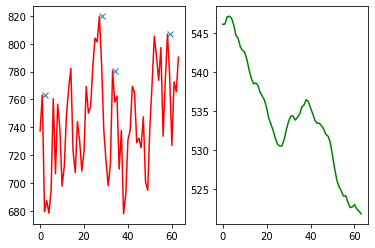

8616
peaked


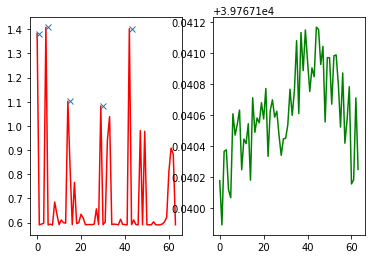

8720
peaked


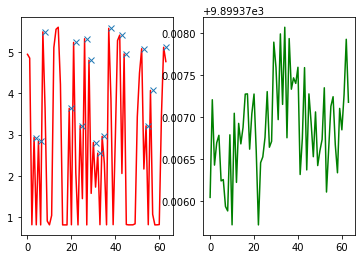

8737
peaked


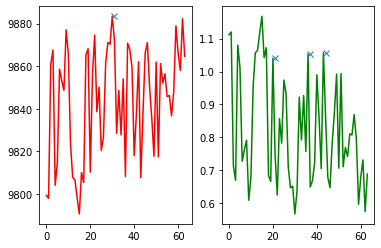

8743
peaked


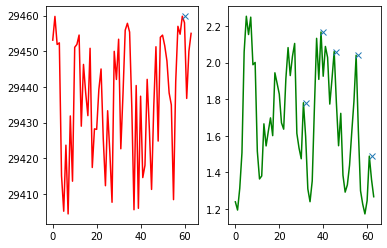

8758
peaked


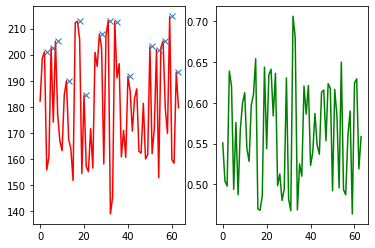

8777
peaked


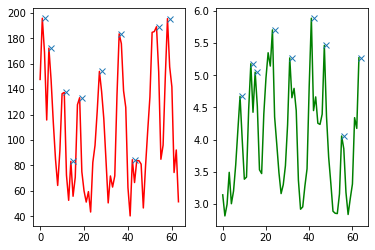

8781
peaked


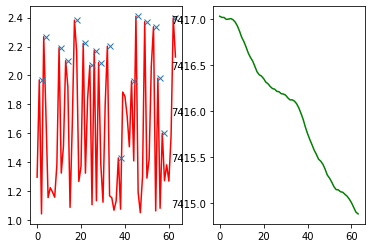

8827
peaked


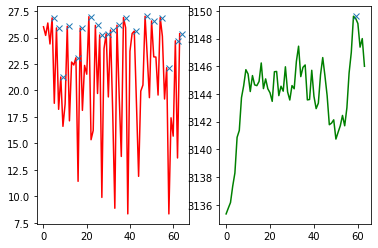

8940
peaked


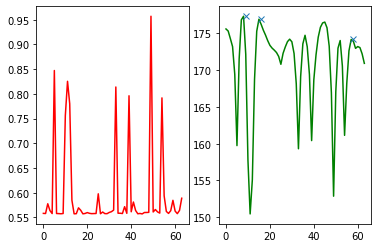

8956
peaked


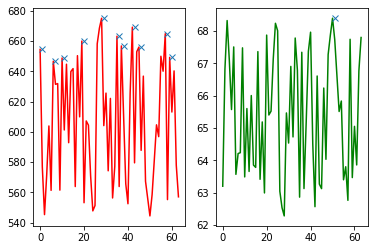

9001
peaked


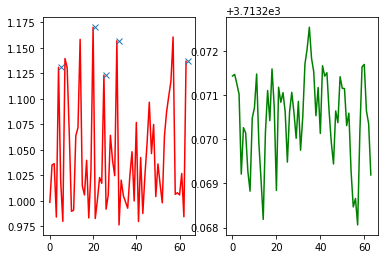

9163
peaked


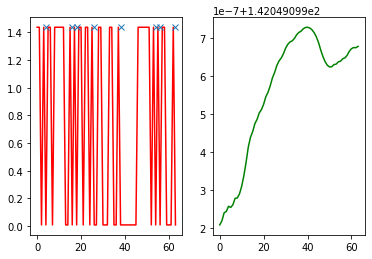

9188
peaked


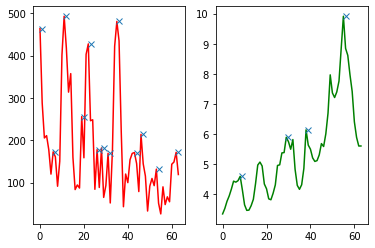

9189
peaked


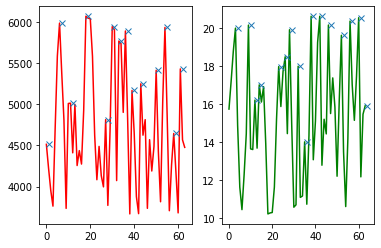

9223
peaked


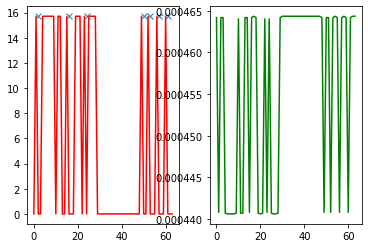

9224
peaked


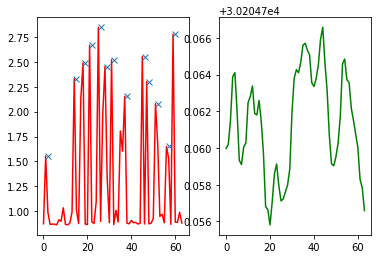

9238
peaked


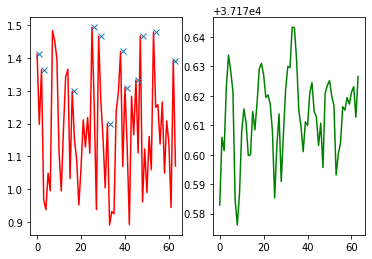

9242
peaked


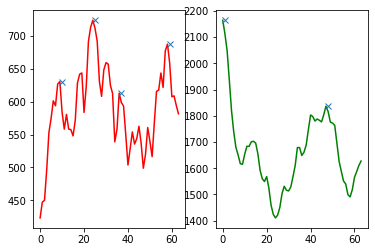

9266
peaked


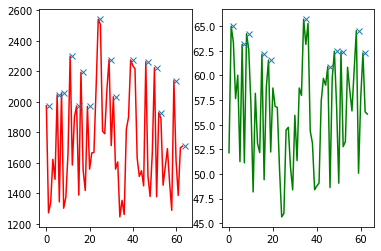

9284
peaked


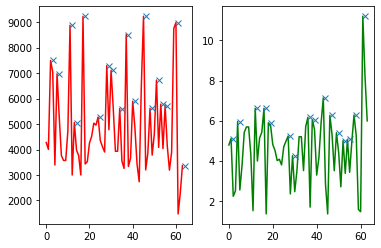

9289
peaked


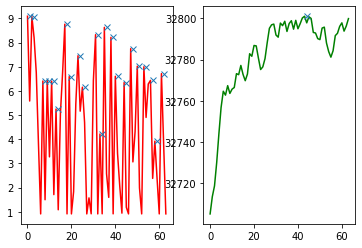

9348
peaked


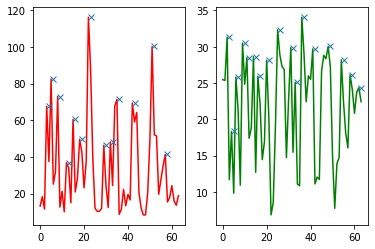

9357
peaked


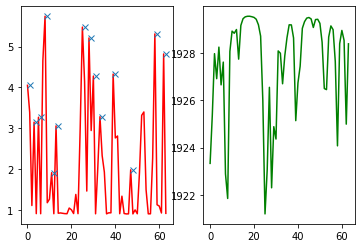

9364
peaked


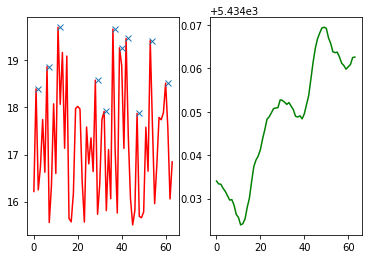

9462
peaked


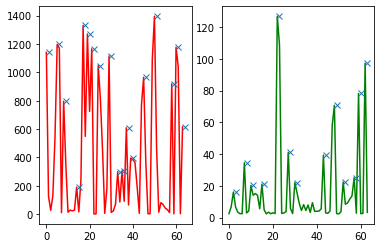

9477
peaked


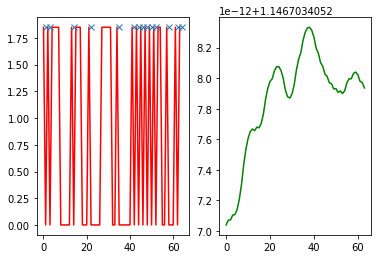

9499
peaked


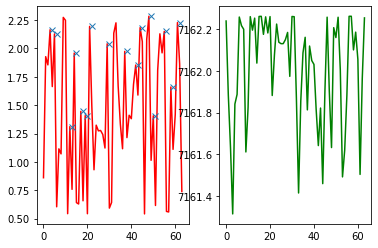

9503
peaked


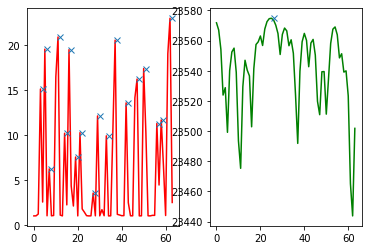

9505
peaked


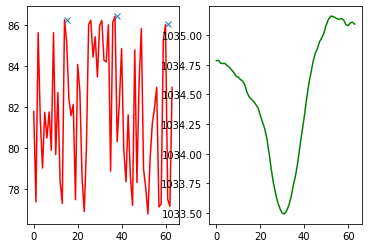

9513
peaked


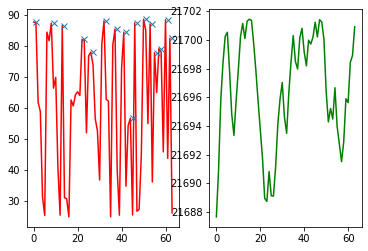

9541
peaked


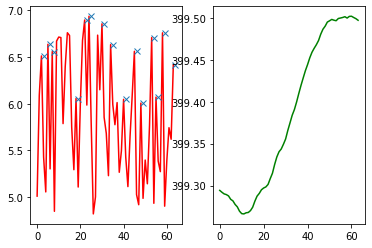

9563
peaked


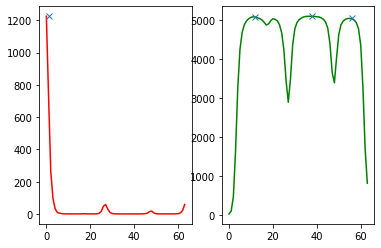

9653
peaked


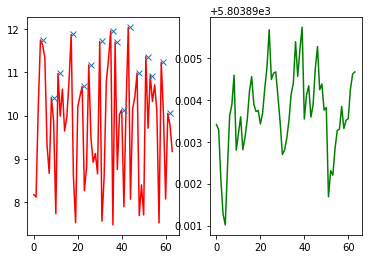

9657
peaked


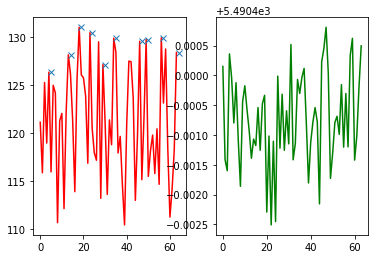

9660
peaked


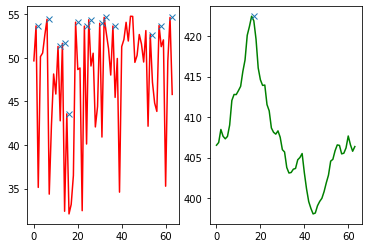

9661
peaked


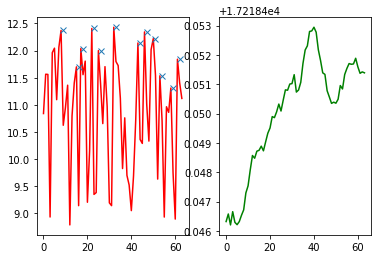

9693
peaked


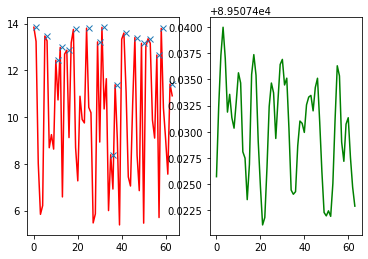

9752
peaked


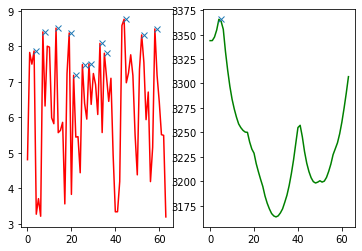

9836
peaked


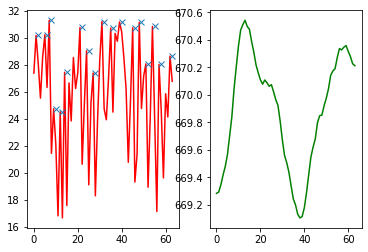

9843
peaked


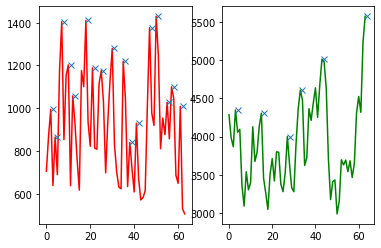

9885
peaked


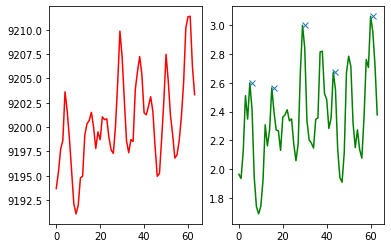

9941
peaked


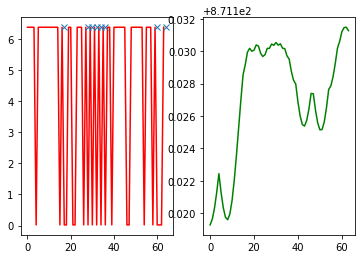

9946
peaked


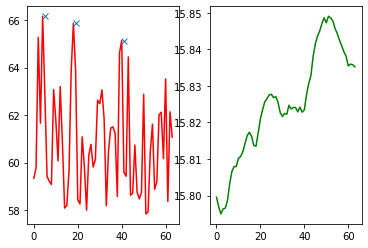

9968
peaked


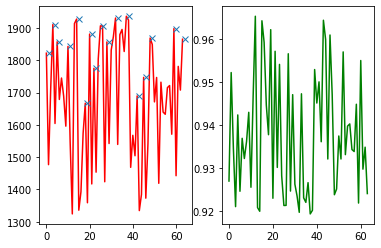

9979
peaked


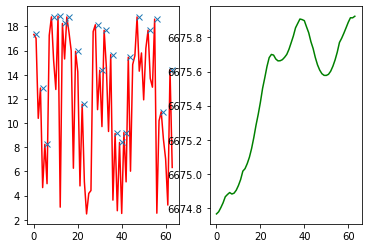

9996
peaked


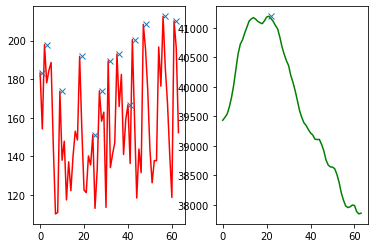

In [13]:
# stripped_parID = []
# nonstripped_parID = []
    
for parID in stripped_parID:
    filename = 'final_circuit%r_variant%r_boundary%r_%s_%sID%r_L%r_J%r_T%r_N%r'%(circuit_n,variant,boundary_coef, shape,mechanism,parID,L,J,T,N)
    simulation = pickle.load( open( modelling_ephemeral + '/3954/numerical_confocal/results/simulation/1M_df_fullcircuit/1D%s.pkl'%filename, "rb" ) ) 
    peaks_n = plot_peaks(simulation,parID,print_stripped=True)
#     if np.amax(peaks_n) > 2:
#         stripped_parID.append(parID)
#     else:
#         nonstripped_parID.append(parID)

In [25]:
pickle.dump( nonstripped_parID, open( "%s_boundary%r_nonstripped_parID_10000.pkl"%(shape,boundary_coef), "wb" ) )
pickle.dump( stripped_parID, open( "%s_boundary%r_stripped_parID_10000.pkl"%(shape,boundary_coef), "wb" ) )



# Quantifying mechanisms


In [79]:
# general_df.to_pickle(modelling_hpc + '/3954/parameter_space_search/results/output_dataframes/lsa_df_circuit%r_variant%r_%rparametersets.pkl'%(circuit_n,variant,parametersets_n))

TimeoutError: [Errno 60] Operation timed out: '/Volumes/mo2016/home/Documents/modelling/3954/numerical_confocal/code/stripes/full_circuit'

In [3]:
general_df_multiindex= pickle.load(open(modelling_hpc + '/3954/parameter_space_search/results/output_dataframes/lsa_df_circuit%r_variant%r_%rparametersets.pkl'%(circuit_n,variant,parametersets_n), "rb"))

general_df = general_df_multiindex.xs(0,level=1)

general_df

,ba,bb,bc,bd,be,bf,Va,Vb,Vc,Vd,...,oscillations,k0_eig,turing_type,ss_stability,ss_type,stripes,no_growth_1,no_growth_0,growth_1,growth_0
1,0.01,0.01,0.01,0.01,0.01,0.01,346.393239,19.770732,53.098595,280.177354,...,1.0,"[(-1.588488886483666+0j), (-0.5373828209022375...",NaN,Stable,Stable point,non striped,False,False,False,False
2,0.01,0.01,0.01,0.01,0.01,0.01,81.676624,58.969575,494.302517,119.481025,...,NaN,"[(-0.1827376877497169-0.07451990977868735j), (...",NaN,Unstable,Saddle point,non striped,False,False,False,False
3,0.01,0.01,0.01,0.01,0.01,0.01,10.355239,952.874387,55.254409,22.496286,...,1.0,"[-5.097716201690709, -4.252029200198846, -0.05...",NaN,Stable,Stable point,non striped,False,False,False,False
4,0.01,0.01,0.01,0.01,0.01,0.01,283.284460,25.842650,27.056754,14.812807,...,1.0,"[(-0.0247742627549326+0j), (-0.023344767431917...",NaN,Stable,Stable spiral,non striped,False,False,False,False
5,0.01,0.01,0.01,0.01,0.01,0.01,23.141913,122.811899,23.437384,911.460740,...,1.0,"[(-63.38049263516152+0j), (-13.039988293732883...",NaN,Stable,Stable spiral,non striped,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9996,0.01,0.01,0.01,0.01,0.01,0.01,17.209057,29.464220,647.430403,49.381620,...,1.0,"[(-0.00898363274894649+0j), (-0.00898188963216...",NaN,Stable,Stable spiral,non striped,False,True,False,False
9997,0.01,0.01,0.01,0.01,0.01,0.01,234.605627,55.125924,10.692000,11.721320,...,1.0,[(-0.30966051656011134-3.094232980100553e-09j)...,NaN,Stable,Stable spiral,non striped,False,False,False,False
9998,0.01,0.01,0.01,0.01,0.01,0.01,143.439033,54.922349,27.061938,77.415862,...,1.0,"[(-1.4292880315297003+0j), (-0.188412312185913...",NaN,Stable,Stable point,non striped,False,False,False,False
9999,0.01,0.01,0.01,0.01,0.01,0.01,536.376271,109.130153,147.531305,27.846166,...,0.0,"[-0.06738190538552774, -0.06618821060087002, -...",NaN,Stable,Stable point,non striped,False,False,False,False


9996
peaked


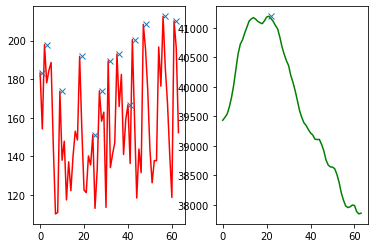

In [40]:
boundary_coef=0
shape='no_growth'
mechanism = 'general'
L,T,J,N = [8,100,64,12600]


for parID in [9996]:
    filename = 'final_circuit%r_variant%r_boundary%r_%s_%sID%r_L%r_J%r_T%r_N%r'%(circuit_n,variant,boundary_coef, shape,mechanism,parID,L,J,T,N)
    simulation = pickle.load( open( modelling_ephemeral + '/3954/numerical_confocal/results/simulation/1M_df_fullcircuit/1D%s.pkl'%filename, "rb" ) ) 
    peaks_n = plot_peaks(simulation,parID,print_stripped=True)

## Turing

In [4]:
turing = general_df_multiindex[general_df_multiindex['turing_type'].notna()]
turing_pattern = turing[(turing['growth_1']==True) | (turing['growth_0']==True) | (turing['no_growth_1']==True) | (turing['no_growth_0']==True)]
turing_pattern = turing_pattern.xs(0,level=1)



In [5]:
non_turing_pattern = general_df[~general_df.index.isin(turing_pattern.index)]


## Noise amplifier

In [6]:
noise_amplifier = non_turing_pattern[non_turing_pattern["no_growth_0"]==True]
noise_amplifier


,ba,bb,bc,bd,be,bf,Va,Vb,Vc,Vd,...,oscillations,k0_eig,turing_type,ss_stability,ss_type,stripes,no_growth_1,no_growth_0,growth_1,growth_0
26,0.01,0.01,0.01,0.01,0.01,0.01,42.387337,107.277330,496.576131,25.011079,...,1.0,"[(-0.628528767149743+0j), (-0.5821272786848242...",NaN,Stable,Stable spiral,striped,True,True,True,True
108,0.01,0.01,0.01,0.01,0.01,0.01,30.095295,46.125616,452.524280,378.598804,...,1.0,"[(-3.674884903890873+0j), (-3.3769432038122296...",NaN,Stable,Stable point,non striped,True,True,False,False
119,0.01,0.01,0.01,0.01,0.01,0.01,601.250131,111.201123,751.060889,28.165902,...,1.0,"[-0.05847861413485121, -0.05762914158696835, -...",NaN,Stable,Stable point,non striped,True,True,False,False
127,0.01,0.01,0.01,0.01,0.01,0.01,20.907722,476.381217,311.720918,11.811413,...,1.0,"[(-19.11765534518238+0j), (-19.117216888970745...",NaN,Stable,Stable spiral,striped,True,True,True,True
158,0.01,0.01,0.01,0.01,0.01,0.01,227.487058,339.146182,43.388423,531.127782,...,1.0,"[-0.28889360451441554, -0.2888504961251532, -0...",NaN,Stable,Stable point,non striped,True,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9941,0.01,0.01,0.01,0.01,0.01,0.01,882.791164,39.159063,297.733589,93.210605,...,1.0,[(-0.5630253099181289-1.1179878896414148e-10j)...,NaN,Stable,Stable spiral,non striped,False,True,False,False
9946,0.01,0.01,0.01,0.01,0.01,0.01,305.896277,10.964864,120.536987,44.790795,...,1.0,"[(-0.8151593981863214+0j), (-0.815153226791933...",NaN,Stable,Stable spiral,non striped,False,True,False,False
9968,0.01,0.01,0.01,0.01,0.01,0.01,14.138617,12.898427,121.728088,107.907164,...,1.0,"[(-5.831364753913964+0j), (-5.830014162410707+...",NaN,Stable,Stable spiral,non striped,True,True,False,False
9979,0.01,0.01,0.01,0.01,0.01,0.01,109.920338,394.981093,141.911938,53.455499,...,0.0,"[-0.6070319662722607, -0.48455761282503007, -0...",NaN,Stable,Stable point,non striped,True,True,False,False


## Boundary induced patterns

In [7]:
non_noise_amplifier = non_turing_pattern[non_turing_pattern["no_growth_0"]==False]
boundary_pattern = non_noise_amplifier[non_noise_amplifier['no_growth_1']==True]
boundary_pattern

,ba,bb,bc,bd,be,bf,Va,Vb,Vc,Vd,...,oscillations,k0_eig,turing_type,ss_stability,ss_type,stripes,no_growth_1,no_growth_0,growth_1,growth_0
212,0.01,0.01,0.01,0.01,0.01,0.01,342.723280,619.824295,29.096253,22.341955,...,1.0,"[(-33.59668689462771+0j), (-33.596686893891274...",NaN,Stable,Stable point,non striped,True,False,False,False
1168,0.01,0.01,0.01,0.01,0.01,0.01,714.564226,368.719569,307.788261,279.943617,...,1.0,"[(-2.2865681035713057+0j), (-2.281982165557992...",NaN,Stable,Stable spiral,non striped,True,False,False,False
2390,0.01,0.01,0.01,0.01,0.01,0.01,16.518617,50.009042,83.173673,515.945137,...,NaN,"[-1.075796034758822, -0.717627981112678, -0.22...",NaN,Unstable,Saddle point,non striped,True,False,False,False
3539,0.01,0.01,0.01,0.01,0.01,0.01,16.601887,13.167689,210.551578,35.923569,...,1.0,"[(-5.157634706345604+0j), (-5.157396424499413+...",NaN,Stable,Stable spiral,striped,True,False,False,False
4725,0.01,0.01,0.01,0.01,0.01,0.01,10.339119,482.130645,821.651236,92.901087,...,1.0,"[(-37.94782167240295+0j), (-37.94770315396349-...",NaN,Stable,Stable spiral,non striped,True,False,False,False
6176,0.01,0.01,0.01,0.01,0.01,0.01,29.024187,26.647388,395.848350,777.396646,...,1.0,[(-22.223608515304093-1.8219690112328537e-08j)...,NaN,Stable,Stable spiral,non striped,True,False,False,False
6774,0.01,0.01,0.01,0.01,0.01,0.01,15.169429,202.449497,50.345567,322.576870,...,1.0,"[(-2.332002225314362+0j), (-2.323987789047596+...",NaN,Stable,Stable spiral,non striped,True,False,False,False
7446,0.01,0.01,0.01,0.01,0.01,0.01,28.408287,445.359161,237.198657,91.741160,...,1.0,"[(-2.766218736643666+0j), (-2.7654529313215654...",NaN,Stable,Stable spiral,non striped,True,False,False,False
9493,0.01,0.01,0.01,0.01,0.01,0.01,18.164220,346.242240,48.372830,423.437313,...,0.0,"[-13.988252776164982, -13.688234870146074, -0....",NaN,Stable,Stable point,striped,True,False,False,False
9577,0.01,0.01,0.01,0.01,0.01,0.01,523.101243,34.680578,11.104987,583.749210,...,1.0,"[(-21.940173612036528+0j), (-21.90127498135213...",NaN,Stable,Stable spiral,non striped,True,False,False,False


## Growth induced patterns

In [8]:
non_noise_amplifier = non_turing_pattern[non_turing_pattern["no_growth_0"]==False]
non_boundary_pattern = non_noise_amplifier[non_noise_amplifier['no_growth_1']==False]
growth_pattern = non_boundary_pattern[non_boundary_pattern['growth_1']==True]
growth_pattern

,ba,bb,bc,bd,be,bf,Va,Vb,Vc,Vd,...,oscillations,k0_eig,turing_type,ss_stability,ss_type,stripes,no_growth_1,no_growth_0,growth_1,growth_0
27,0.01,0.01,0.01,0.01,0.01,0.01,14.522876,48.632498,90.959263,549.417308,...,1.0,"[(-0.010852345714001111+0j), (-0.0108523457139...",NaN,Stable,Stable spiral,striped,False,False,True,True
167,0.01,0.01,0.01,0.01,0.01,0.01,196.926844,235.830005,141.853097,139.765262,...,1.0,"[(-3.1158352754521355+0j), (-2.739018135386684...",NaN,Stable,Stable spiral,striped,False,False,True,True
189,0.01,0.01,0.01,0.01,0.01,0.01,11.167984,52.367060,522.431710,513.894909,...,1.0,[(-0.002079365209820613-7.275108380073502e-08j...,NaN,Stable,Stable spiral,striped,False,False,True,True
217,0.01,0.01,0.01,0.01,0.01,0.01,821.593378,196.367020,10.190042,14.017577,...,0.0,"[-4.710664569928676, -4.709816037450582, -0.43...",NaN,Stable,Stable point,striped,False,False,True,True
331,0.01,0.01,0.01,0.01,0.01,0.01,70.536289,187.180480,344.185740,312.706028,...,1.0,"[(-7.308539404526181+0j), (-7.277132828204361+...",NaN,Stable,Stable spiral,striped,False,False,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9888,0.01,0.01,0.01,0.01,0.01,0.01,420.847972,18.696303,63.506647,736.861587,...,1.0,"[(-9.79614847710044+0j), (-9.791214158899406+0...",NaN,Stable,Stable spiral,striped,False,False,True,True
9921,0.01,0.01,0.01,0.01,0.01,0.01,18.729557,21.971912,43.903725,71.118750,...,1.0,"[(-0.8393789100814207+0j), (-0.839378185656202...",NaN,Stable,Stable spiral,striped,False,False,True,True
9948,0.01,0.01,0.01,0.01,0.01,0.01,587.721045,26.512139,18.160967,50.322764,...,0.0,"[-11.070095836197824, -11.069907859095059, -0....",NaN,Stable,Stable point,striped,False,False,True,True
9951,0.01,0.01,0.01,0.01,0.01,0.01,13.339451,10.252173,918.212436,163.263933,...,1.0,"[(-0.13687264435844784+0j), (-0.13687198153115...",NaN,Stable,Stable spiral,striped,False,False,True,True


In [ ]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(df)

In [74]:
print(len(turing_pattern) ,len(noise_amplifier),len(boundary_pattern),len(growth_pattern))



16 292 10 130


## Summary stats

In [61]:
import matplotlib.pyplot as plt
import numpy as np
from decimal import *
import matplotlib as mpl
mpl.rcParams['font.size'] = 15

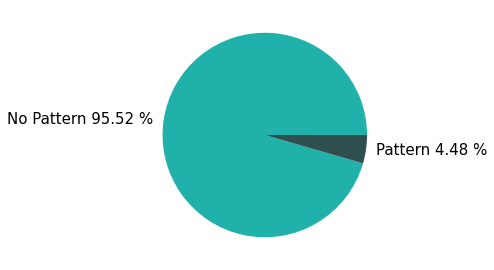

In [62]:
total = 10000

pattern = len(turing_pattern) + len(noise_amplifier)+len(boundary_pattern)+len(growth_pattern)
no_pattern = int(total-pattern)
y = np.array([no_pattern,pattern])
mylabels = ["No Pattern %.2f %%"%(no_pattern/total*100), 'Pattern %.2f %%'%(pattern/total*100)]
mycolors = ['lightseagreen','darkslategrey']
plt.pie(y, labels = mylabels,colors = mycolors)
plt.tight_layout()
# plt.savefig('10000_fullcircuit_piechart_patterns.png',bbox_inches='tight')
plt.show()



In [4]:
total = 10000
import matplotlib.pyplot as plt
import numpy as np
y = np.array([99.61,0.39])
mylabels = ['No turing pattern 99.61% ', 'Turing pattern 0.39%']
mycolors = ['lightseagreen','darkslategrey']
plt.pie(y, labels = mylabels,colors = mycolors)
plt.tight_layout()
plt.savefig('/Users/mo2016/Documents/powerpoint_results/diagrams icons/cir2_turingrobustness.png',bbox_inches='tight')
plt.show()

TypeError: pie() got an unexpected keyword argument 'fontsize'

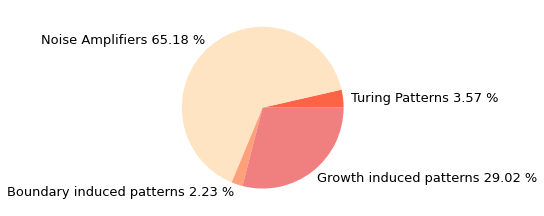

In [63]:
mpl.rcParams['font.size'] = 13
y = np.array([len(turing_pattern),len(noise_amplifier),len(boundary_pattern),len(growth_pattern)])
percentages = (y/pattern)*100
mylabels = ['Turing Patterns %.2f %%'%percentages[0], 'Noise Amplifiers %.2f %%'%percentages[1], 'Boundary induced patterns %.2f %%'%percentages[2],'Growth induced patterns %.2f %%'%percentages[3]]
mycolors = ['tomato','bisque','lightsalmon','lightcoral']
plt.pie(y, labels = mylabels,colors = mycolors)
plt.tight_layout()
plt.savefig('10000_fullcircuit_piechart_mechanisms.png',bbox_inches='tight')
plt.show()


hello


In [75]:
def define_mechanism_column(row,turing_pattern,noise_amplifier,boundary_pattern,growth_pattern):
    parID = row.name[0]
    if parID in turing_pattern.index:
        return 'Turing pattern'
    
    elif parID in noise_amplifier.index:
        return 'Noise amplifier'

    elif parID in boundary_pattern.index:
        return 'Boundary pattern'
    
    elif parID in growth_pattern.index:
        return 'Growth pattern'
    
    else: 
        return 'No pattern'
    


In [78]:
general_df_multiindex['mechanism'] = general_df_multiindex.apply (lambda row: define_mechanism_column(row,turing_pattern,noise_amplifier,boundary_pattern,growth_pattern), axis=1)

general_df_multiindex

ba    bb    bc    bd    be    bf          Va          Vb  \
1     0  0.01  0.01  0.01  0.01  0.01  0.01  346.393239   19.770732   
      1  0.01  0.01  0.01  0.01  0.01  0.01  346.393239   19.770732   
      2  0.01  0.01  0.01  0.01  0.01  0.01  346.393239   19.770732   
2     0  0.01  0.01  0.01  0.01  0.01  0.01   81.676624   58.969575   
      1  0.01  0.01  0.01  0.01  0.01  0.01   81.676624   58.969575   
...       ...   ...   ...   ...   ...   ...         ...         ...   
9996  0  0.01  0.01  0.01  0.01  0.01  0.01   17.209057   29.464220   
9997  0  0.01  0.01  0.01  0.01  0.01  0.01  234.605627   55.125924   
9998  0  0.01  0.01  0.01  0.01  0.01  0.01  143.439033   54.922349   
9999  0  0.01  0.01  0.01  0.01  0.01  0.01  536.376271  109.130153   
10000 0  0.01  0.01  0.01  0.01  0.01  0.01   17.453604   20.884779   

                 Vc          Vd  ...  \
1     0   53.098595  280.177354  ...   
      1   53.098595  280.177354  ...   
      2   53.098595  280.177354  ...   
2     0  494.302517  119.481025  ...   
      1  494.302517  119.481025  ...   
...             ...         ...  ...   
9996  0  647.430403   49.381620  ...   
9997  0   10.692000   11.721320  ...   
9998  0   27.061938   77.415862  ...   
9999  0  147.531305   27.846166  ...   
10000 0  265.925853   46.418034  ...   

                                                    k0_eig  turing_type  \
1     0  [(-1.588488886483666+0j), (-0.5373828209022375...          NaN   
      1  [-1.1837512777466623, -1.1836901809492537, -0....          NaN   
      2  [(-1.1837512823619+0j), (-1.0757272602039332-0...          NaN   
2     0  [(-0.1827376877497169-0.07451990977868735j), (...          NaN   
      1  [(-0.17160478655474762-0.04226366561944285j), ...          NaN   
...                                                    ...          ...   
9996  0  [(-0.00898363274894649+0j), (-0.00898188963216...          NaN   
9997  0  [(-0.30966051656011134-3.094232980100553e-09j)...          NaN   
9998  0  [(-1.4292880315297003+0j), (-0.188412312185913...          NaN   
9999  0  [-0.06738190538552774, -0.06618821060087002, -...          NaN   
10000 0  [-0.8378048974844199, -0.5015135253996398, -0....          NaN   

         ss_stability        ss_type      stripes  no_growth_1  no_growth_0  \
1     0        Stable   Stable point  non striped        False        False   
      1        Stable   Stable point  non striped        False        False   
      2      Unstable   Saddle point  non striped        False        False   
2     0      Unstable   Saddle point  non striped        False        False   
      1        Stable   Stable point  non striped        False        False   
...               ...            ...          ...          ...          ...   
9996  0        Stable  Stable spiral  non striped        False         True   
9997  0        Stable  Stable spiral  non striped        False        False   
9998  0        Stable   Stable point  non striped        False        False   
9999  0        Stable   Stable point  non striped        False        False   
10000 0        Stable   Stable point  non striped        False        False   

         growth_1  growth_0        mechanism  
1     0     False     False       No pattern  
      1     False     False       No pattern  
      2     False     False       No pattern  
2     0     False     False       No pattern  
      1     False     False       No pattern  
...           ...       ...              ...  
9996  0     False     False  Noise amplifier  
9997  0     False     False       No pattern  
9998  0     False     False       No pattern  
9999  0     False     False       No pattern  
10000 0     False     False       No pattern  

[15521 rows x 39 columns]

In [81]:
general_df_multiindex.loc[217]

,ba,bb,bc,bd,be,bf,Va,Vb,Vc,Vd,...,k0_eig,turing_type,ss_stability,ss_type,stripes,no_growth_1,no_growth_0,growth_1,growth_0,mechanism
0,0.01,0.01,0.01,0.01,0.01,0.01,821.593378,196.36702,10.190042,14.017577,...,"[-4.710664569928676, -4.709816037450582, -0.43...",NaN,Stable,Stable point,striped,False,False,True,True,Growth pattern
